In [1]:
import os
import sys
if os.getenv("ORCA_PATH"):
    ORCA_PATH = os.getenv("ORCA_PATH")
else:
    # change this to the right path if you use a different path
    # or specify the ORCA_PATH environmental variable
    ORCA_PATH = "../orca"
sys.path.append(ORCA_PATH)

In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="3"

In [3]:
import orca_predict
#The default is using GPU. Set use_cuda = False in load_resources to use CPU (slow).
orca_predict.load_resources(models=['32M'])
from orca_predict import *

In <PYTHONPATH>/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The savefig.frameon rcparam was deprecated in Matplotlib 3.1 and will be removed in 3.3.
In <PYTHONPATH>/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The verbose.level rcparam was deprecated in Matplotlib 3.1 and will be removed in 3.3.
In <PYTHONPATH>/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The verbose.fileo rcparam was deprecated in Matplotlib 3.1 and will be removed in 3.3.


In [4]:
mkdir -p ./svs_ins

In [5]:
from Bio.Seq import Seq
from Bio.Alphabet.IUPAC import unambiguous_dna, ambiguous_dna

with open('./resources/psa-mcs-2kb_gb_Supplementary.gb.ins','r') as f:
    seq = f.readline()
    seq = Seq(seq.upper().strip(), unambiguous_dna)
    seq = seq.reverse_complement()

In [6]:
import pandas as pd
sites = pd.read_csv('./resources/psa-mcs-2kb_gb_Supplementary.gb.sites', sep=' ', header=None)

In [7]:
from selene_utils2 import *
target_c21 = Genomic2DFeatures(['./resources/GSE137372_hap1_clone21_mcool_allValidPairs.hic.mcool::/resolutions/25000'],
                      ['r25000'],
                     (40,40),cg=True)

target_wt = Genomic2DFeatures(['./resources/GSE137372_hap1_wt_mcool_allValidPairs.hic.mcool::/resolutions/25000'],
                      ['r25000'],
                     (40,40),cg=True)

target_c25 = Genomic2DFeatures(['./resources/GSE137372_hap1_clone25_mcool_allValidPairs.hic.mcool::/resolutions/25000'],
                      ['r25000'],
                     (40,40),cg=True)

In [8]:
smooth_diag=np.load('./resources/GSE137372_hap1_clone25_mcool_allValidPairs.hic.mcool.expected.res25000.npy')
normmat_c25 = np.exp(smooth_diag[np.abs(np.arange(2000)[None,:]-np.arange(2000)[:,None])])
smooth_diag=np.load('./resources/GSE137372_hap1_clone21_mcool_allValidPairs.hic.mcool.expected.res25000.npy')
normmat_c21 = np.exp(smooth_diag[np.abs(np.arange(2000)[None,:]-np.arange(2000)[:,None])])
smooth_diag=np.load('./resources/GSE137372_hap1_wt_mcool_allValidPairs.hic.mcool.expected.res25000.npy')
normmat_wt = np.exp(smooth_diag[np.abs(np.arange(2000)[None,:]-np.arange(2000)[:,None])])

In [9]:
all_ref_targets = []
all_alt_targets = []
for i in range(10):
    regionlen=1000000
    start = sites[1][i]-int(regionlen/2)
    end = sites[1][i]+int(regionlen/2)
    plotmat1 = target_wt.get_feature_data(sites[0][i].replace('chr',''),start, end+50000)[:-2,:-2]
    all_ref_targets.append(np.log((plotmat1+1*np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))/
              (normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]+1*np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))))

    plotmat2 = target_c21.get_feature_data(sites[0][i].replace('chr',''), start, end+50000)[:-2,:-2]
    all_alt_targets.append(np.log((plotmat2+1*np.min(normmat_c21[:plotmat2.shape[0],:plotmat2.shape[0]]))/
                      (normmat_c21[:plotmat2.shape[0],:plotmat2.shape[0]]+1*np.min(normmat_c21[:plotmat2.shape[0],:plotmat2.shape[0]]))))

for i in range(10,16):
    regionlen=1000000
    start = sites[1][i]-int(regionlen/2)
    end = sites[1][i]+int(regionlen/2) 

    plotmat1 = target_wt.get_feature_data(sites[0][i].replace('chr',''),start, end+50000)[:-2,:-2]
    all_ref_targets.append(np.log((plotmat1+1*np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))/
              (normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]+1*np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))))

    plotmat2 = target_c25.get_feature_data(sites[0][i].replace('chr',''), start, end+50000)[:-2,:-2]
    all_alt_targets.append(np.log((plotmat2+1*np.min(normmat_c25[:plotmat2.shape[0],:plotmat2.shape[0]]))/
                      (normmat_c25[:plotmat2.shape[0],:plotmat2.shape[0]]+1*np.min(normmat_c25[:plotmat2.shape[0],:plotmat2.shape[0]]))))


<PYTHONPATH>/lib/python3.7/site-packages/cooltools/lib/numutils.py:1317: RuntimeWarning: invalid value encountered in true_divide
  val_cur = ar_cur / armask_cur


In [10]:
from selene_sdk.sequences import Genome
hg19 = Genome('./resources/Homo_sapiens.GRCh37.75.dna.primary_assembly.fa')

<PYTHONPATH>/lib/python3.7/site-packages/torch/nn/functional.py:3063: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.647874355316162
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotti

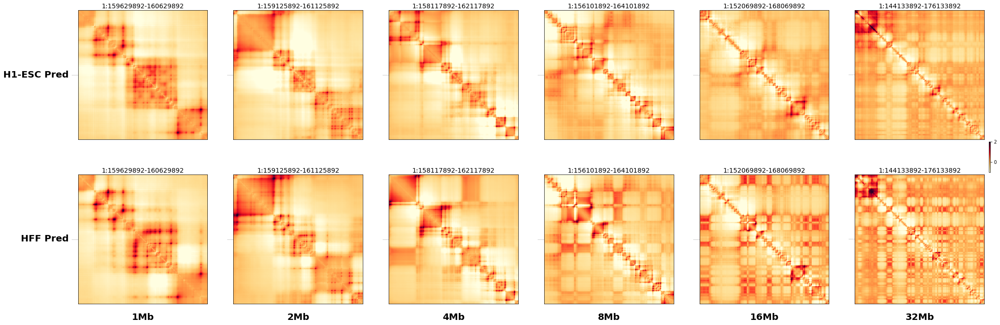

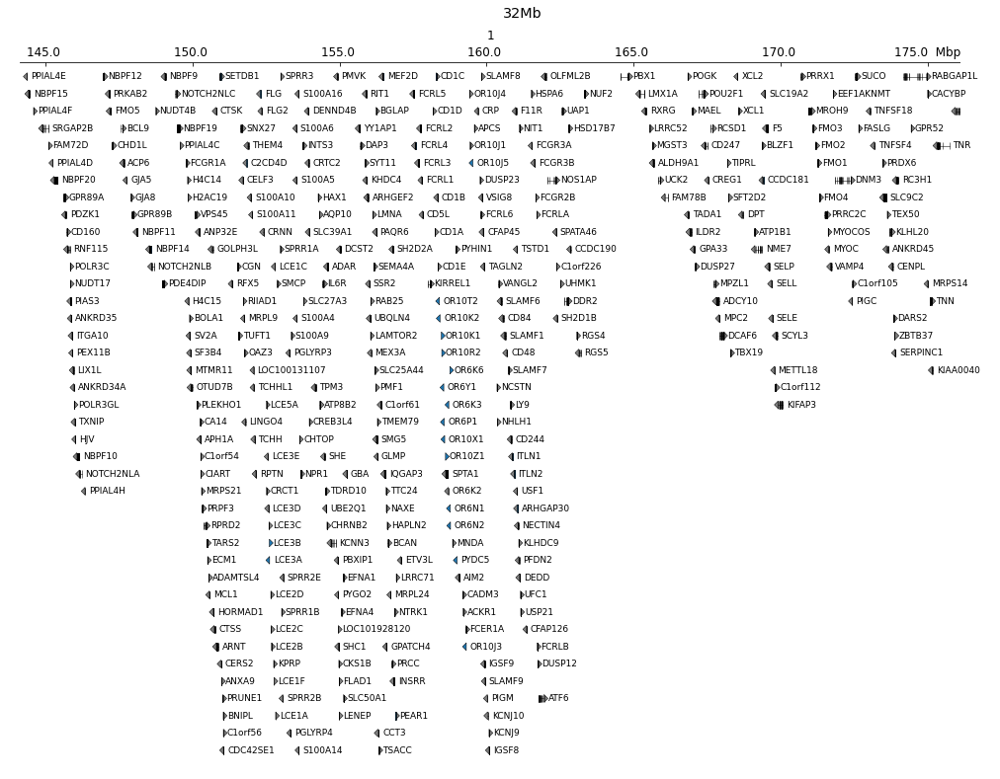

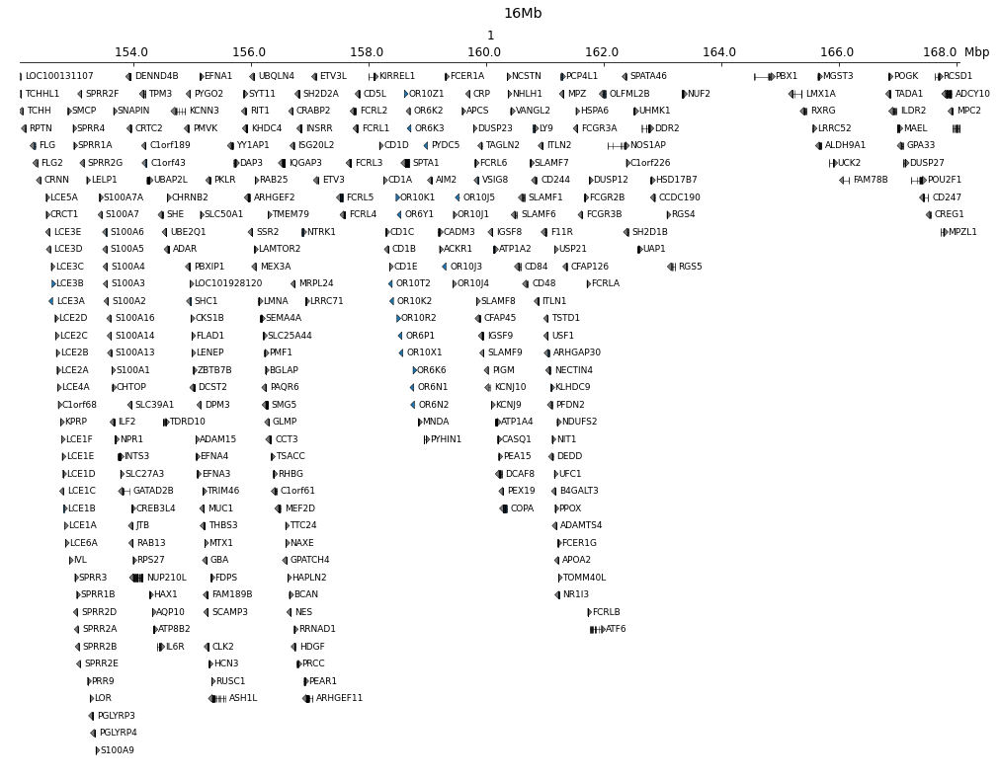

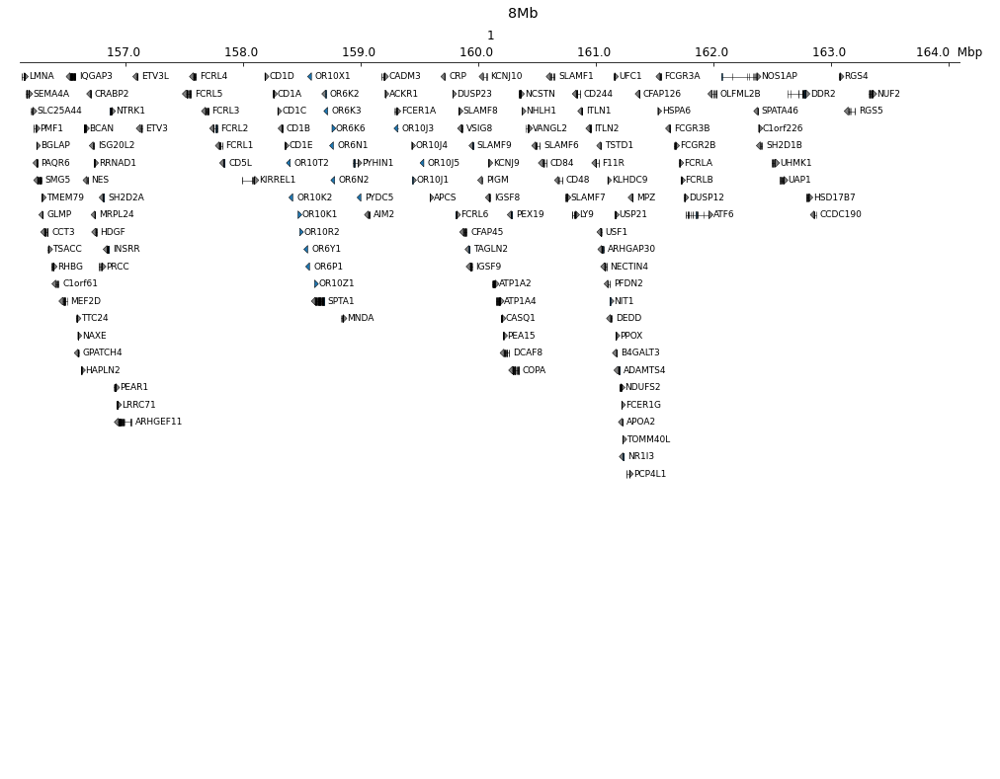

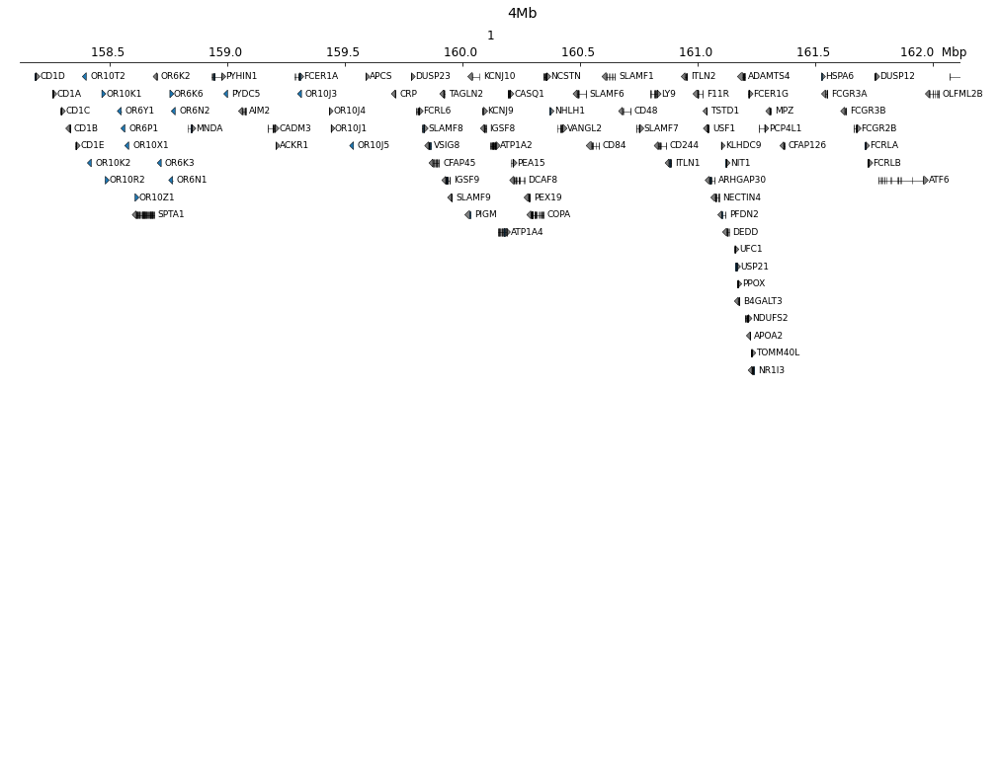

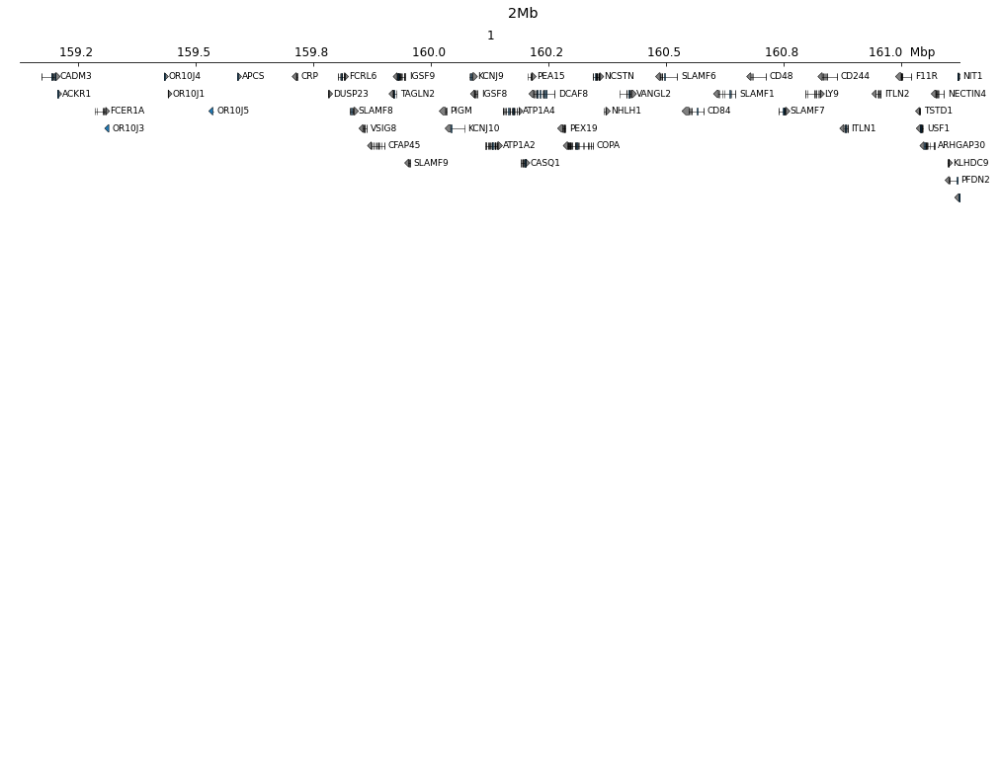

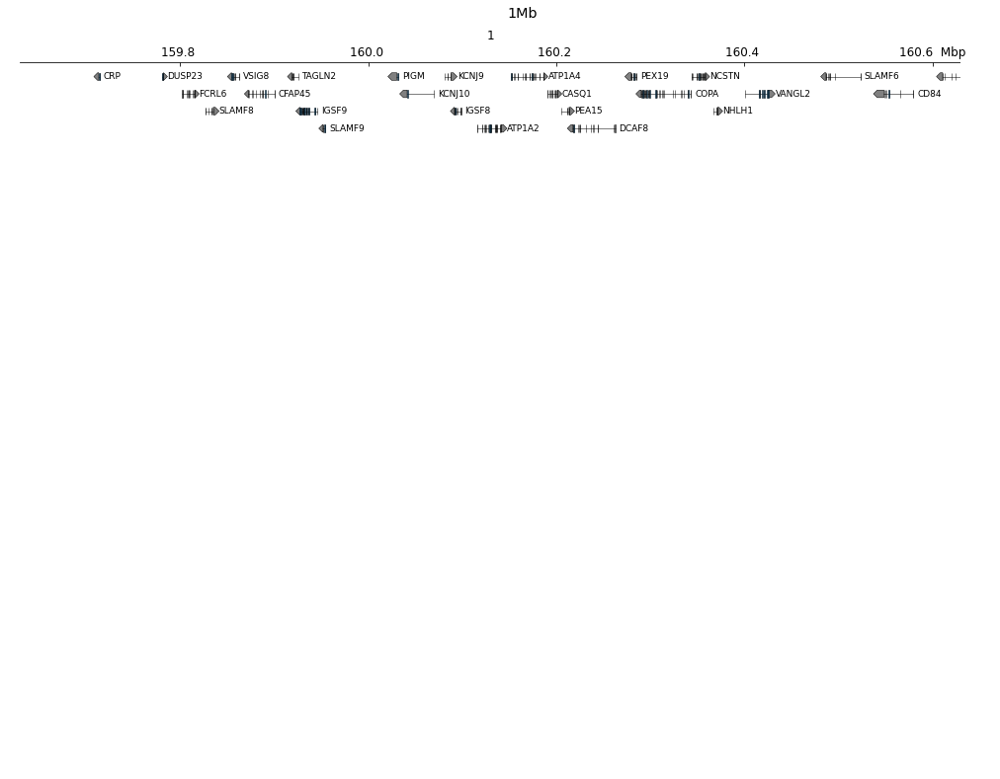


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.3076798915863037
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

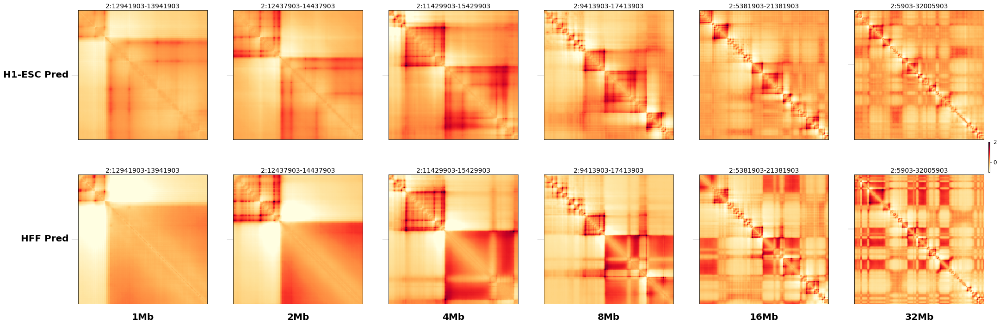

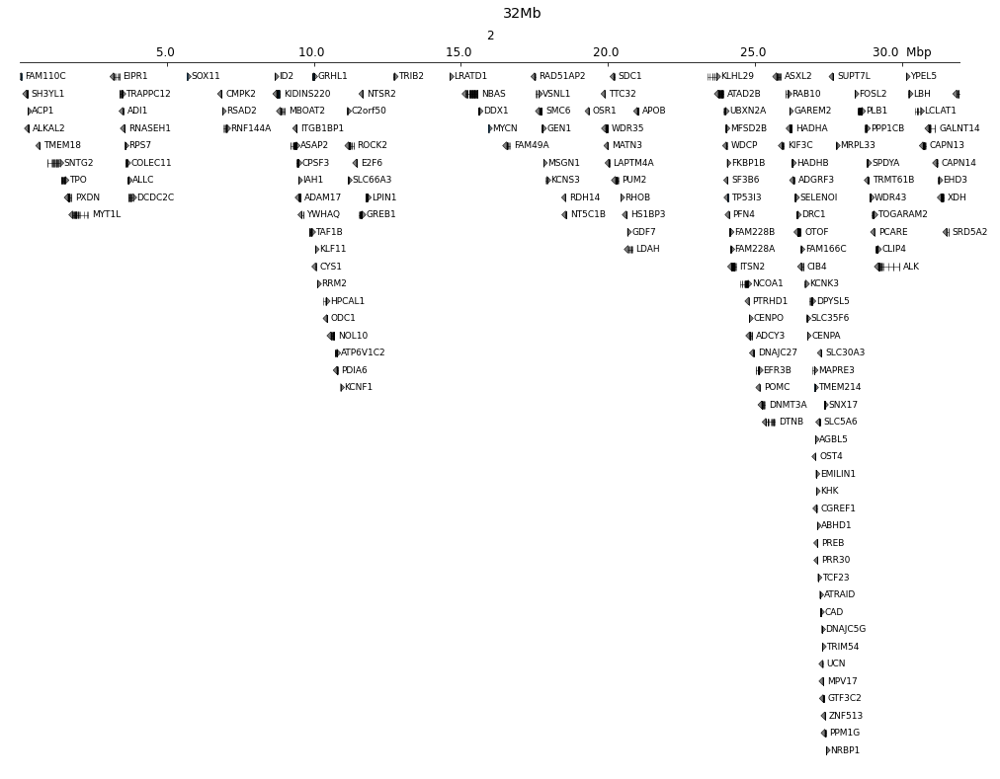

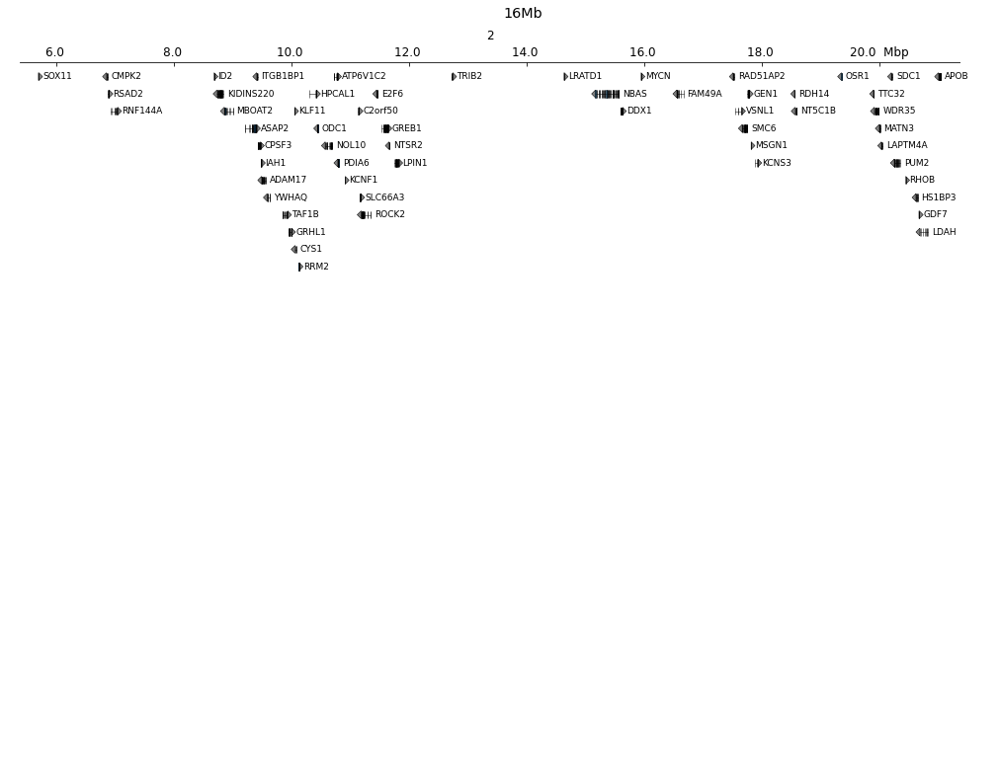

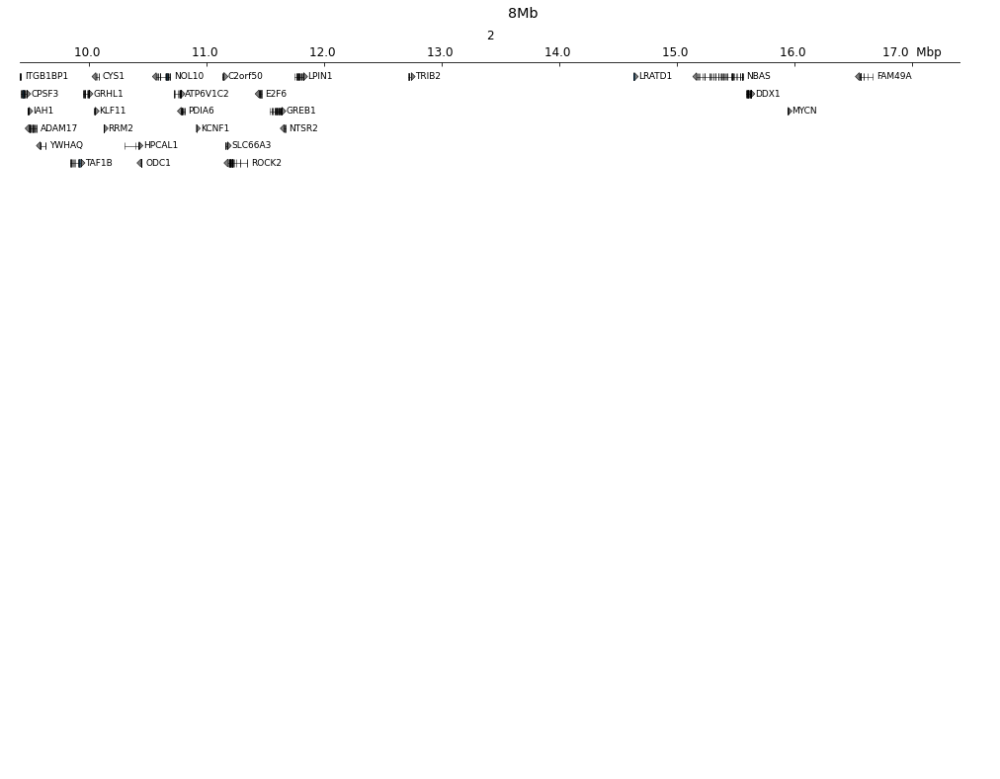

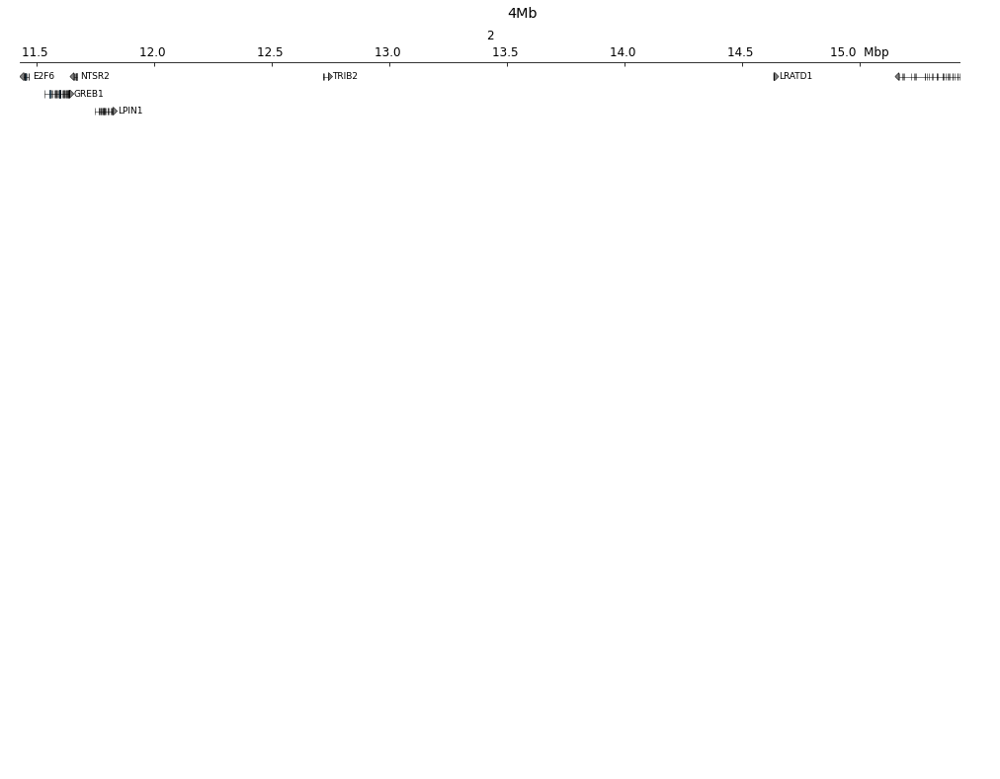

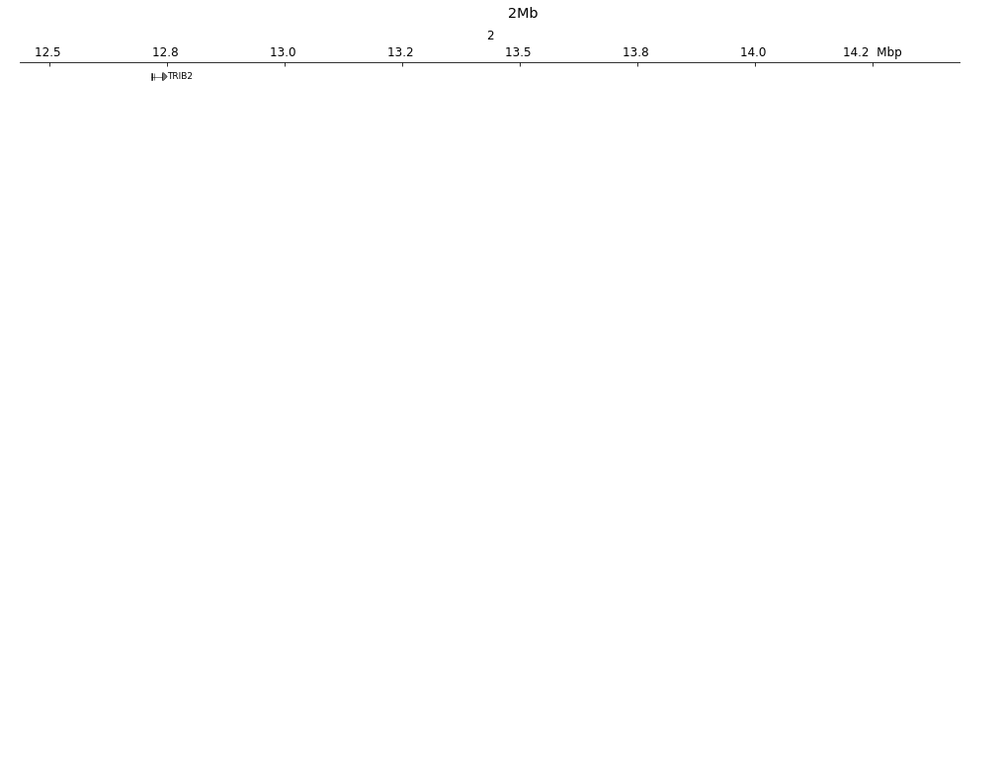

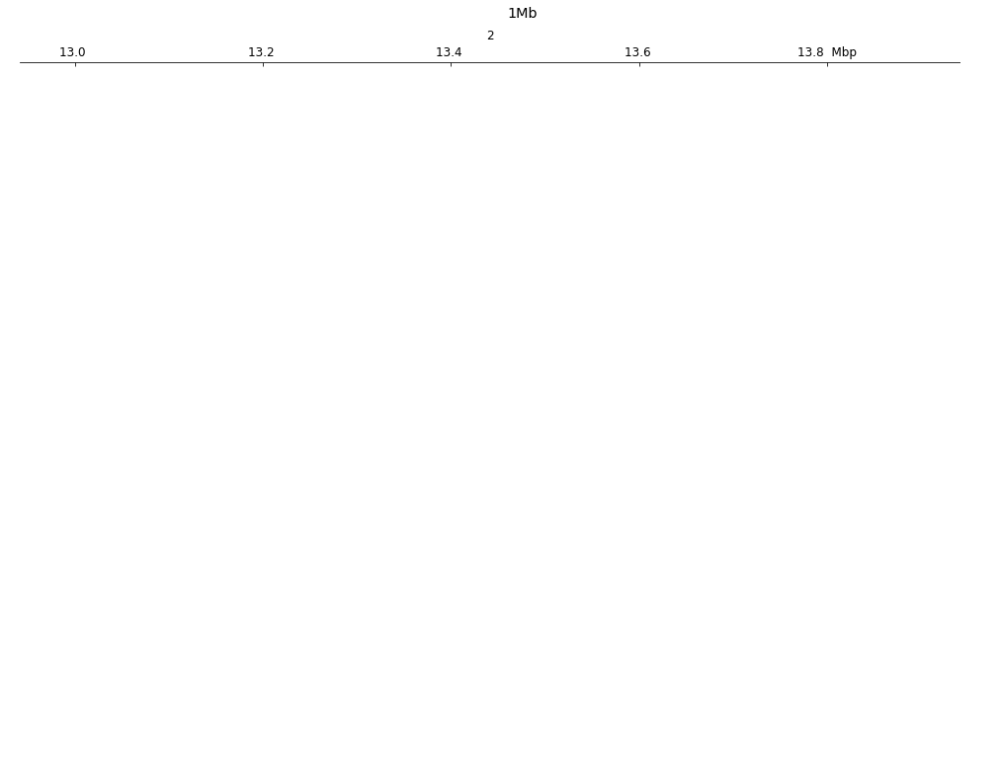


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.4529540538787842
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

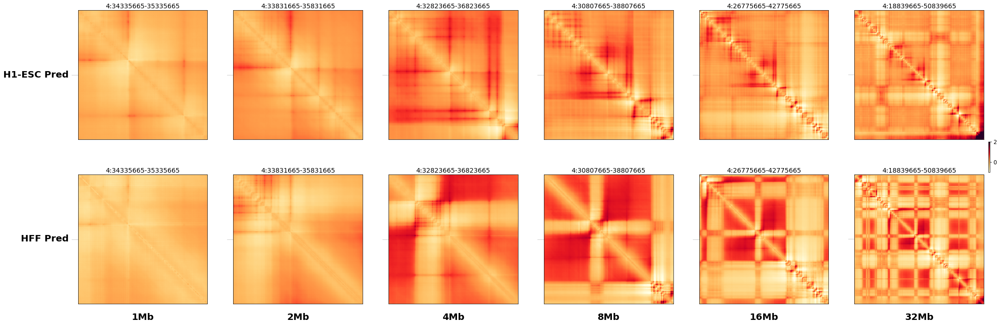

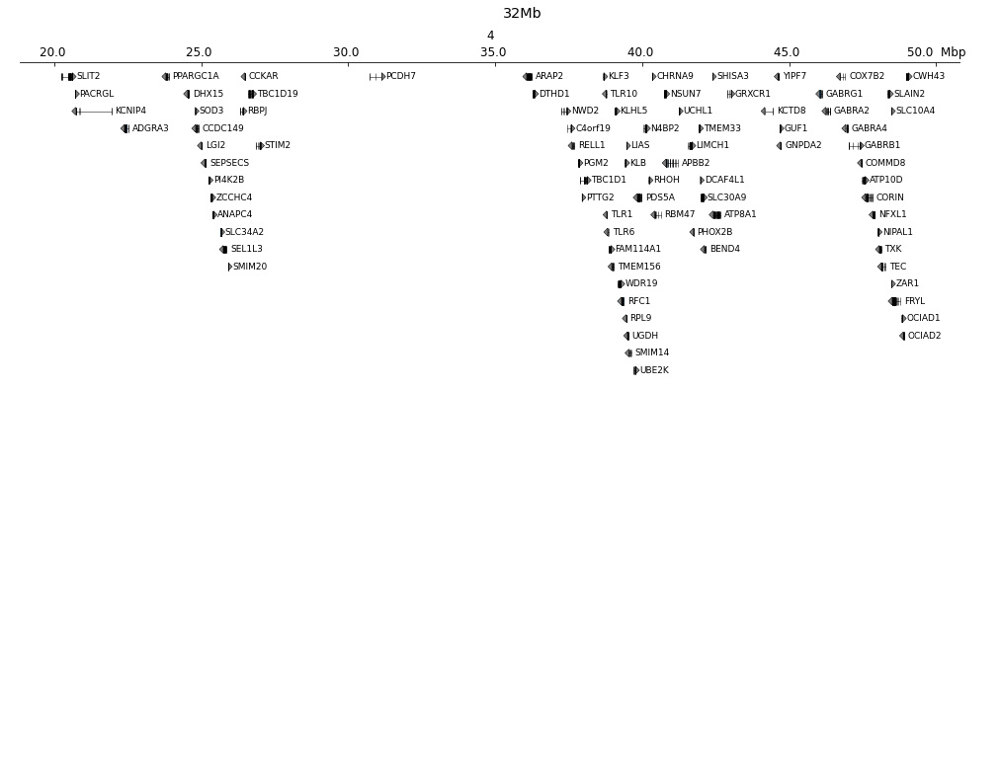

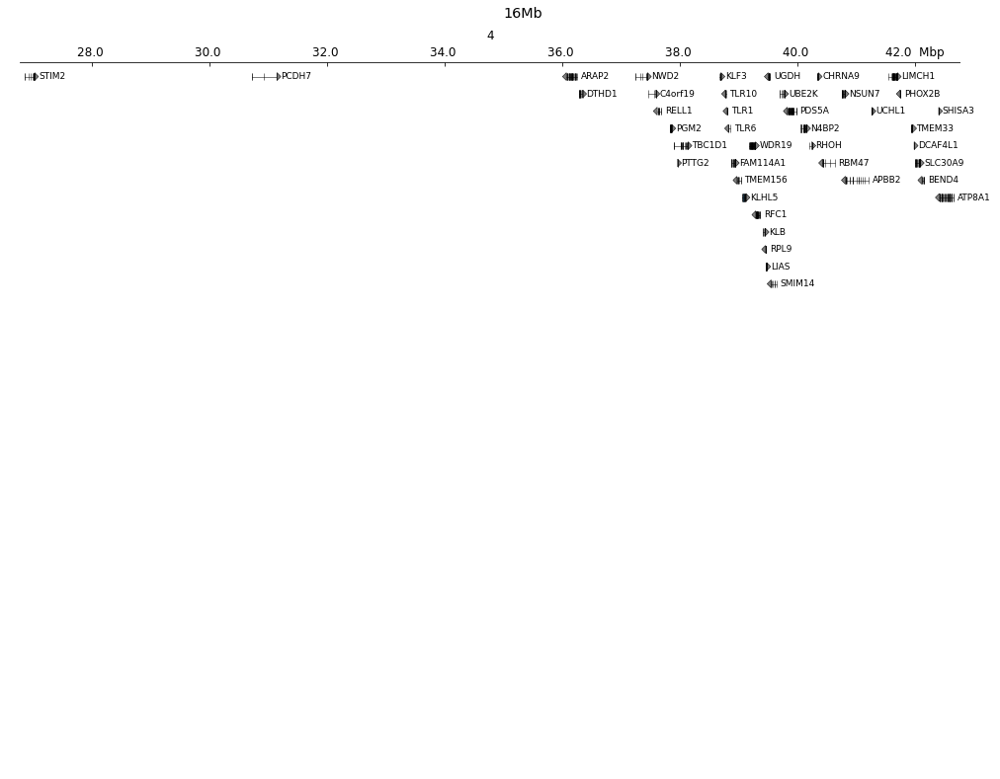

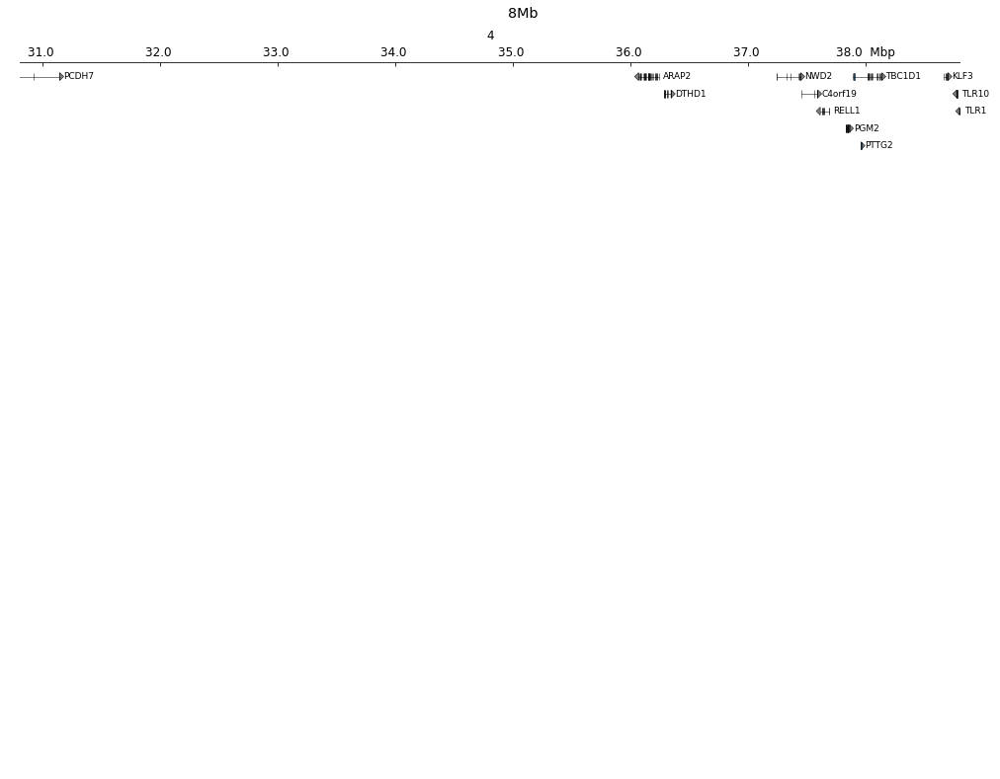

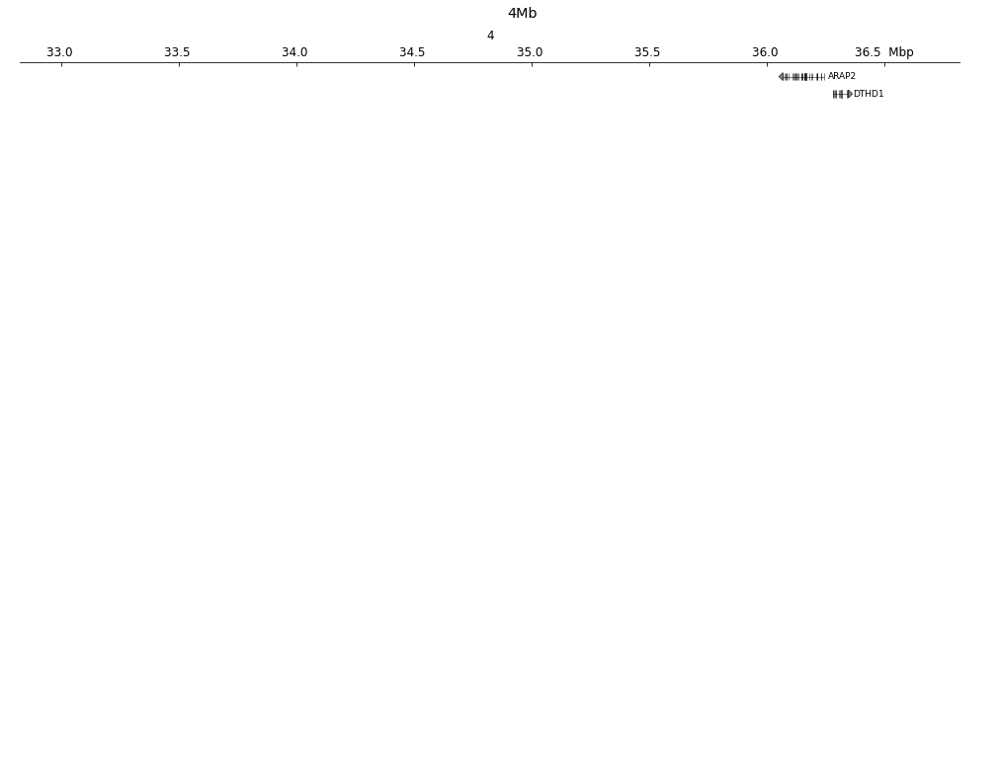

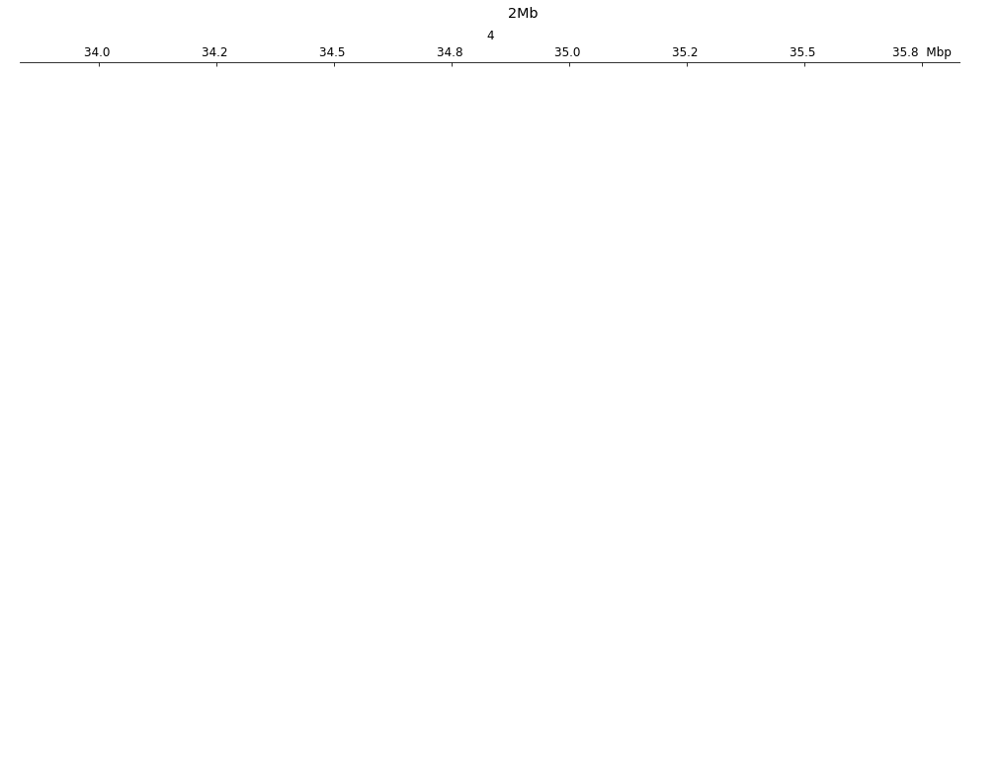

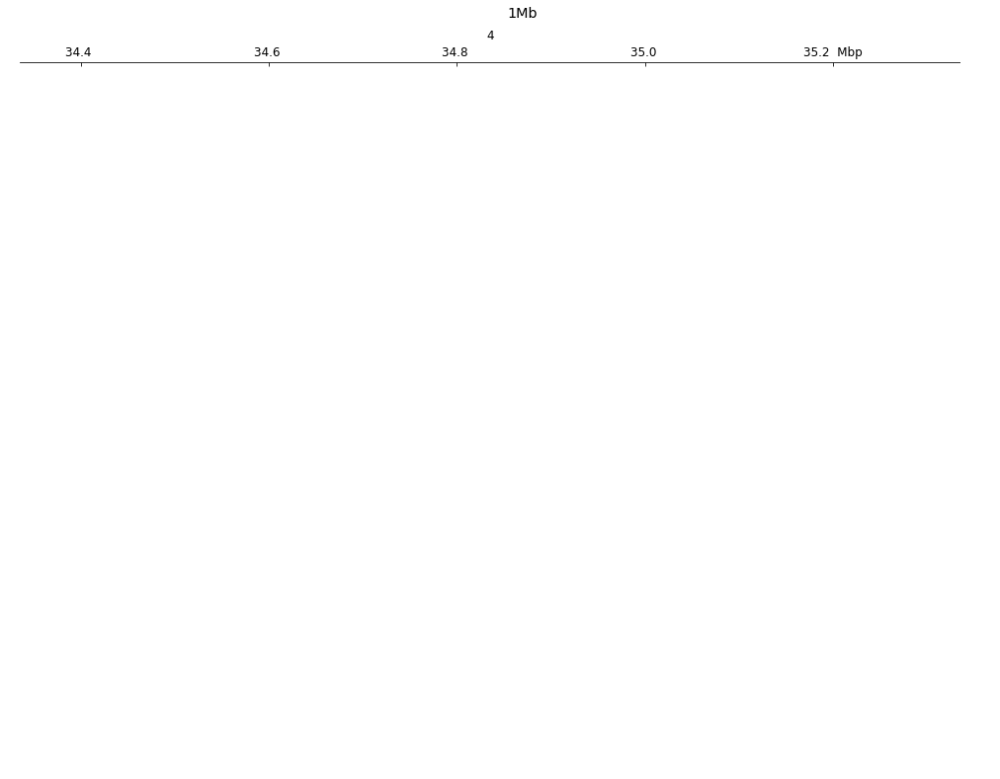


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.740464687347412
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initial

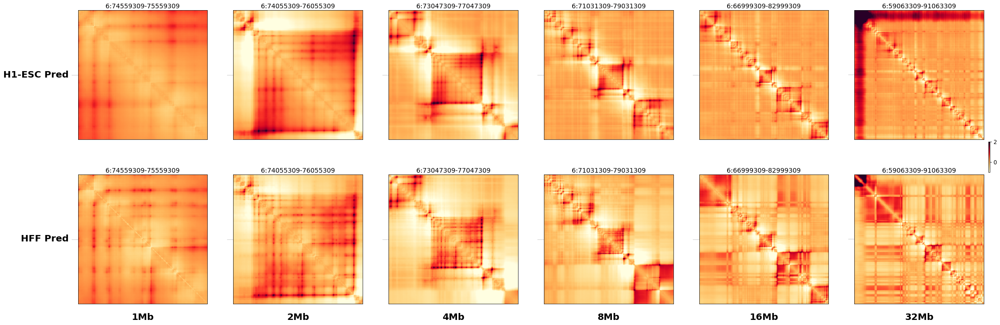

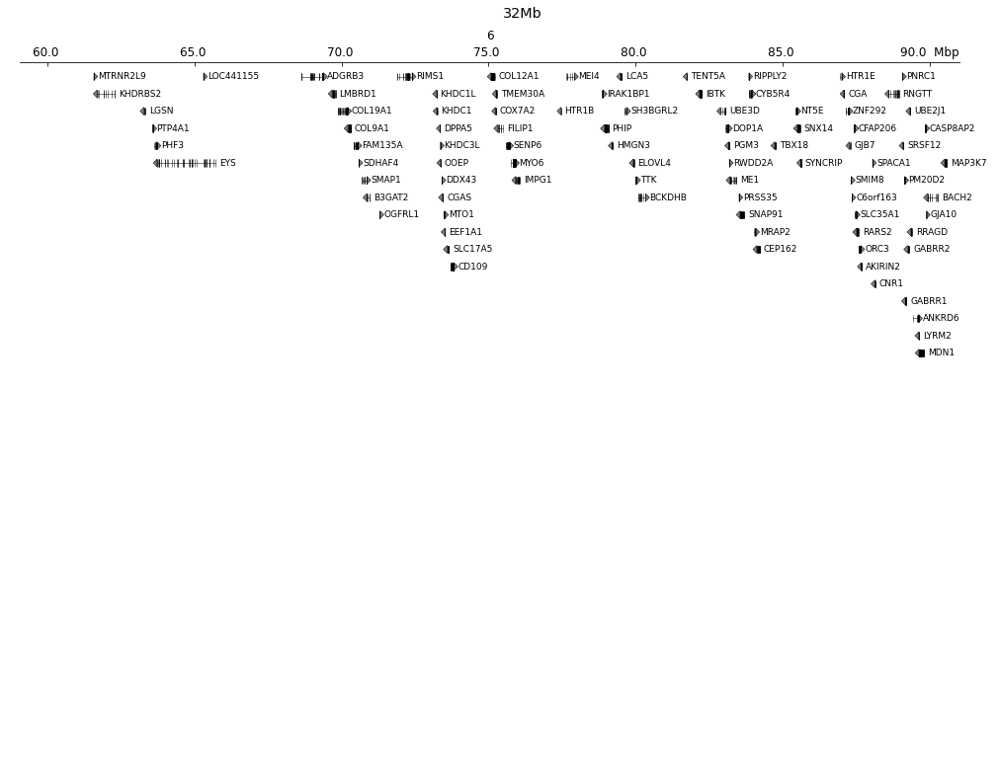

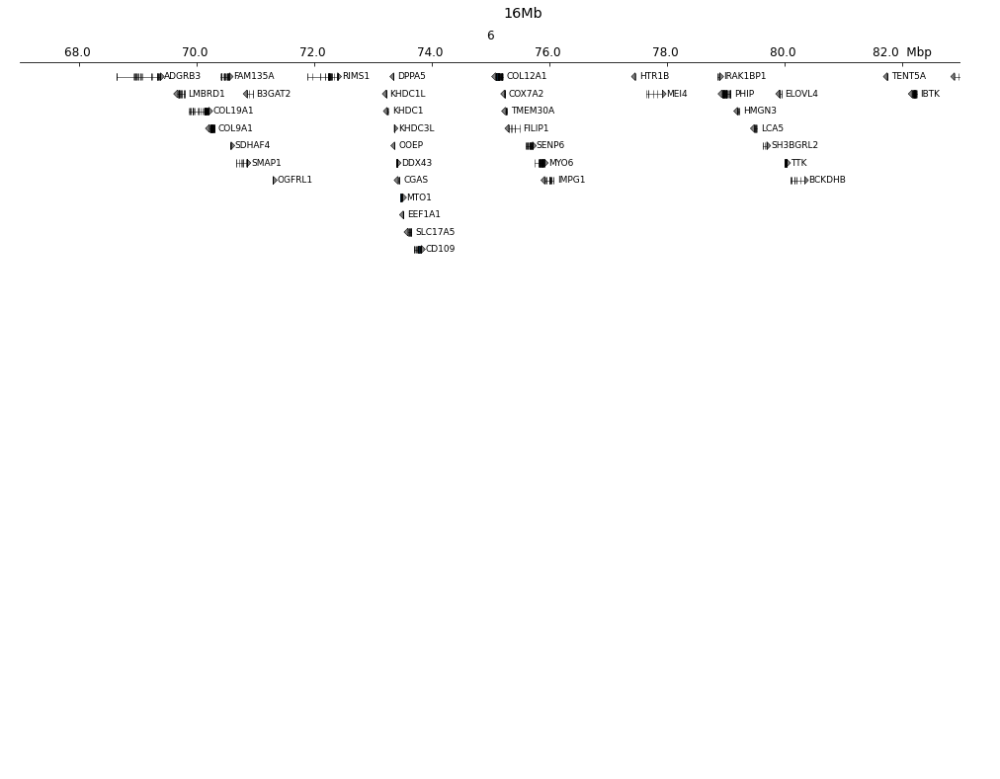

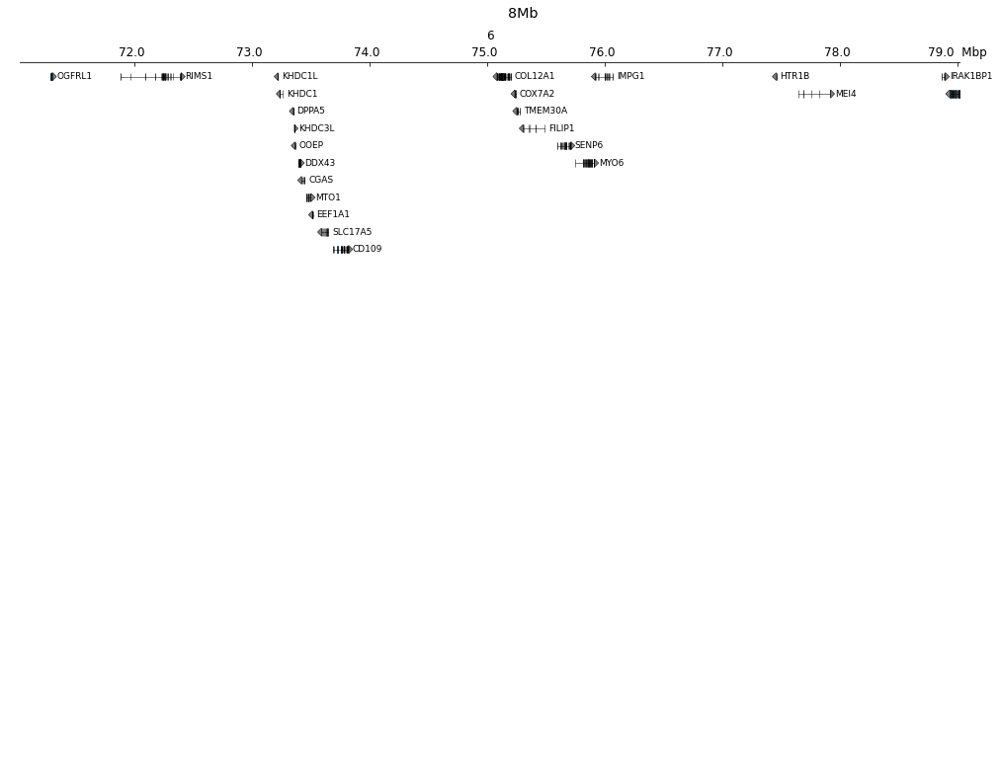

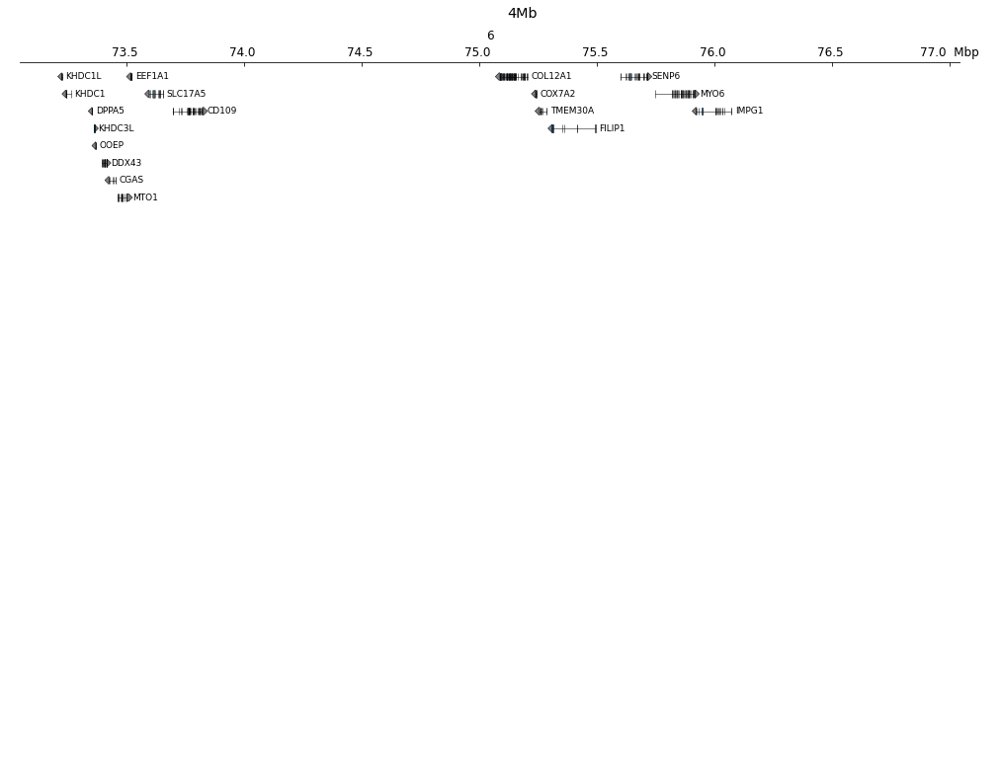

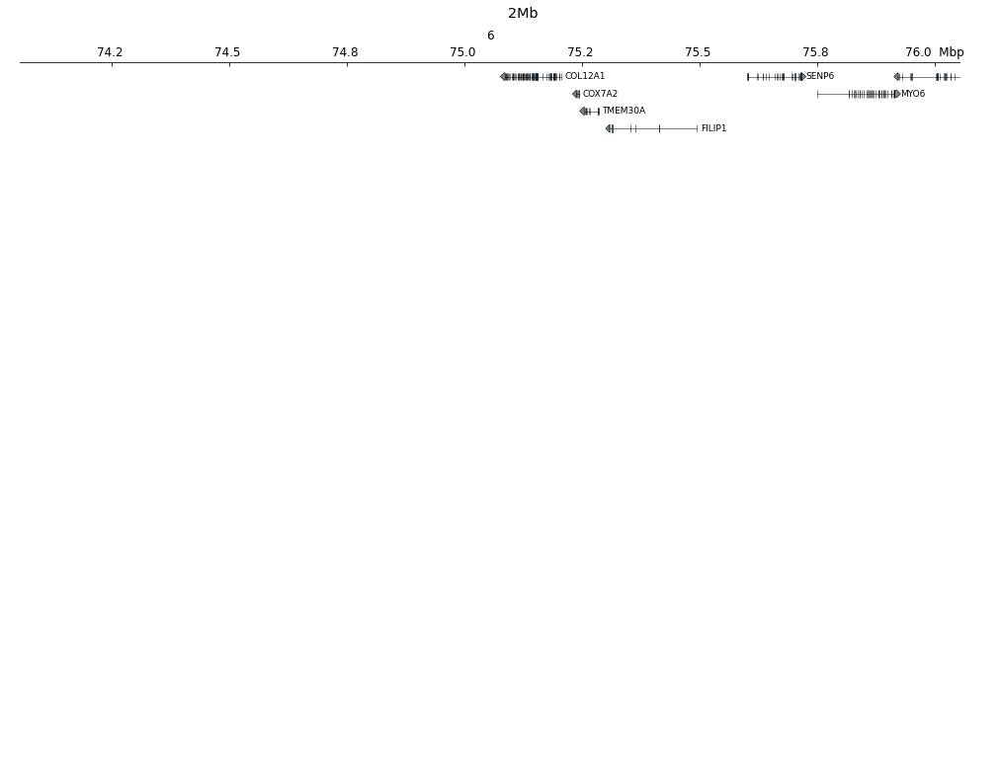

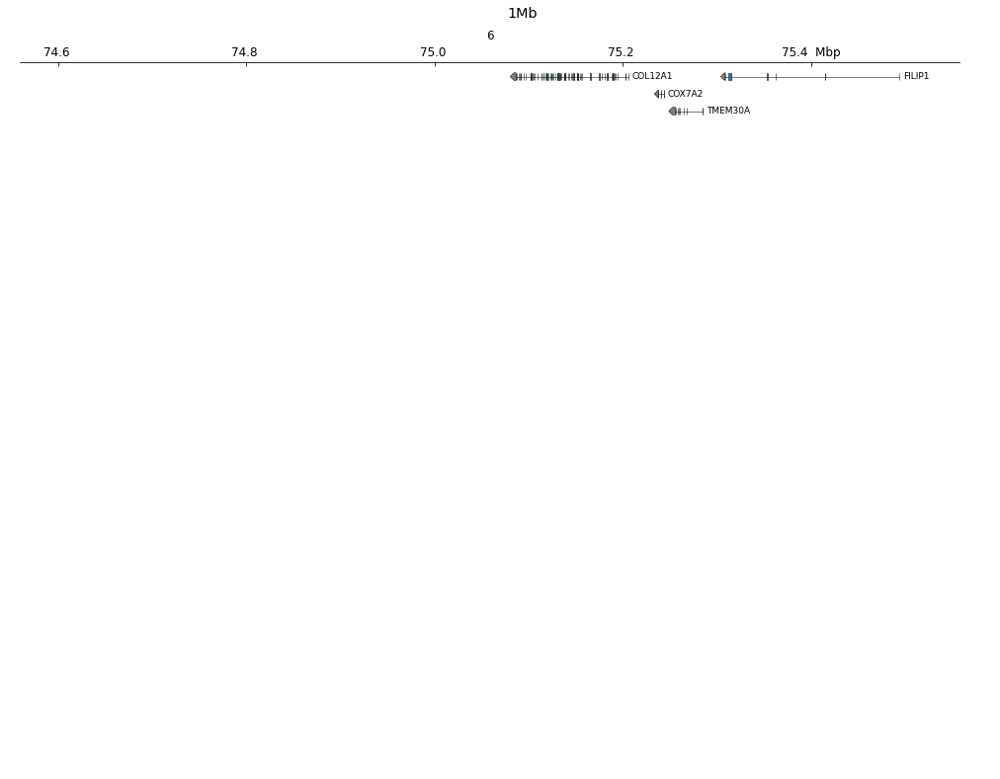


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.5904548168182373
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

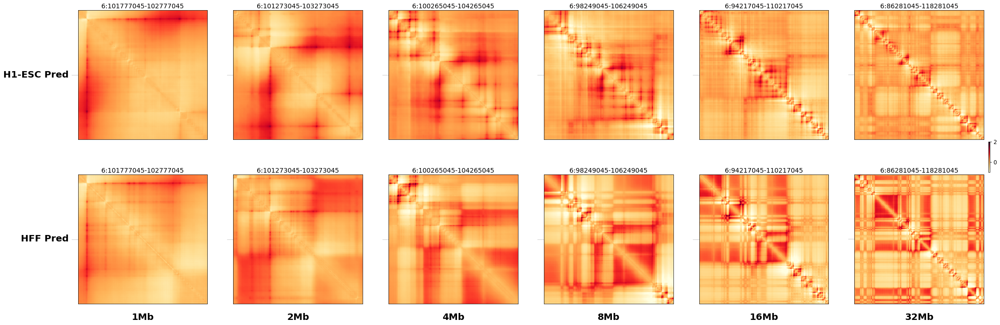

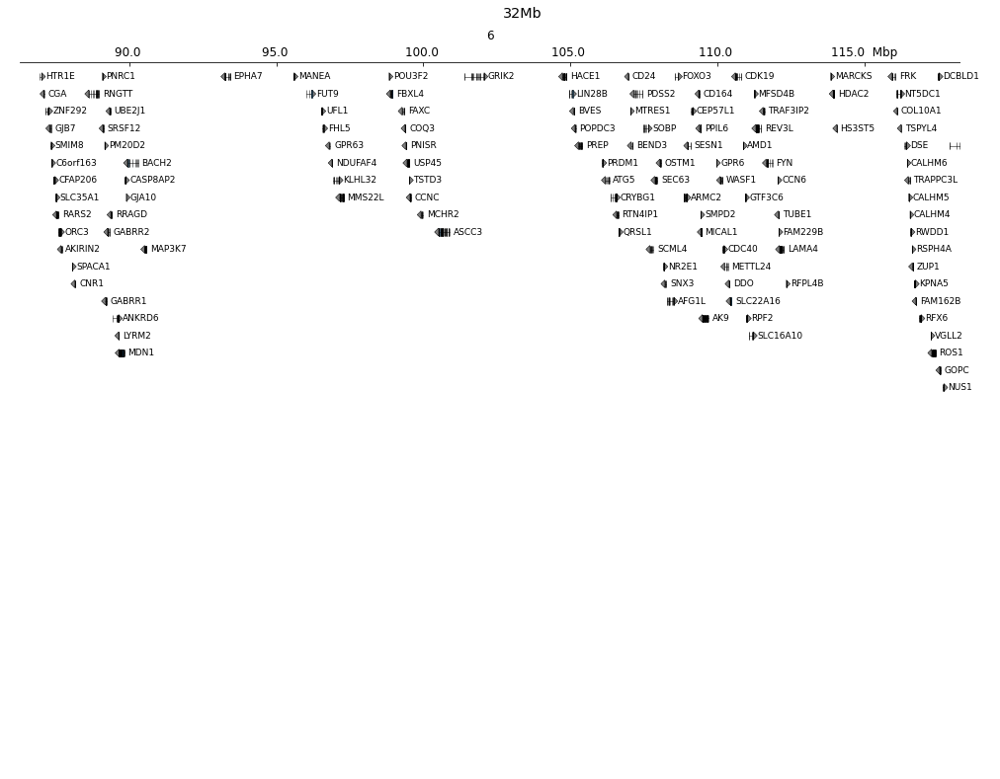

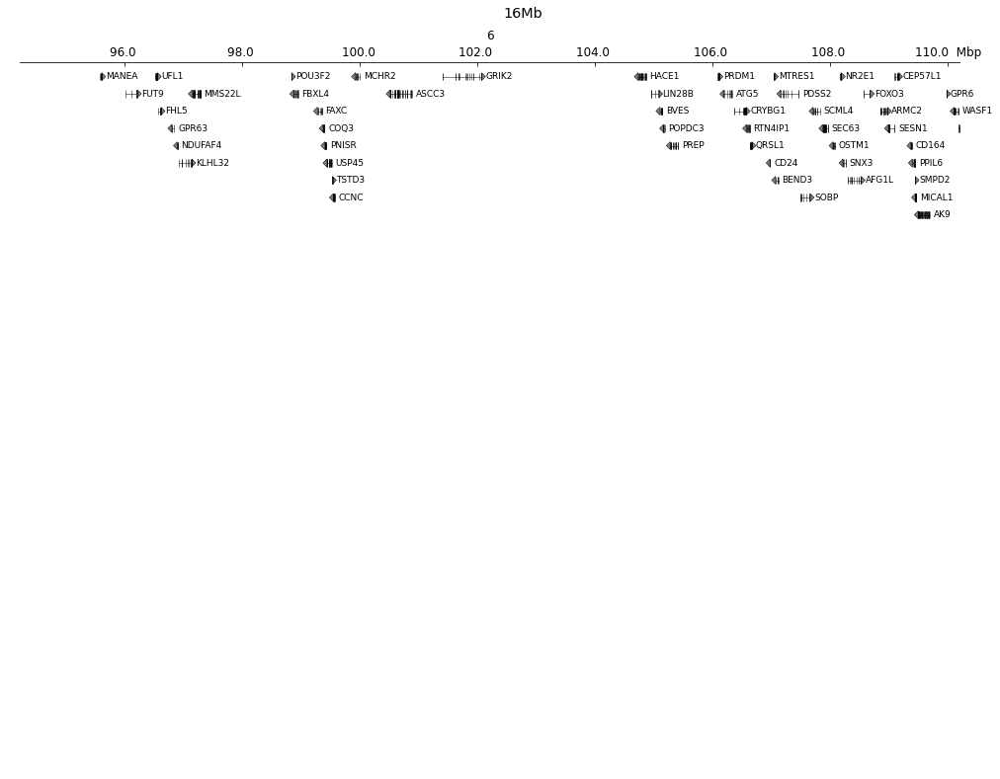

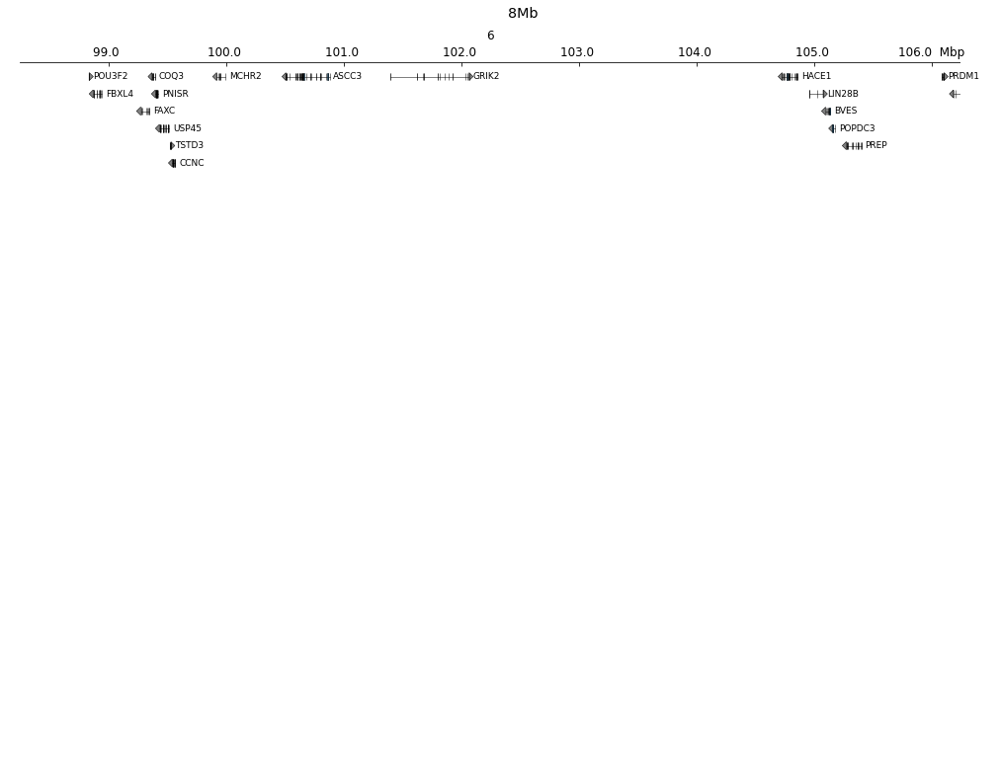

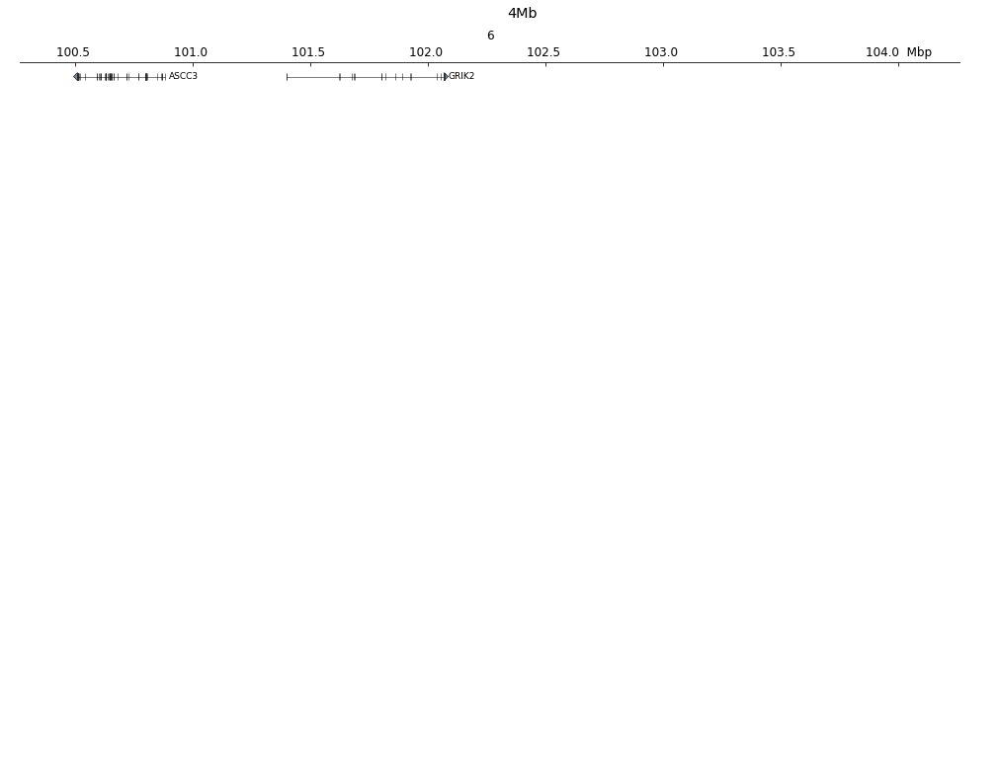

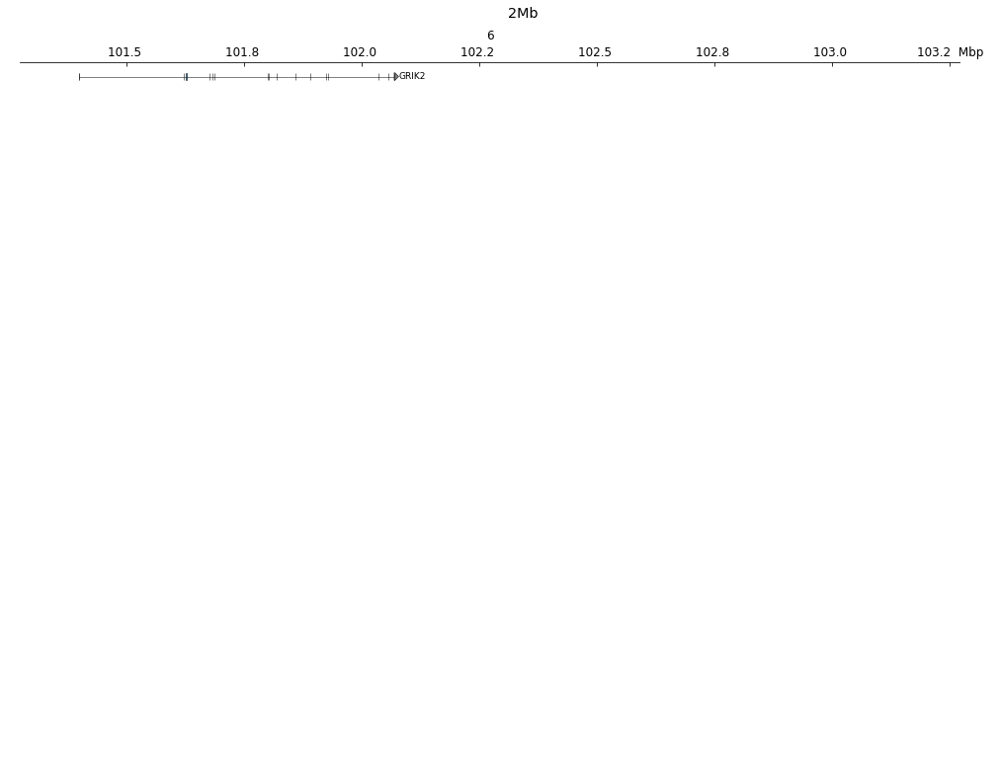

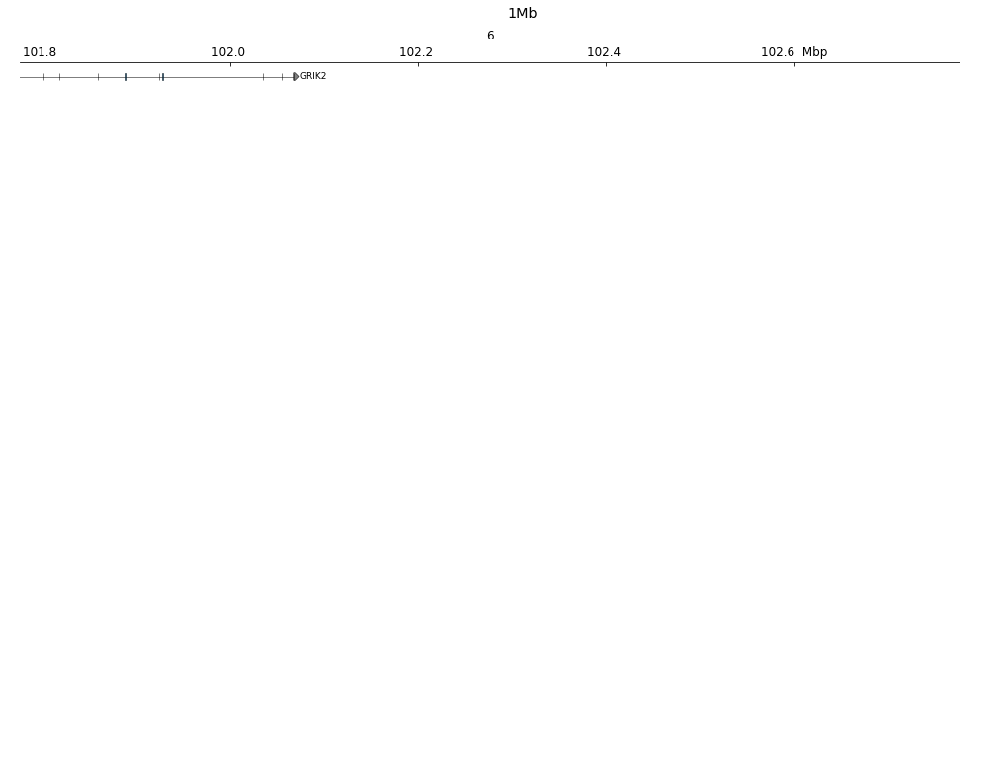


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.8064520359039307
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

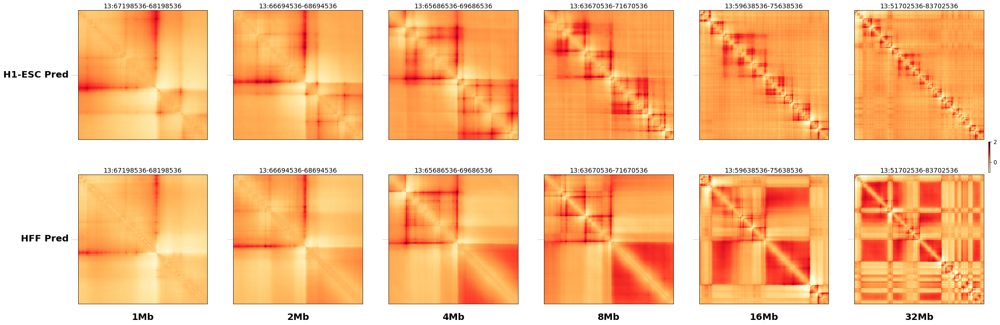

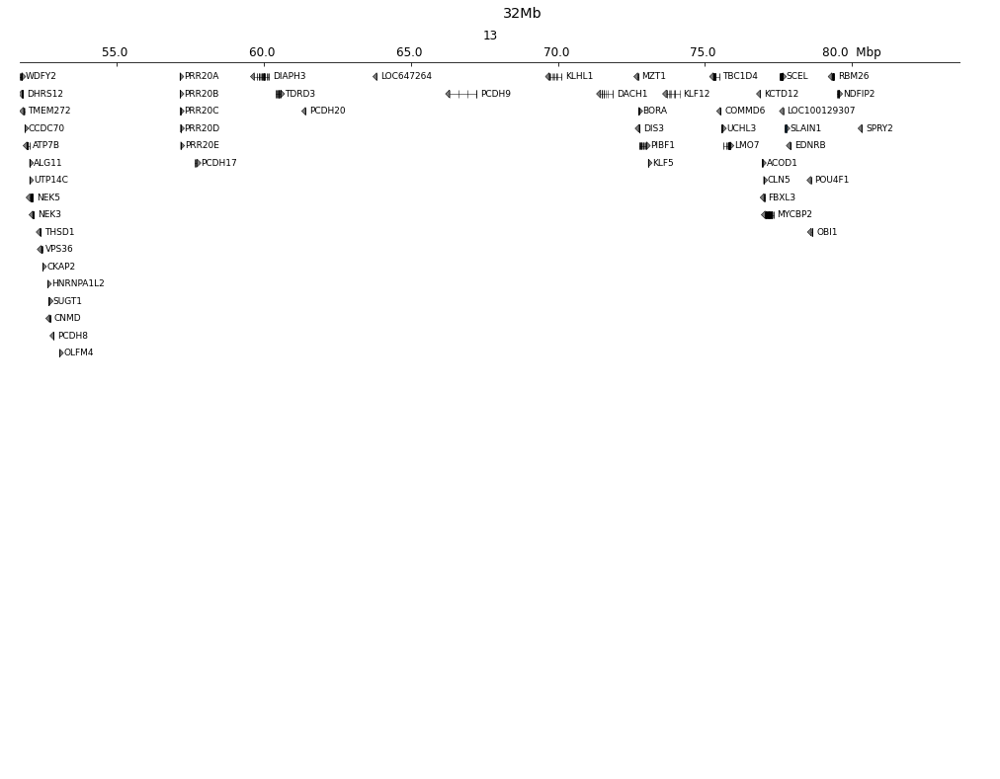

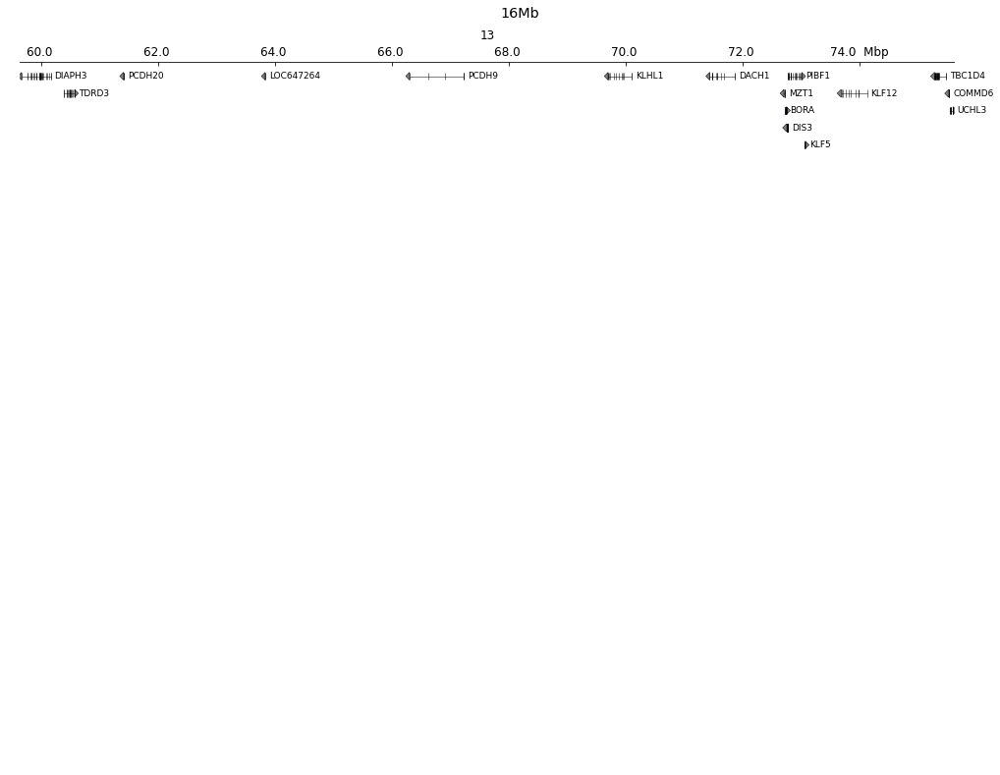

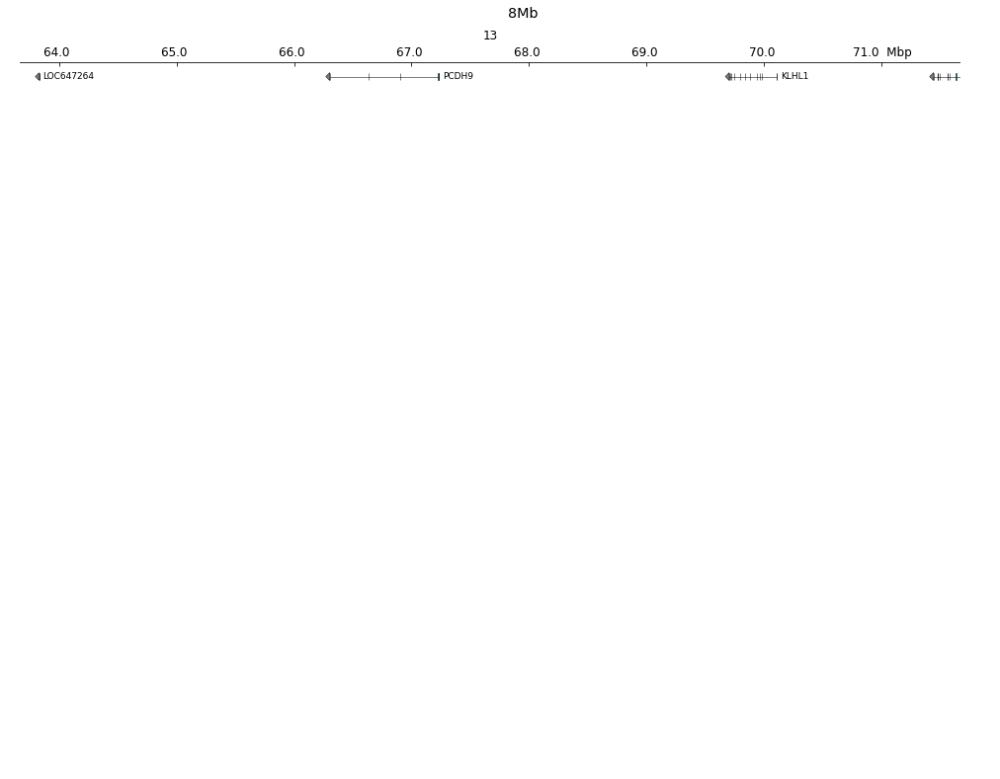

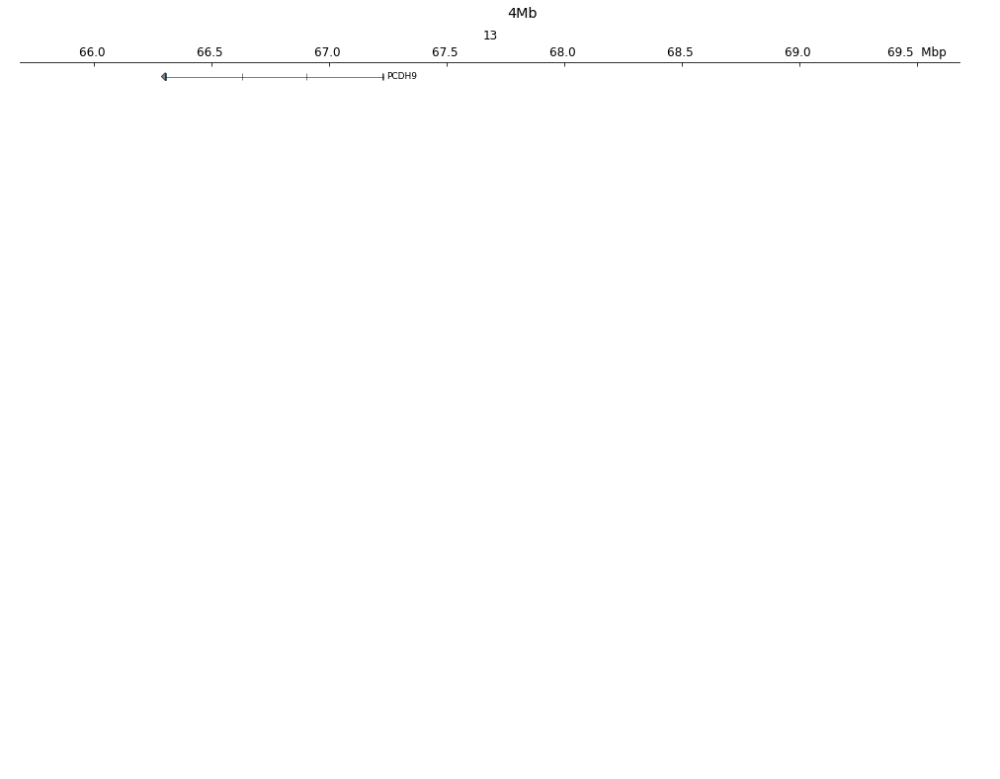

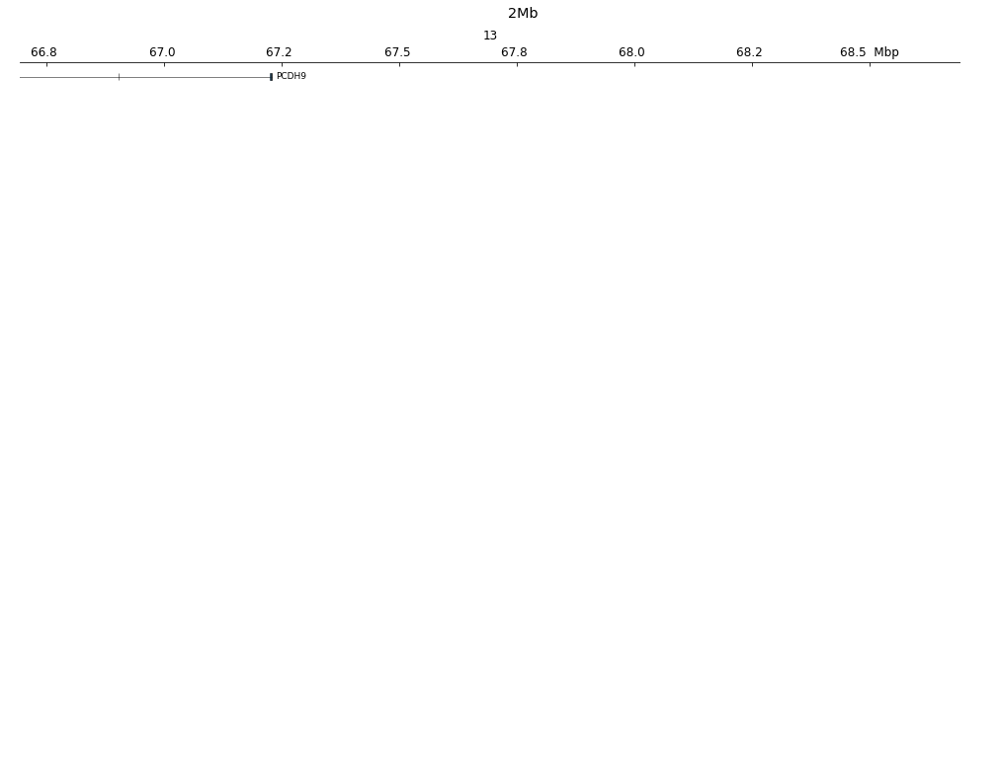

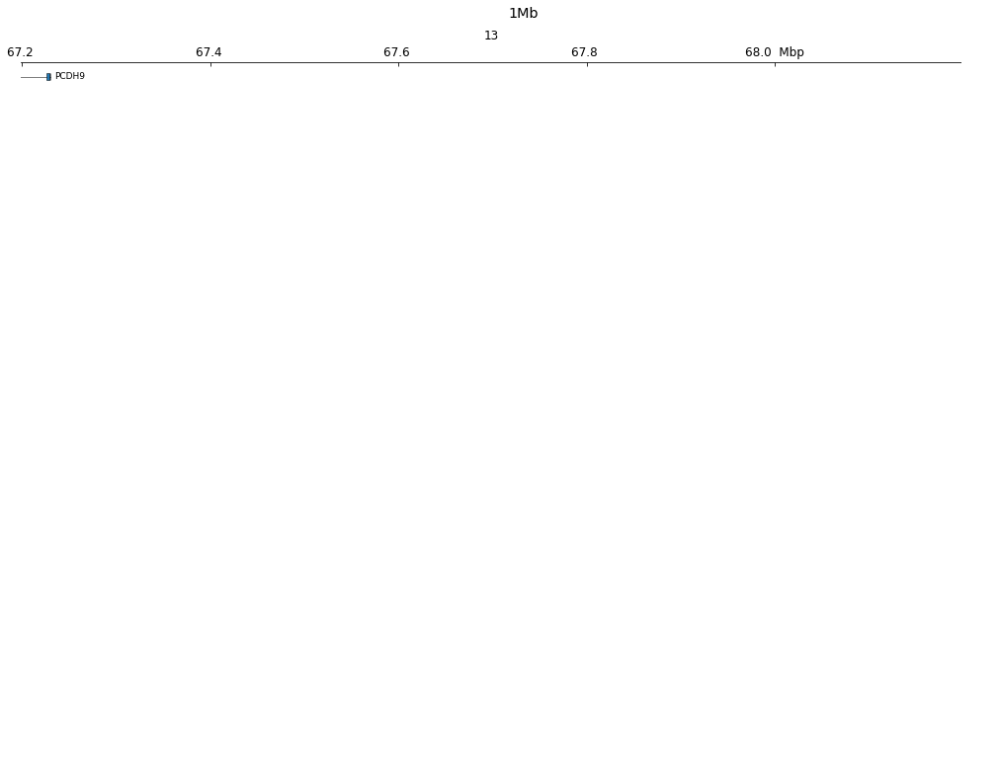


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.7870826721191406
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

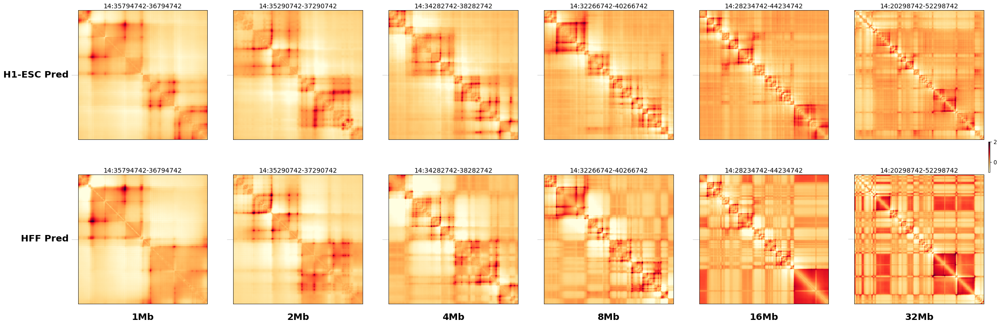

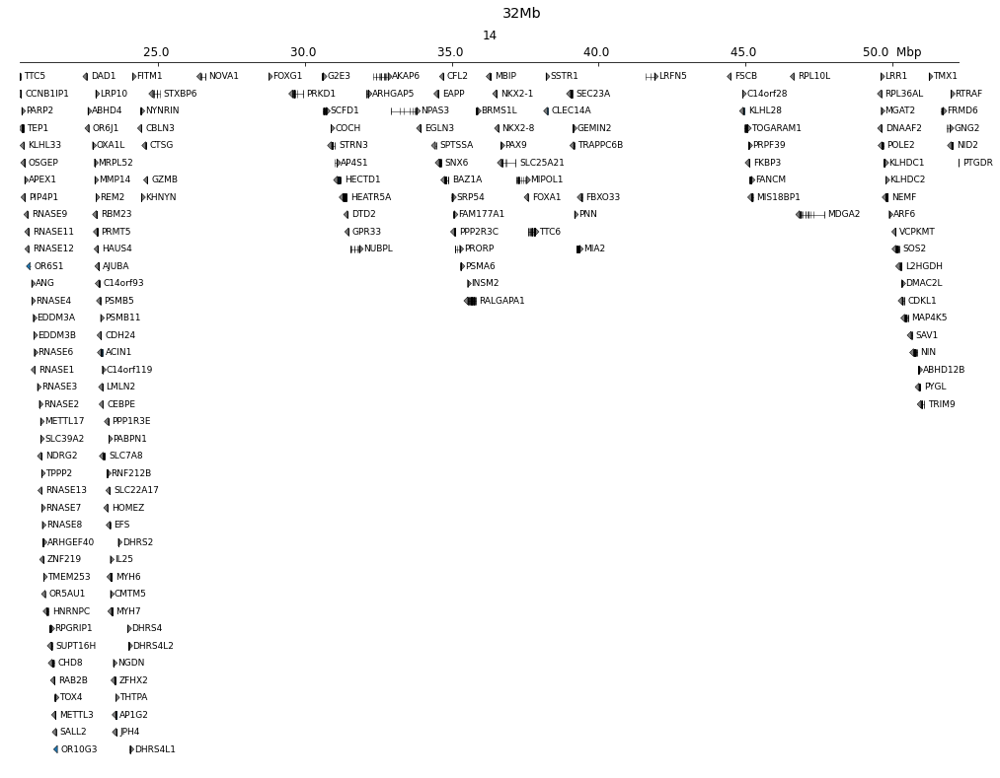

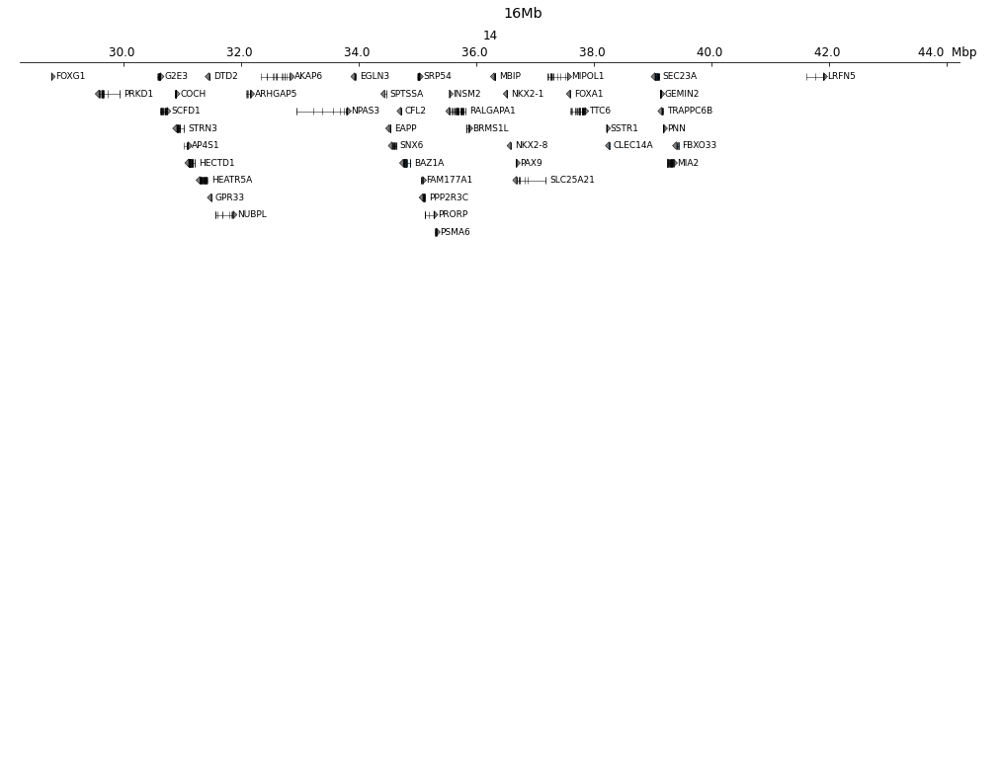

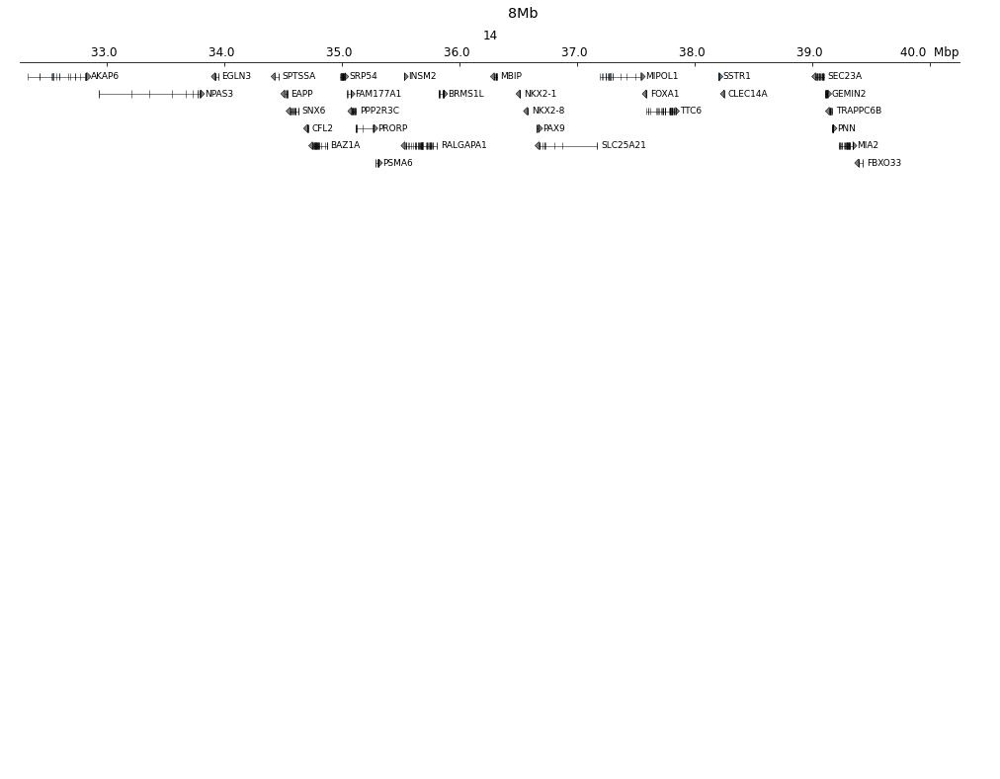

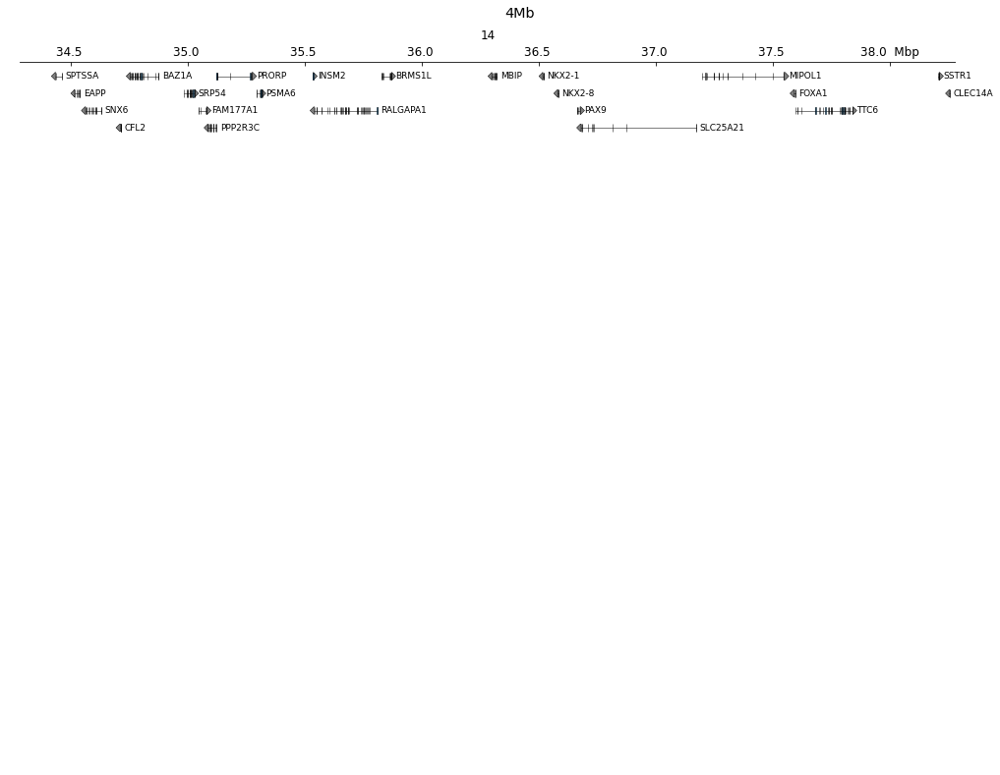

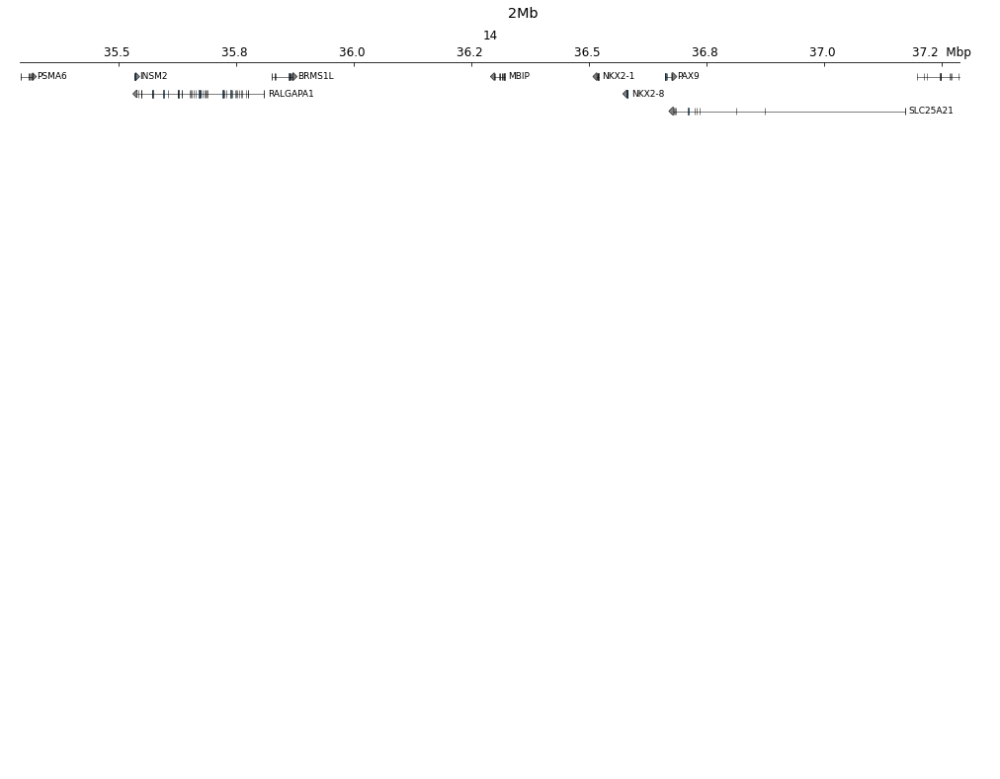

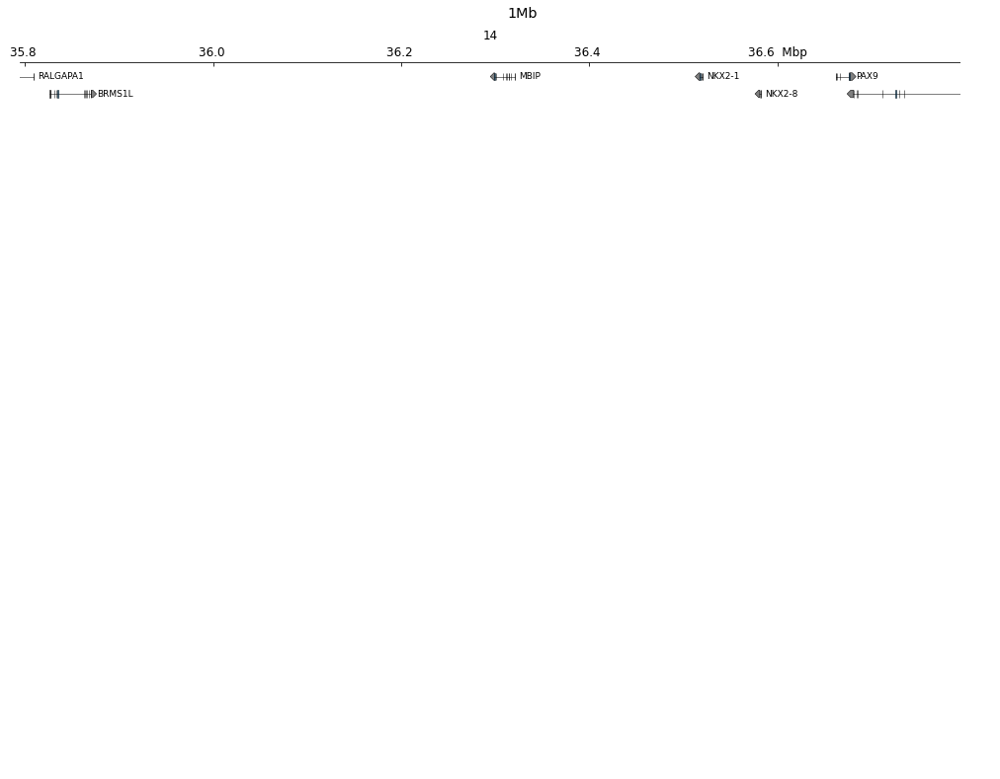


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.865623950958252
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initial

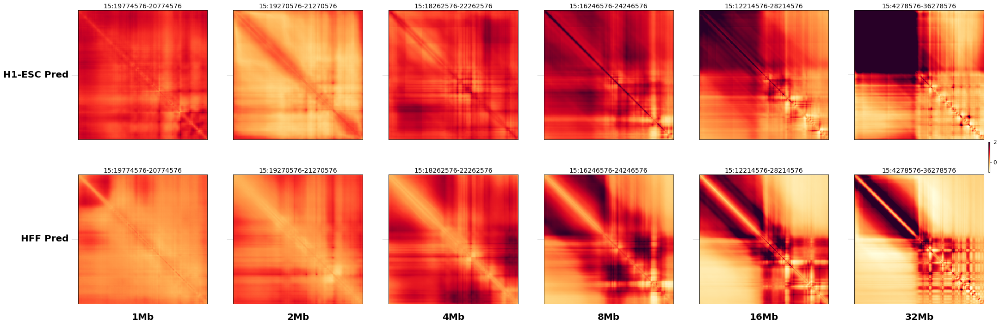

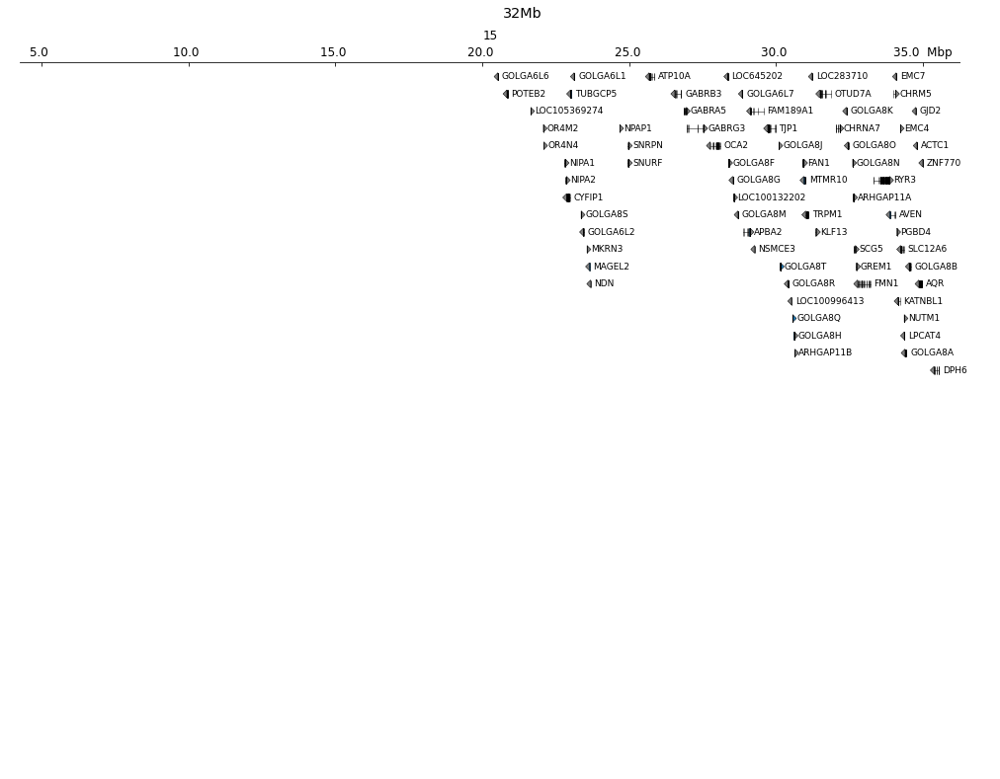

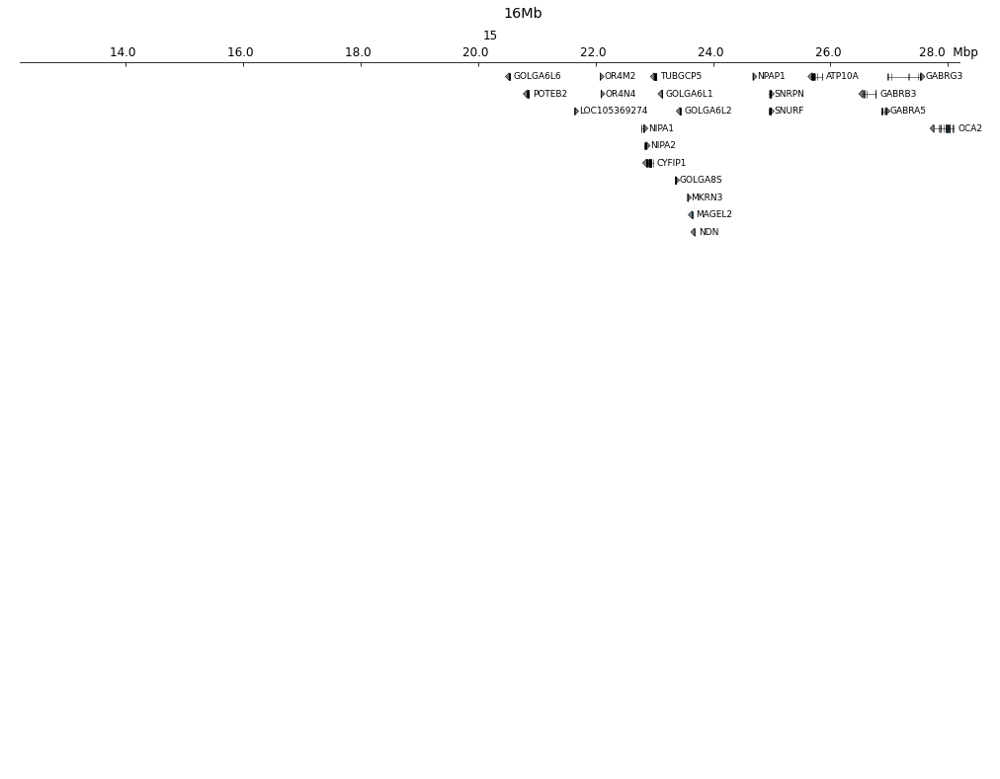

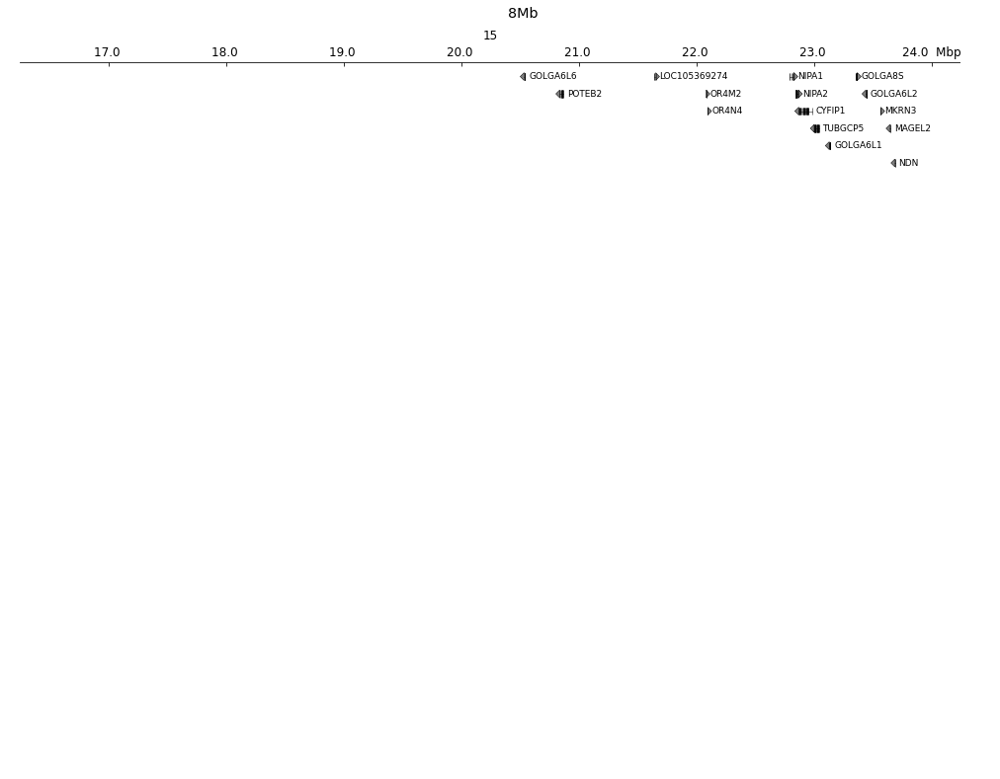

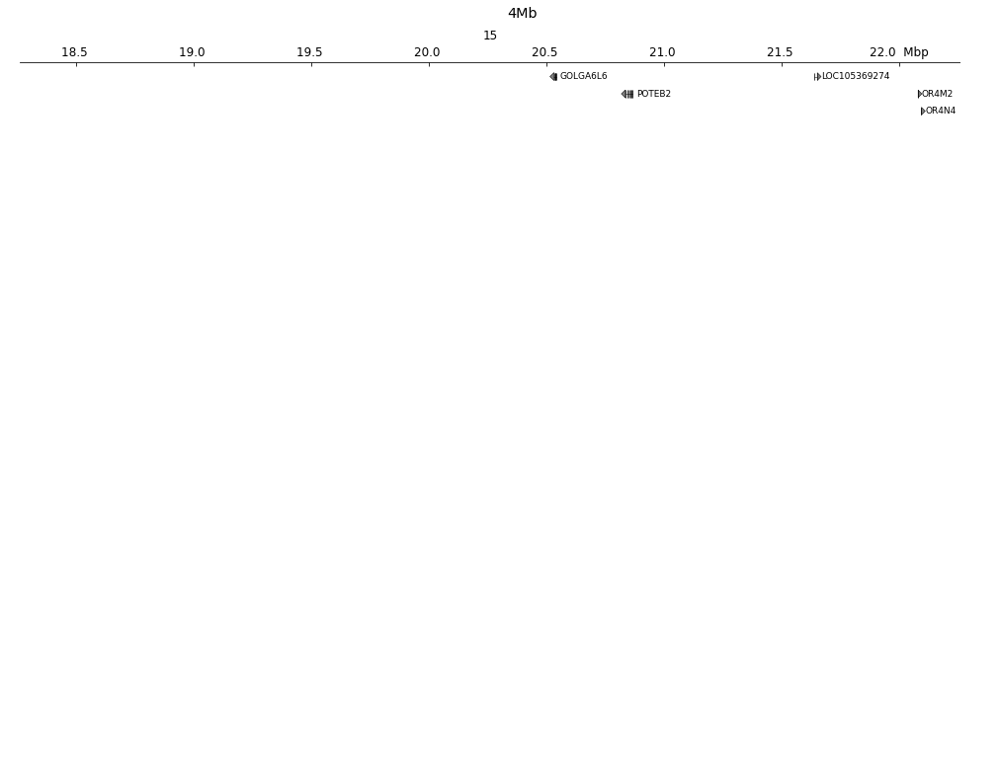

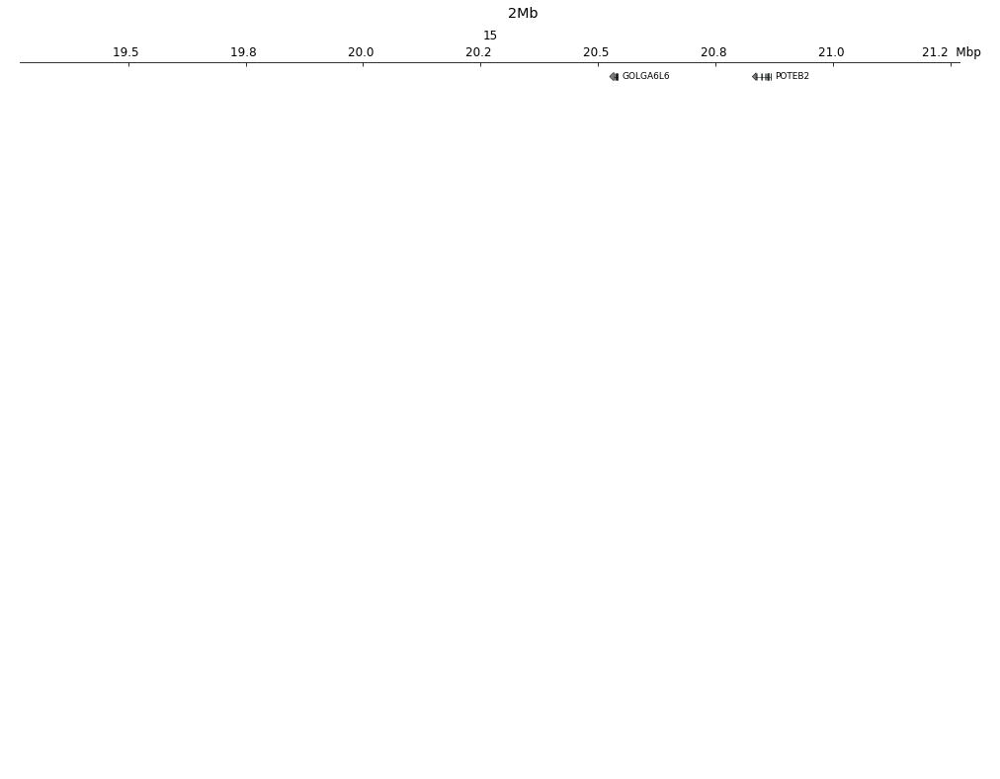

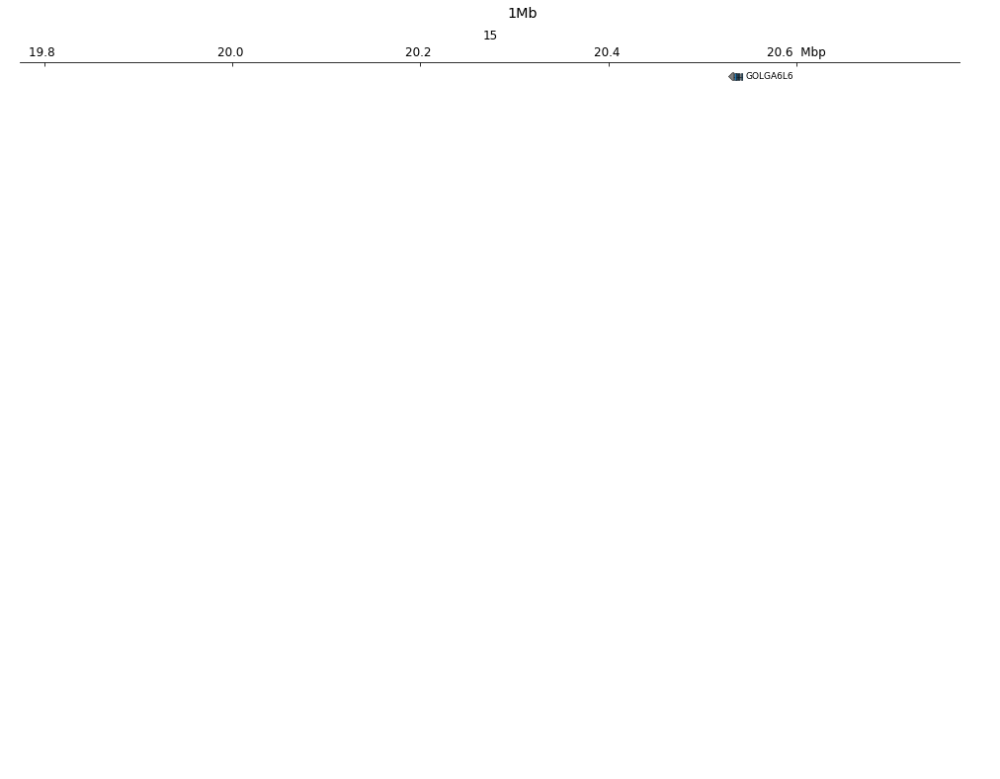


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.4648563861846924
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

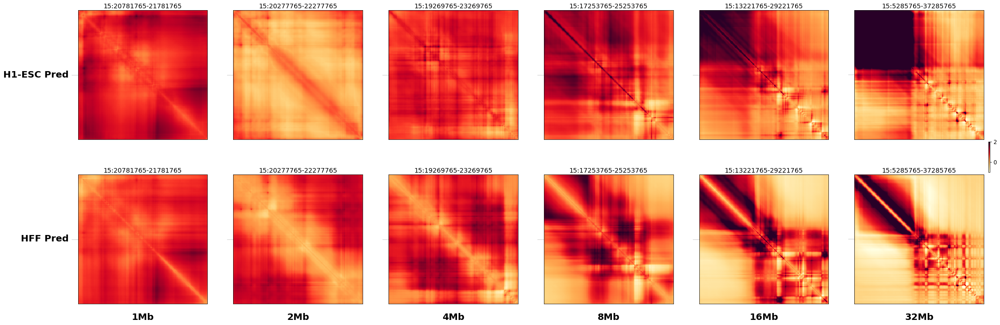

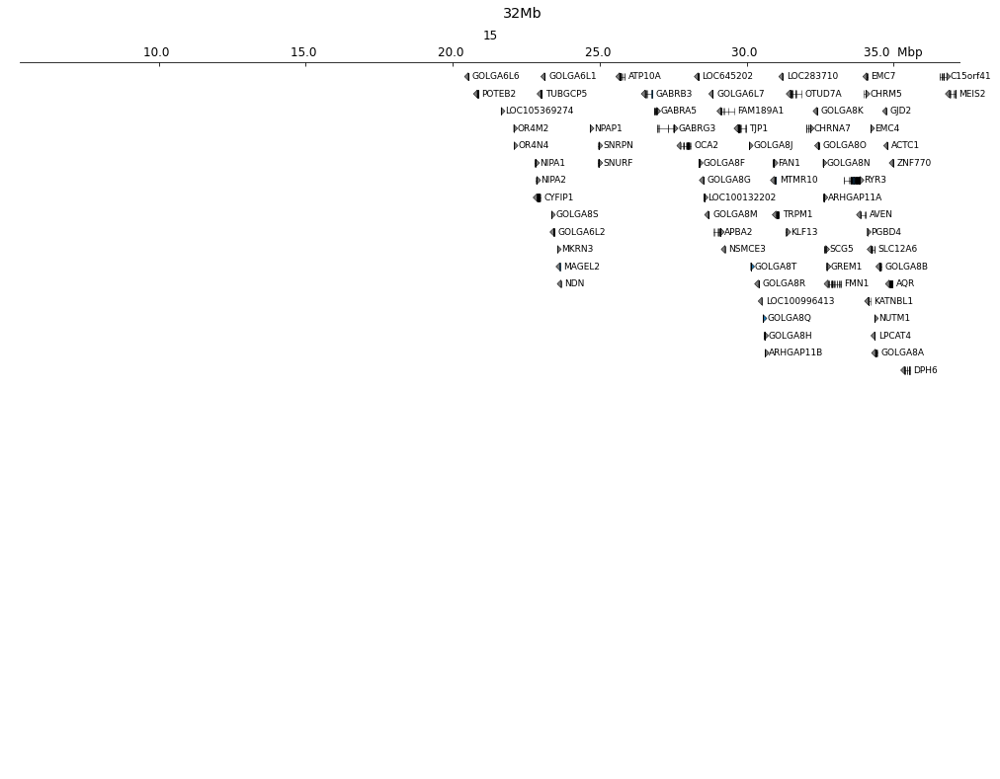

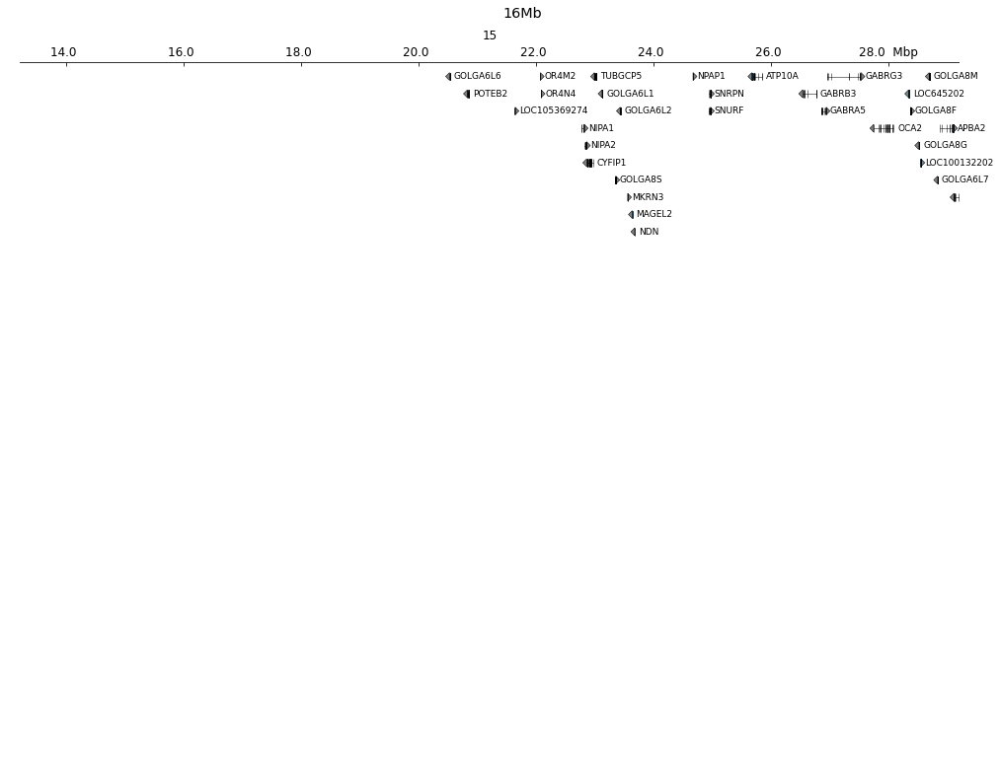

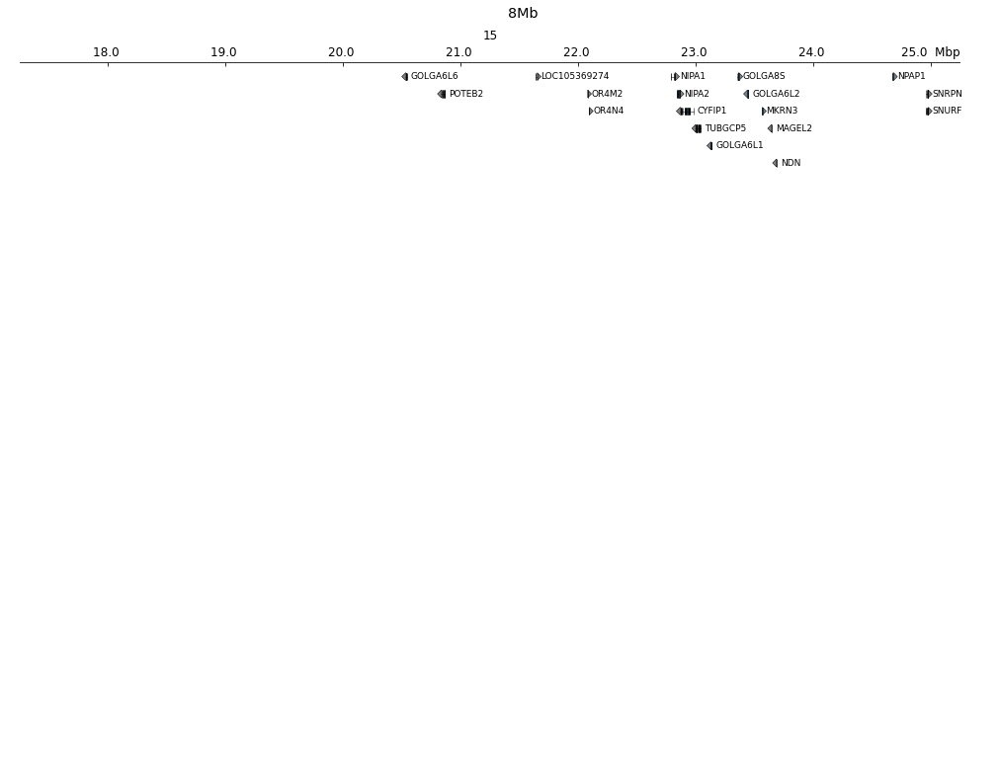

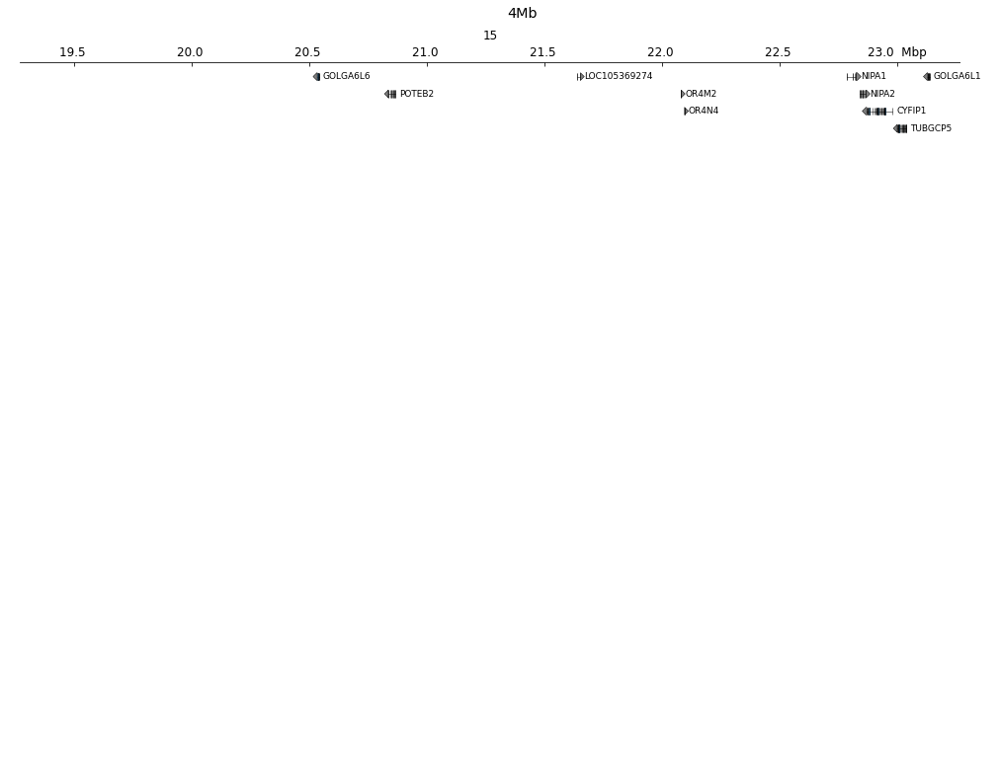

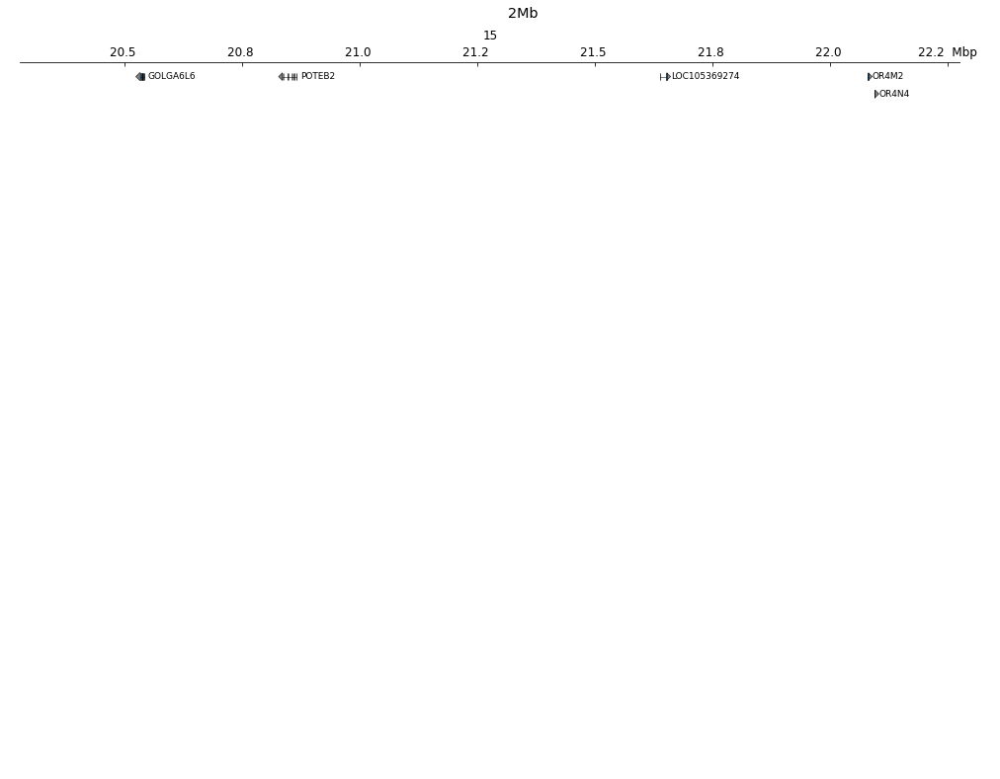

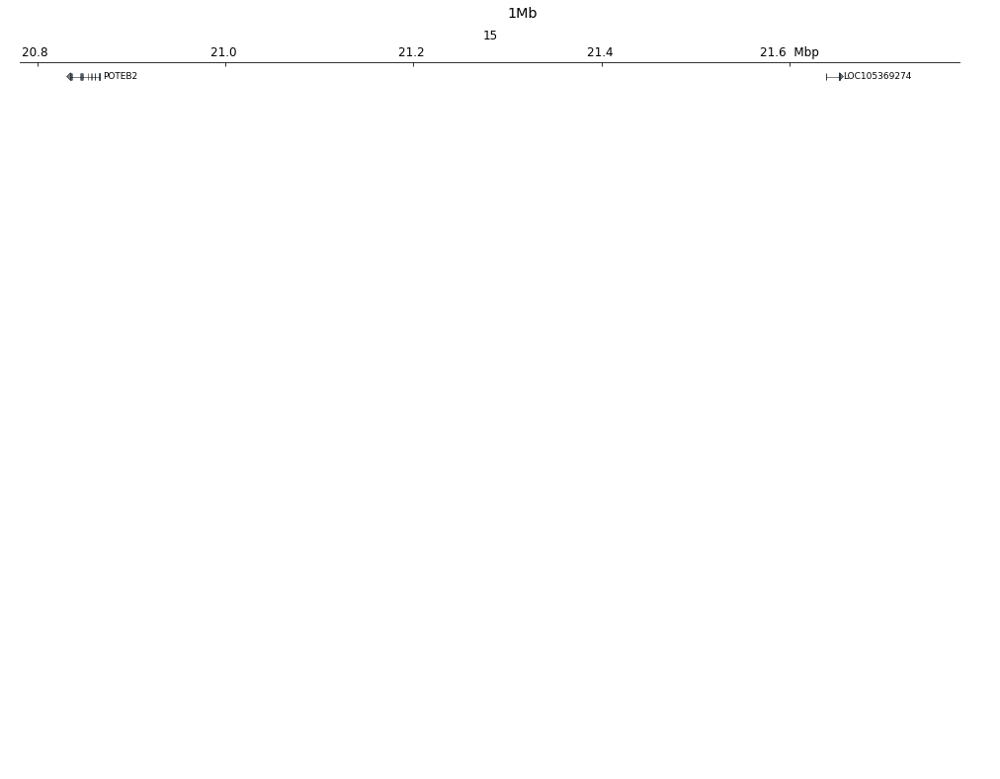


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.8531858921051025
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

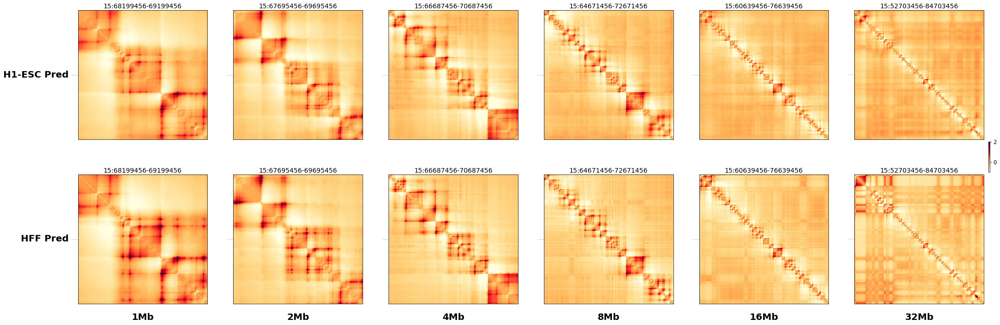

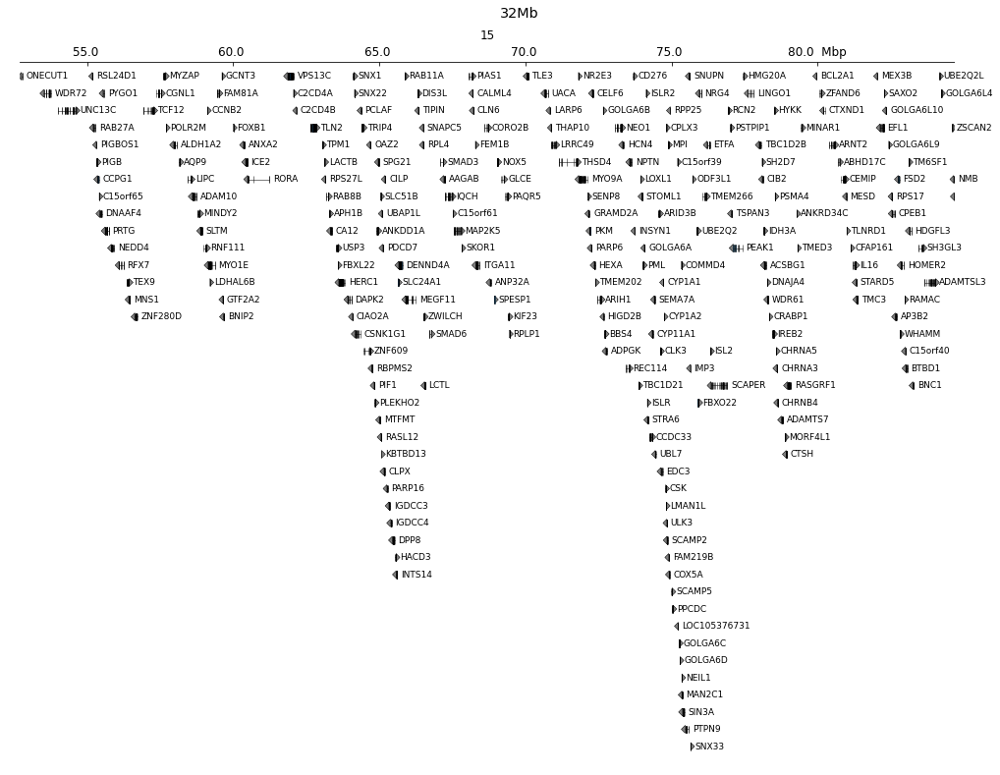

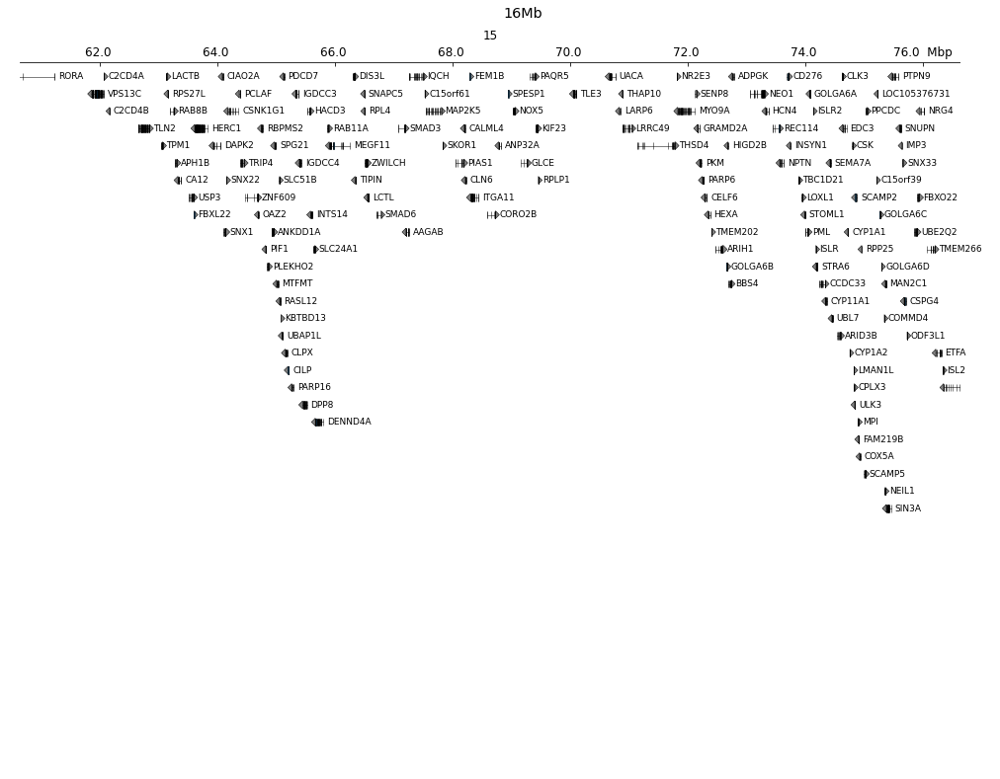

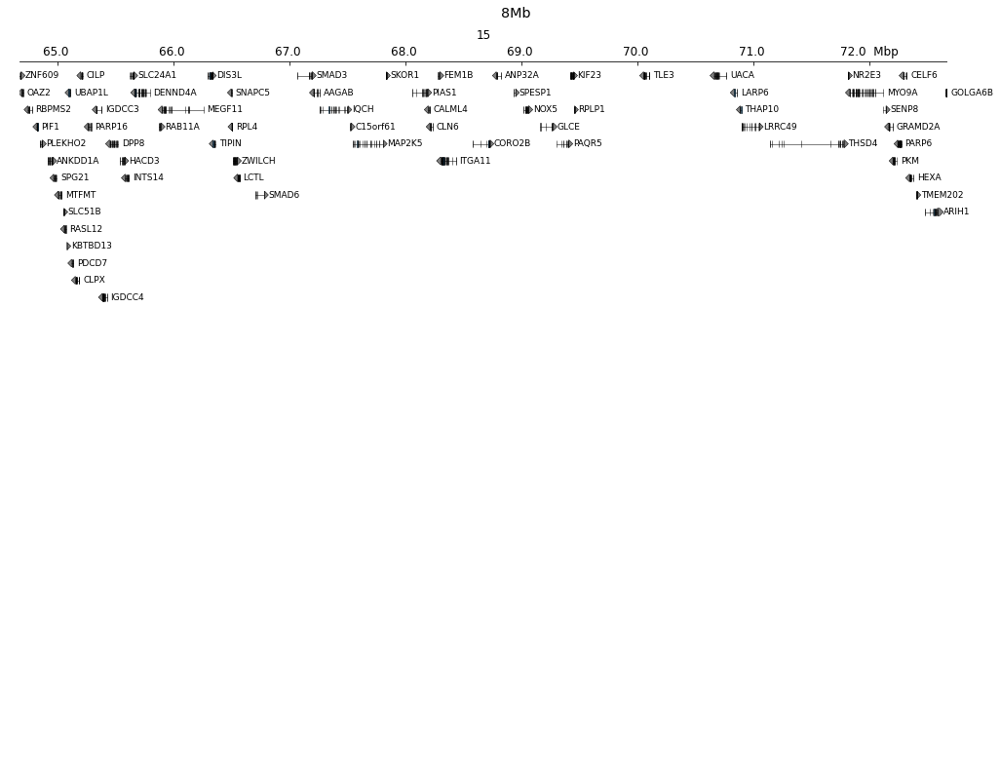

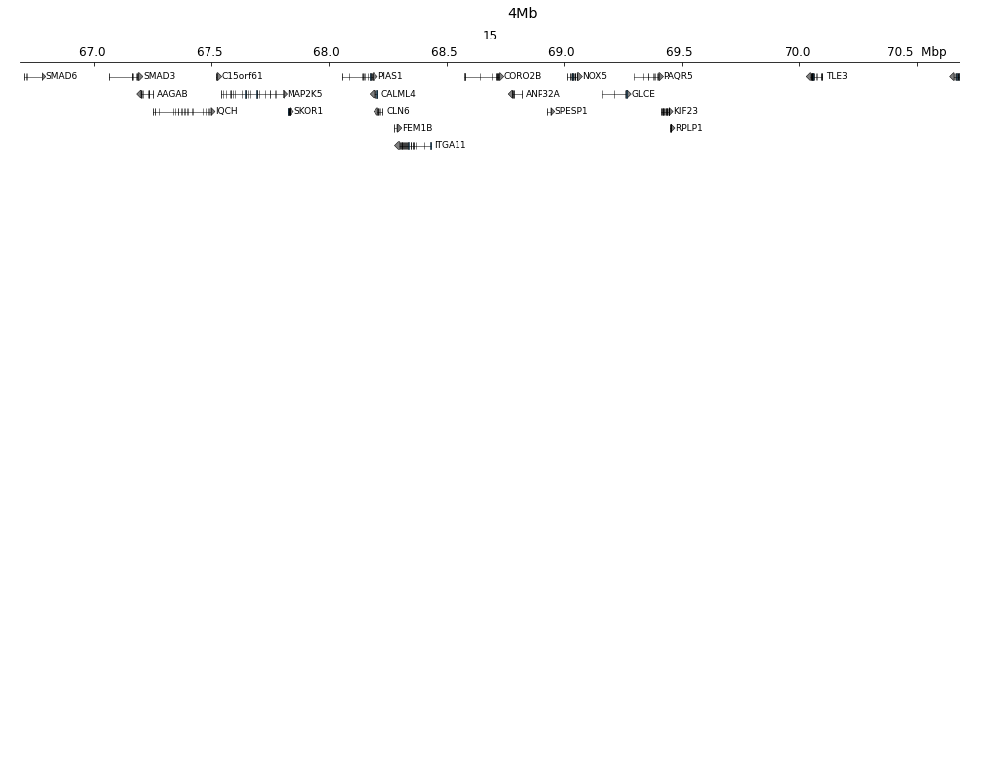

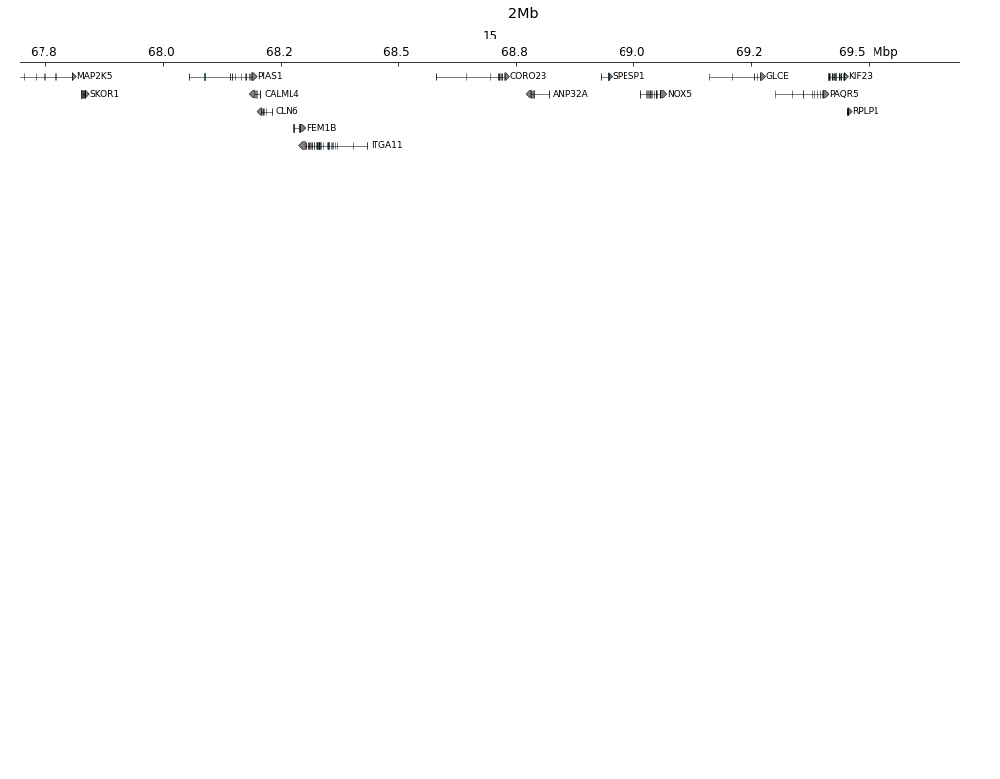

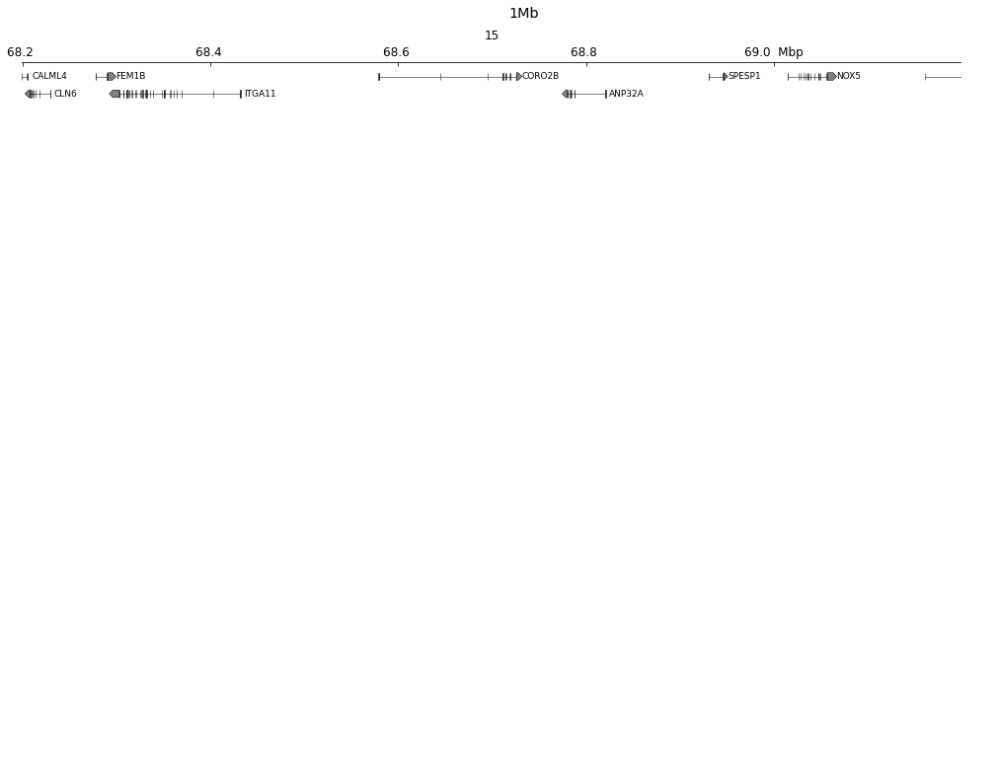


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:2.0739400386810303
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

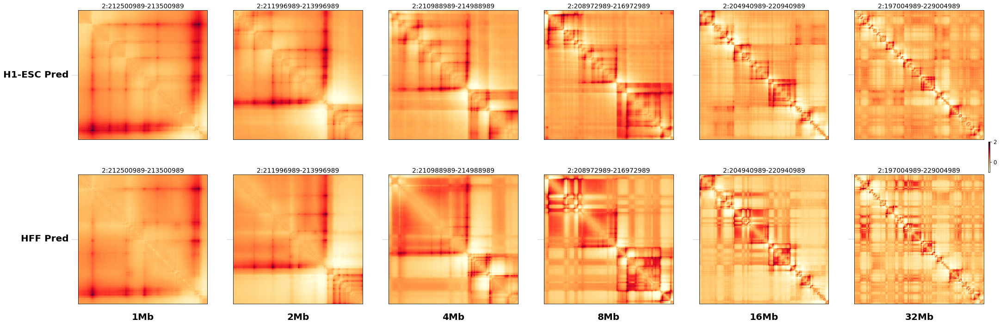

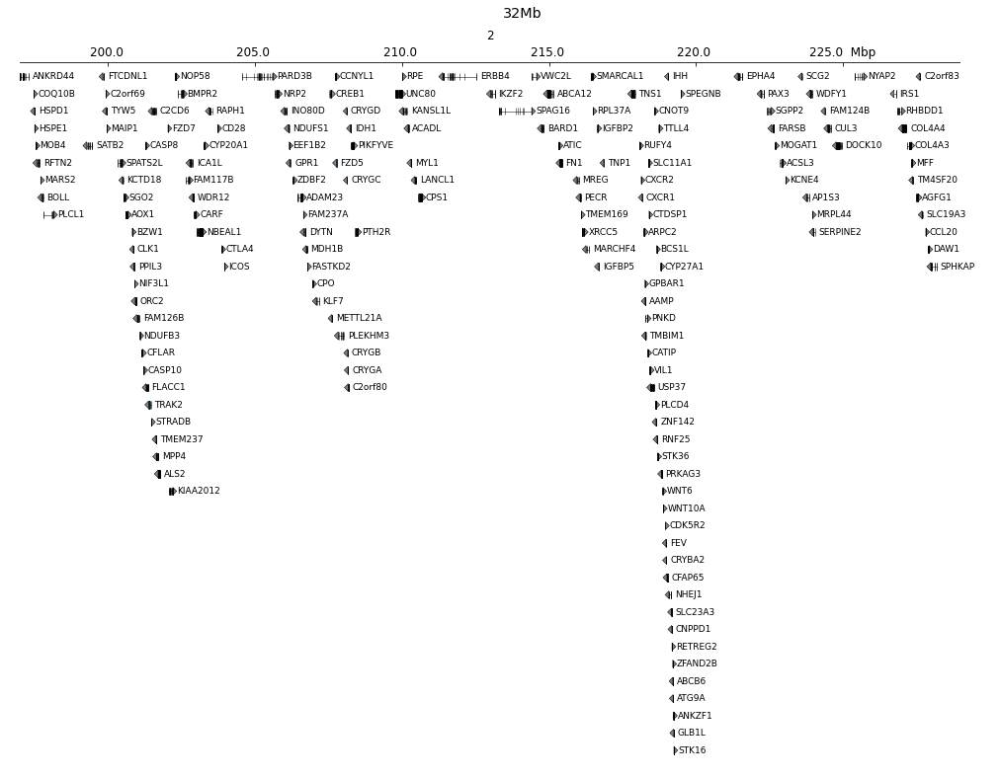

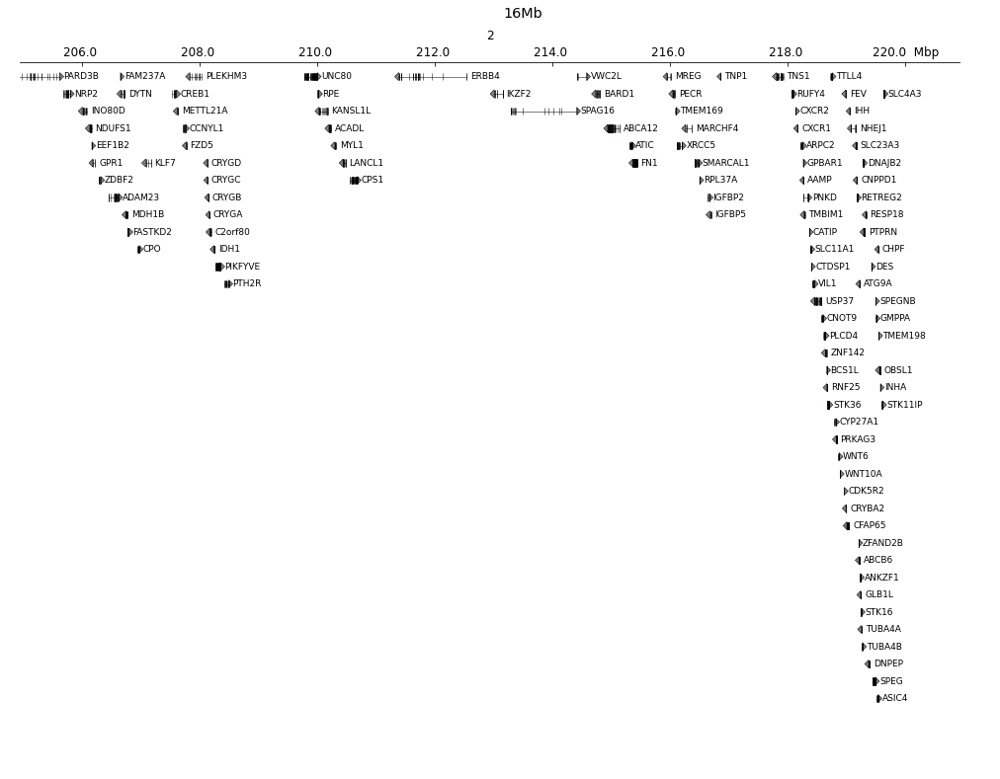

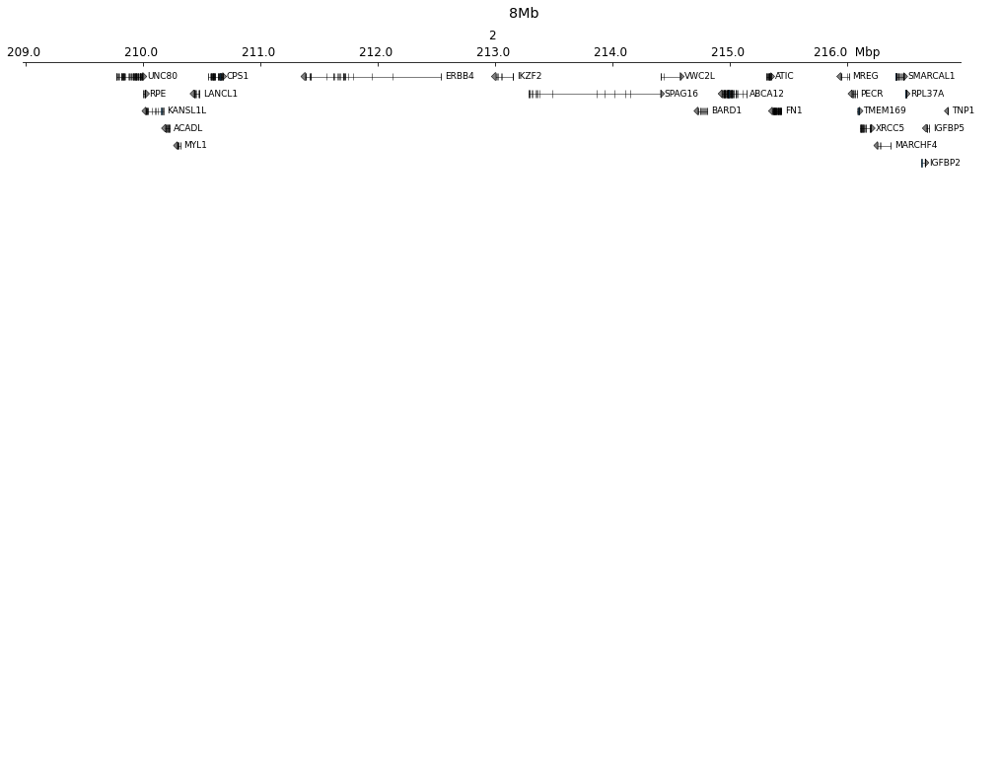

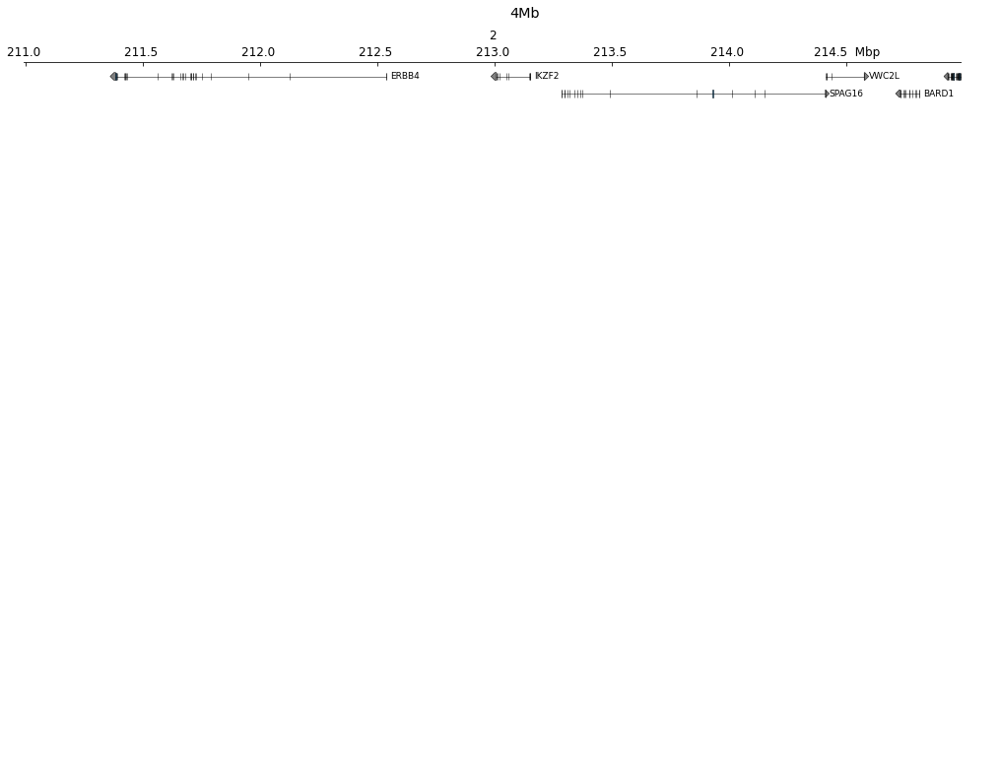

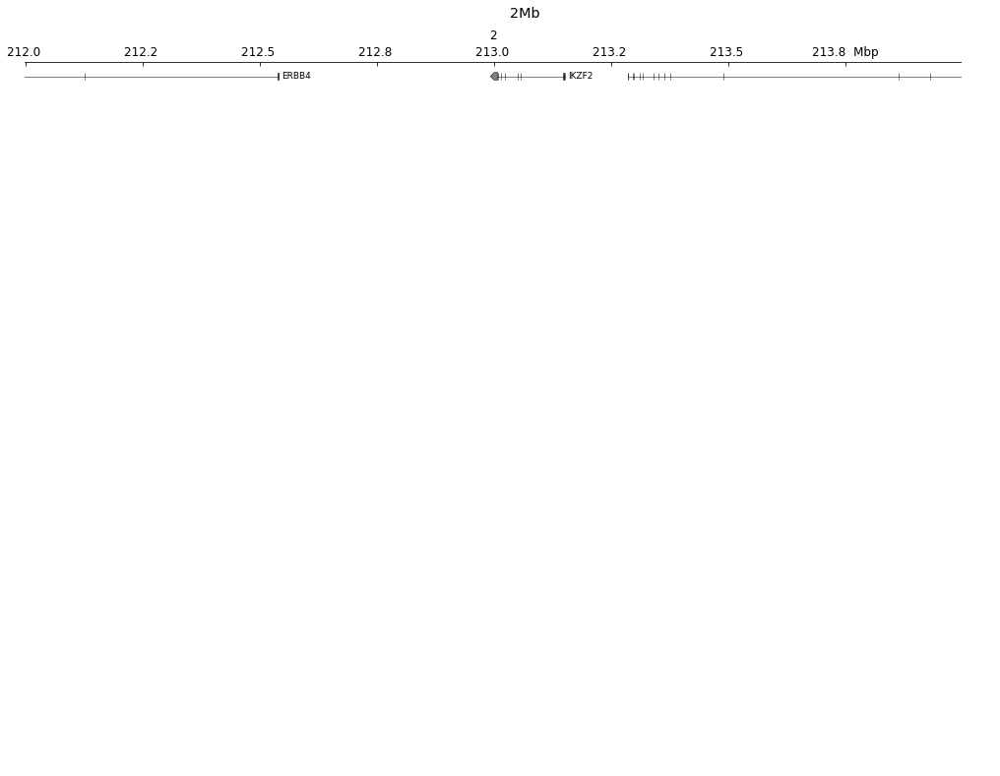

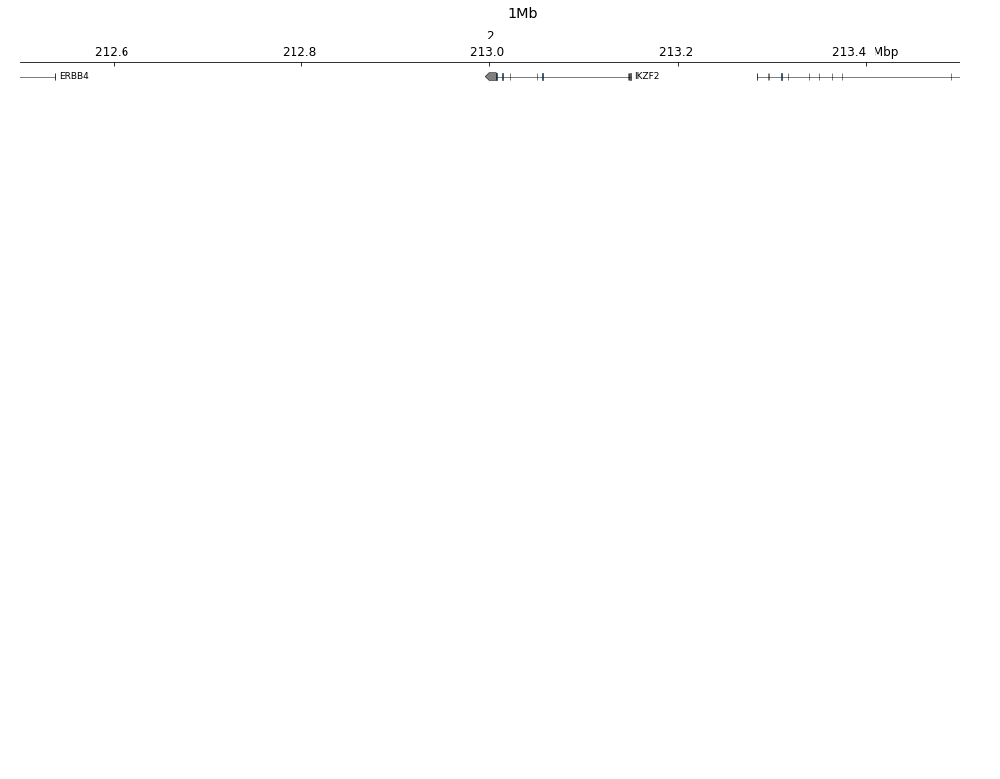


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.4201817512512207
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

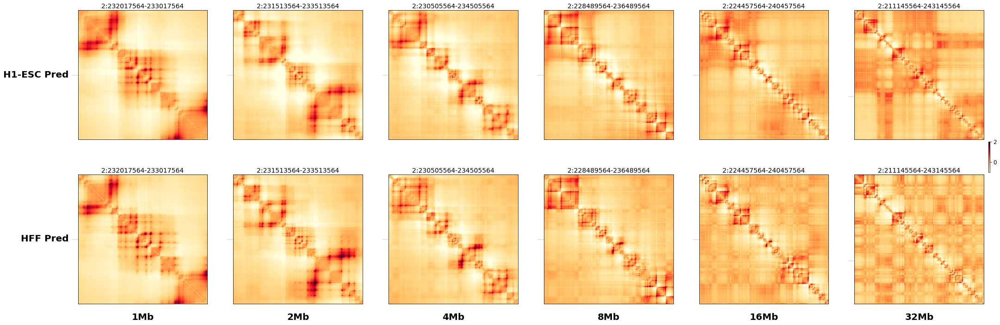

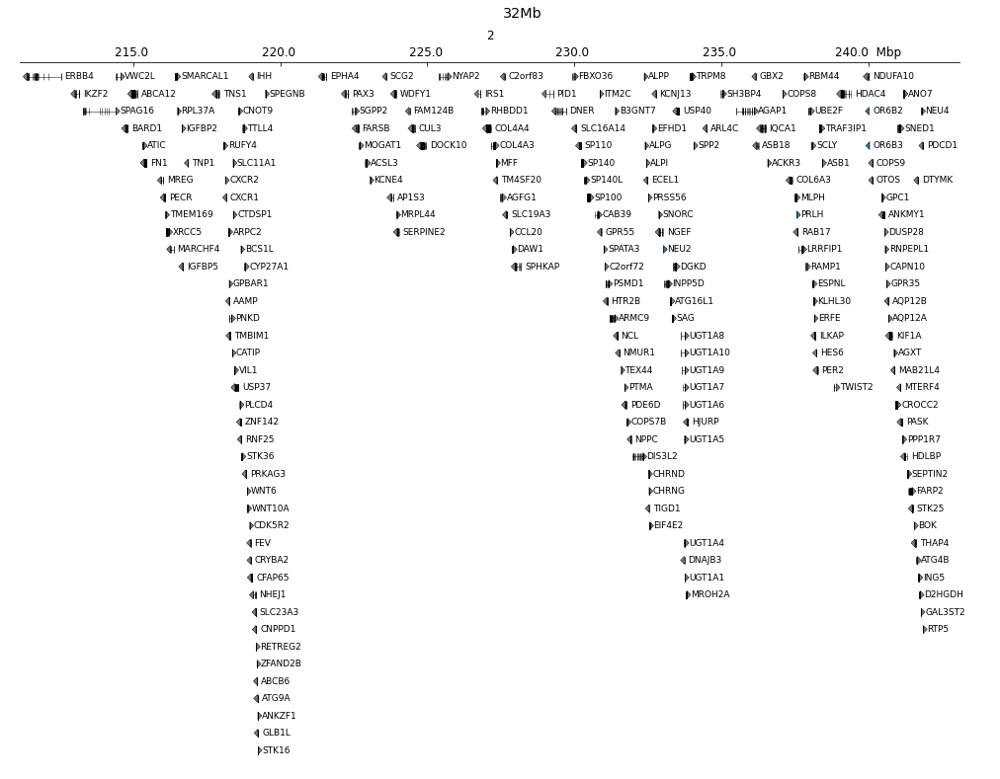

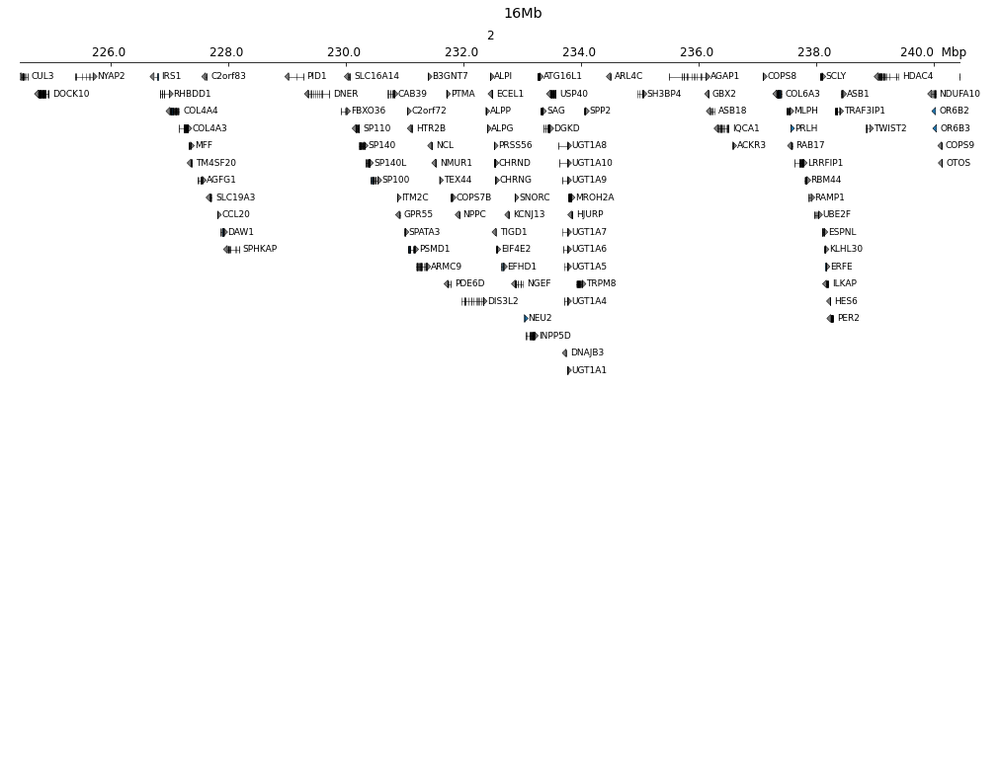

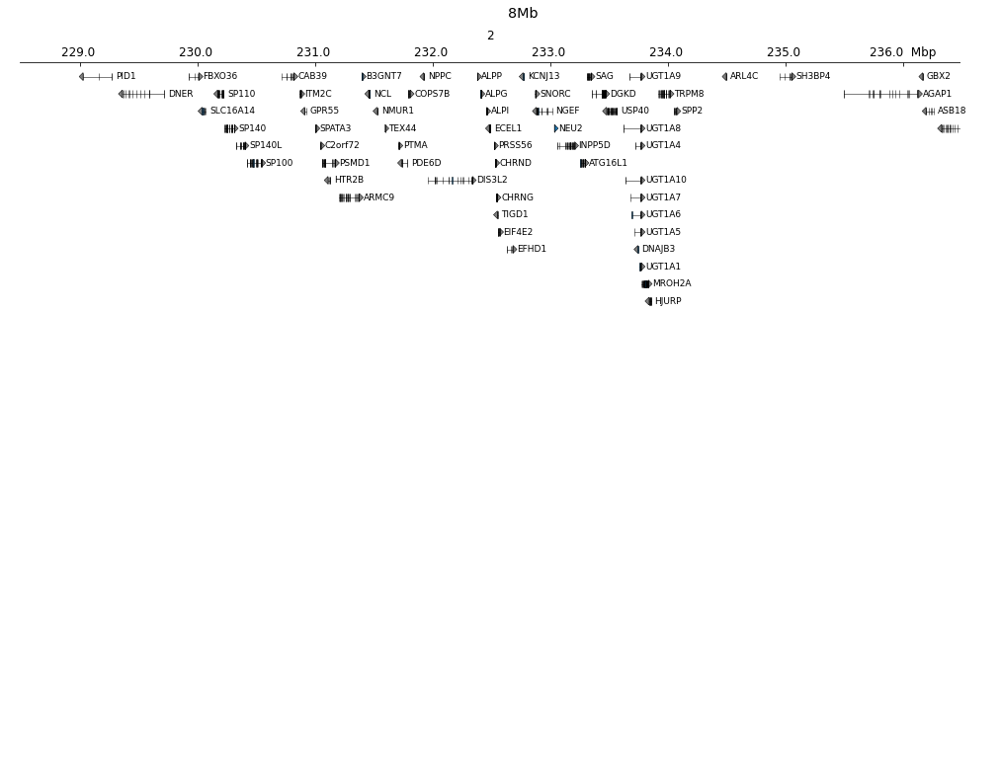

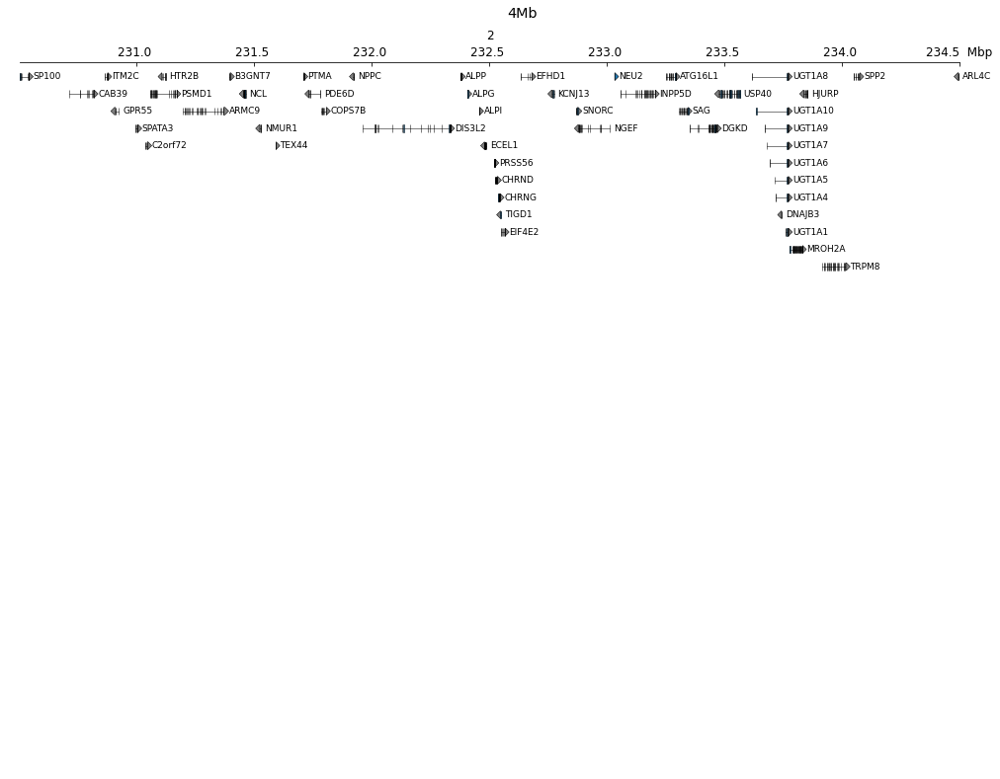

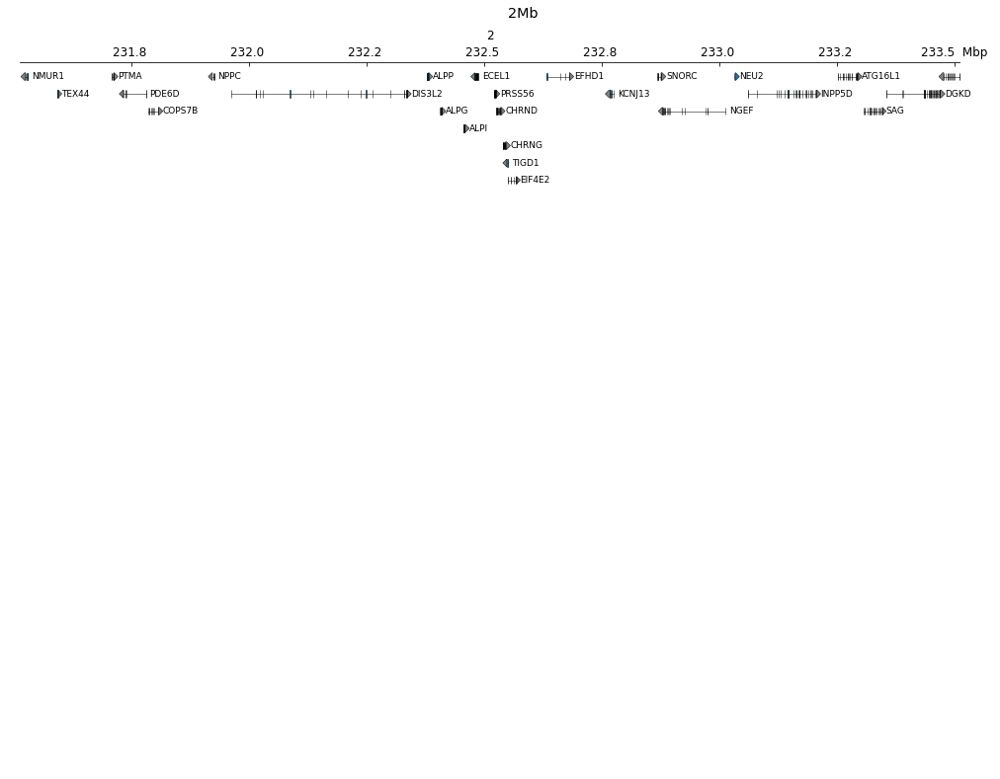

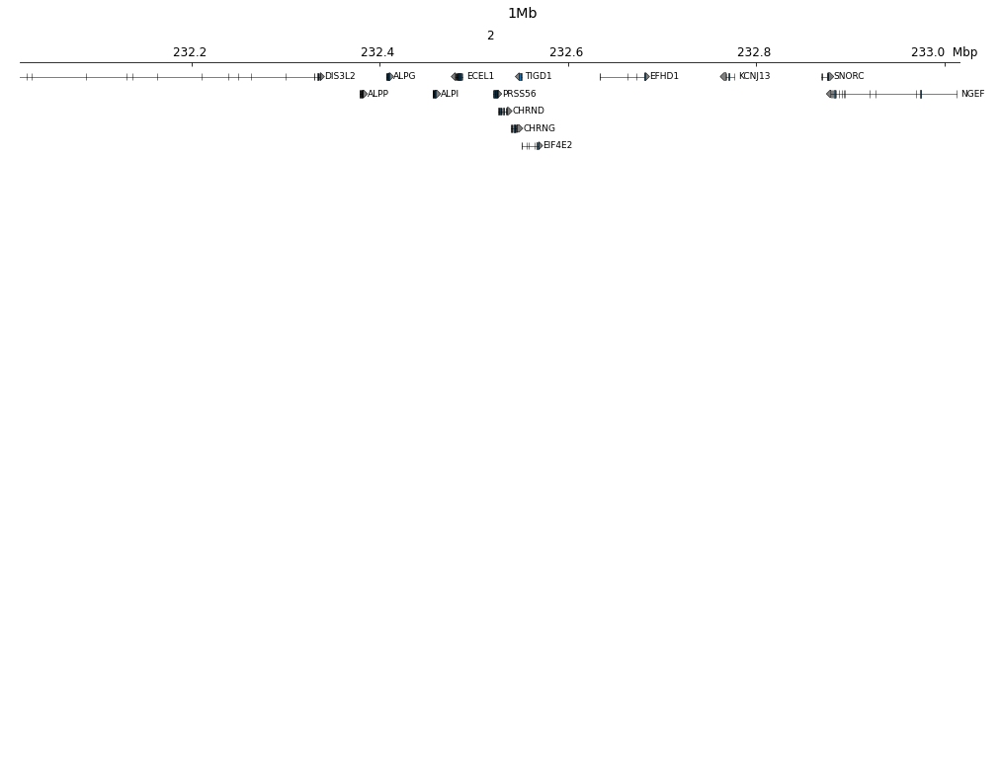


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.438317060470581
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initial

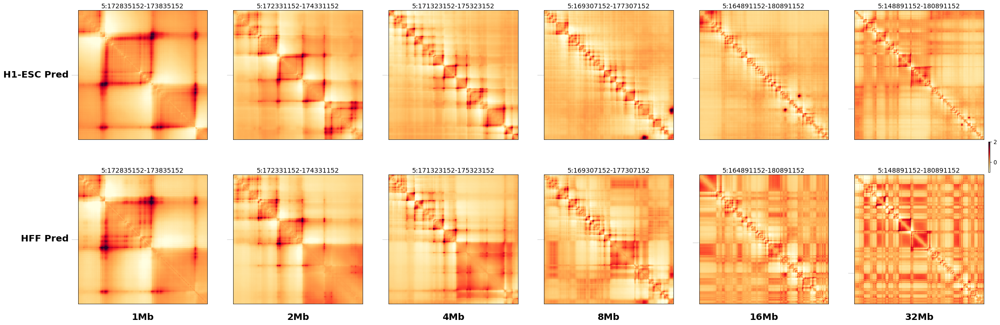

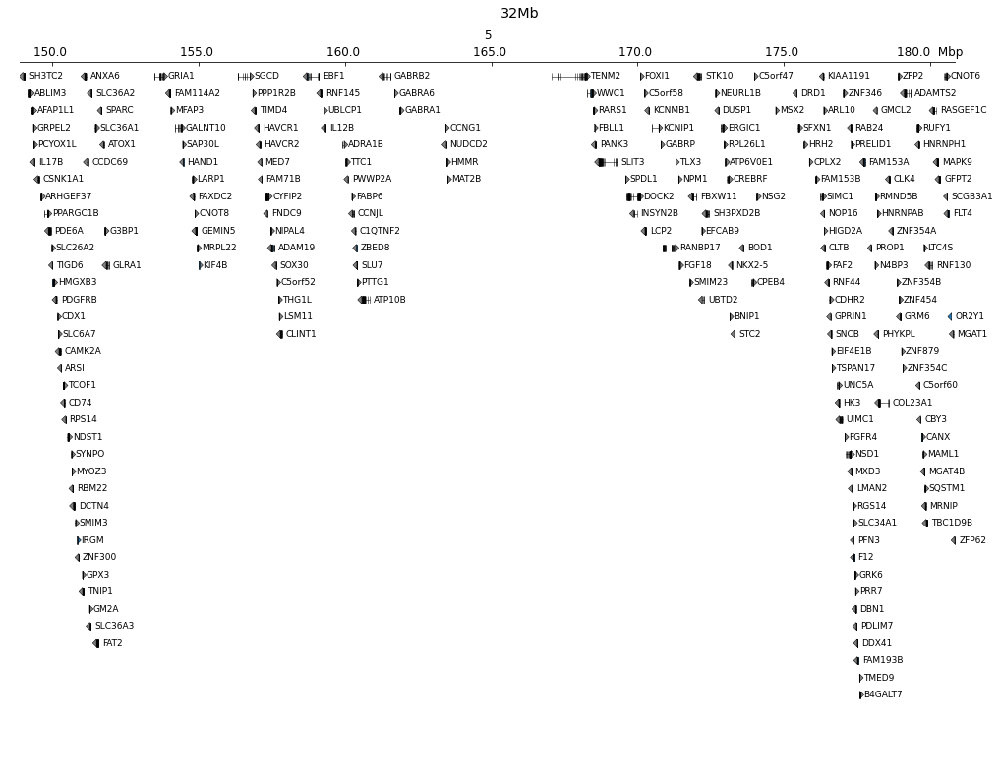

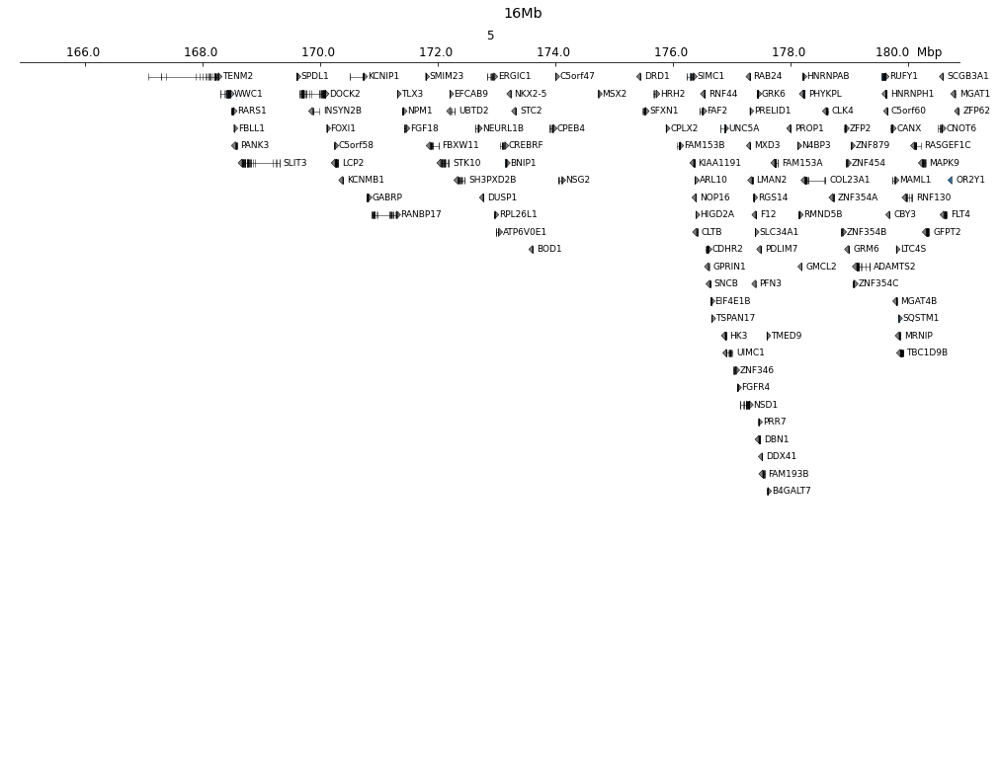

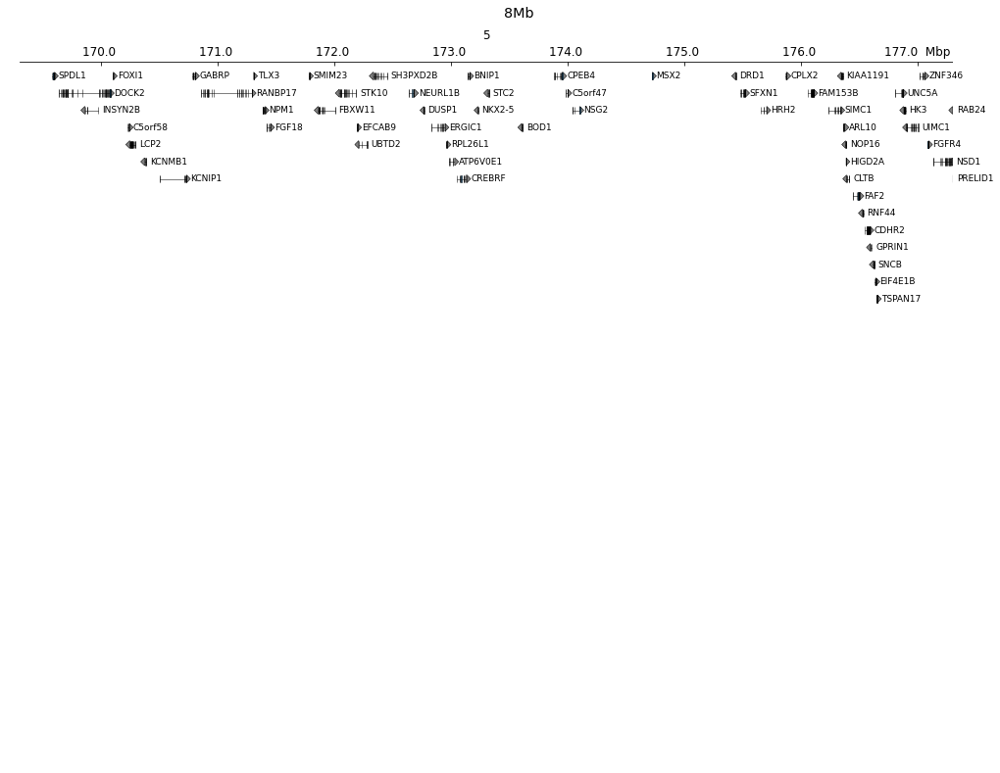

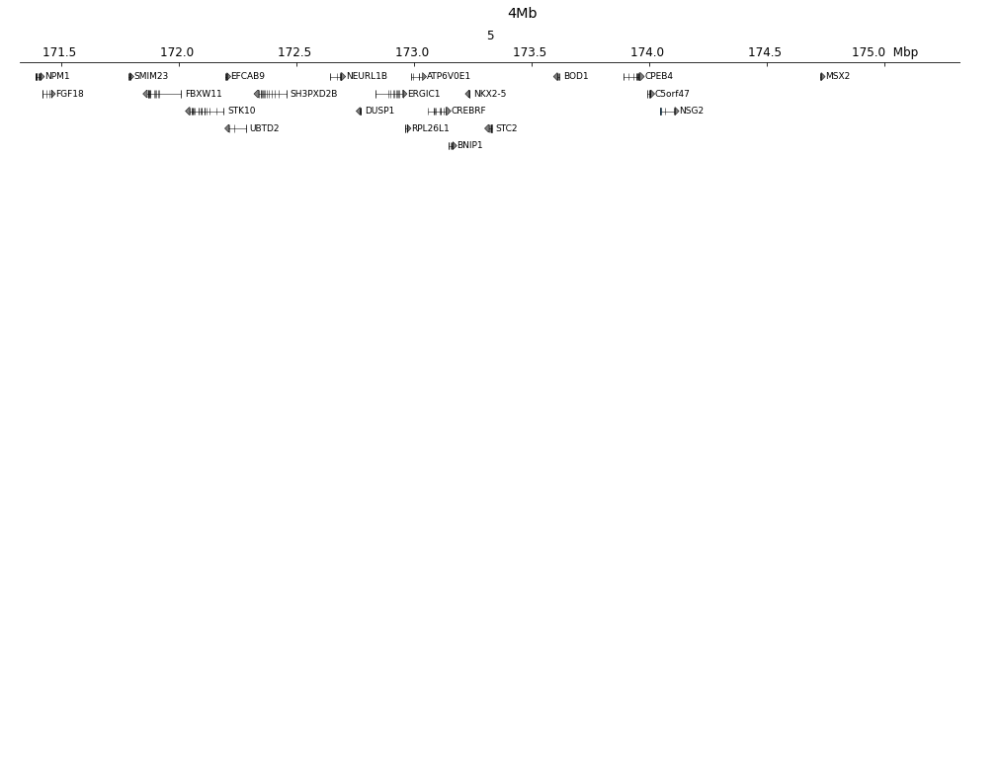

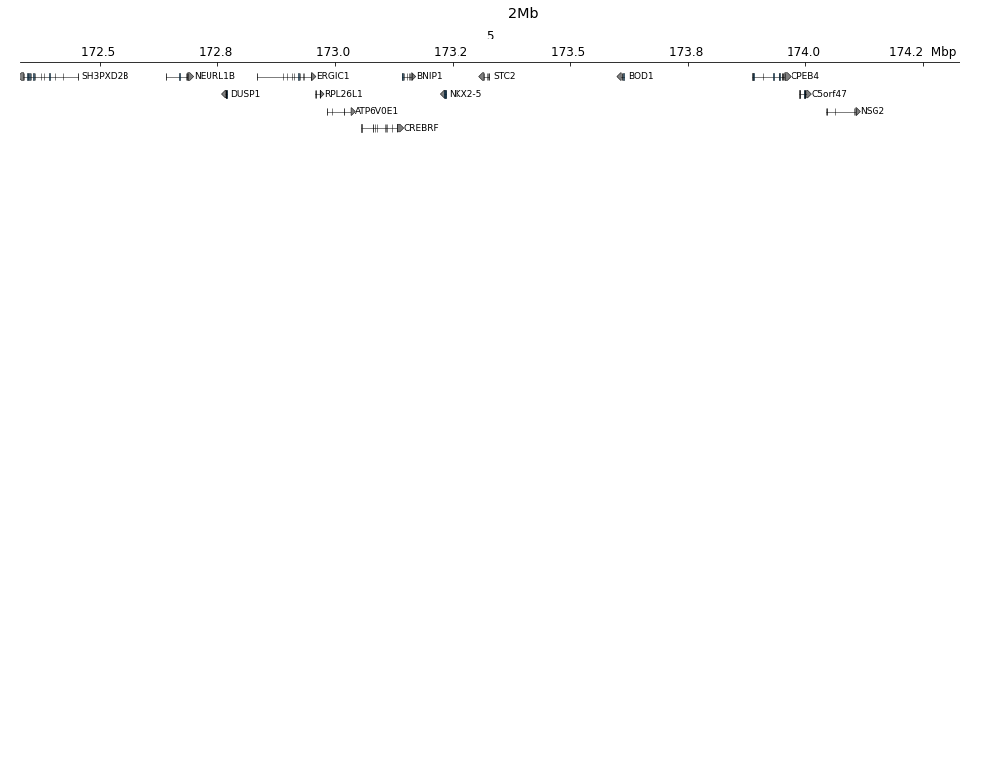

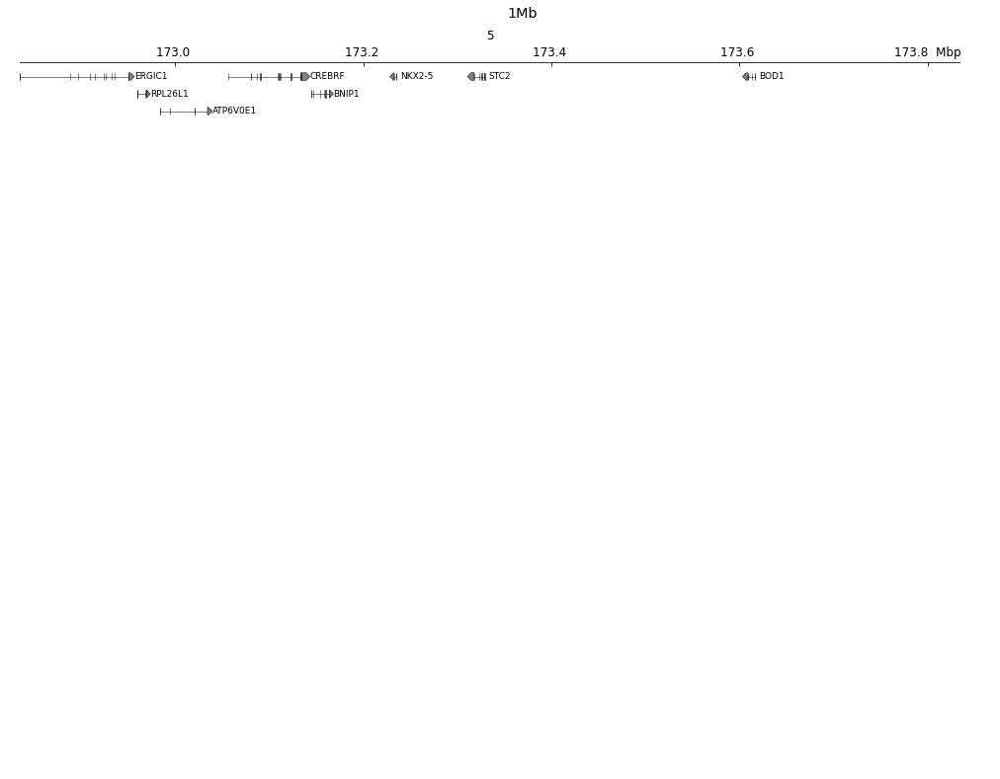


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.606321096420288
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initial

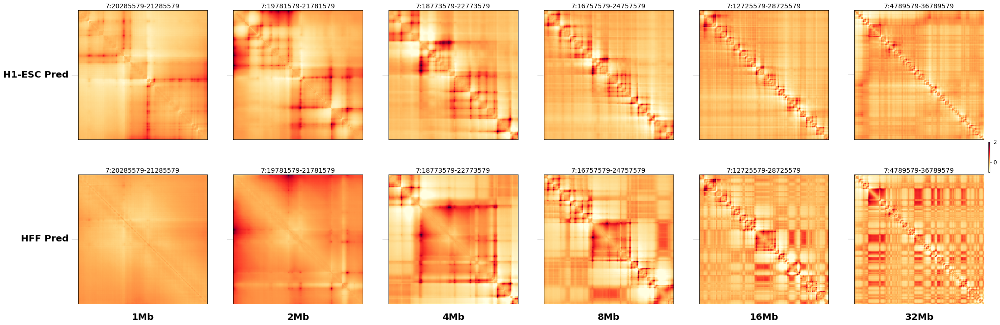

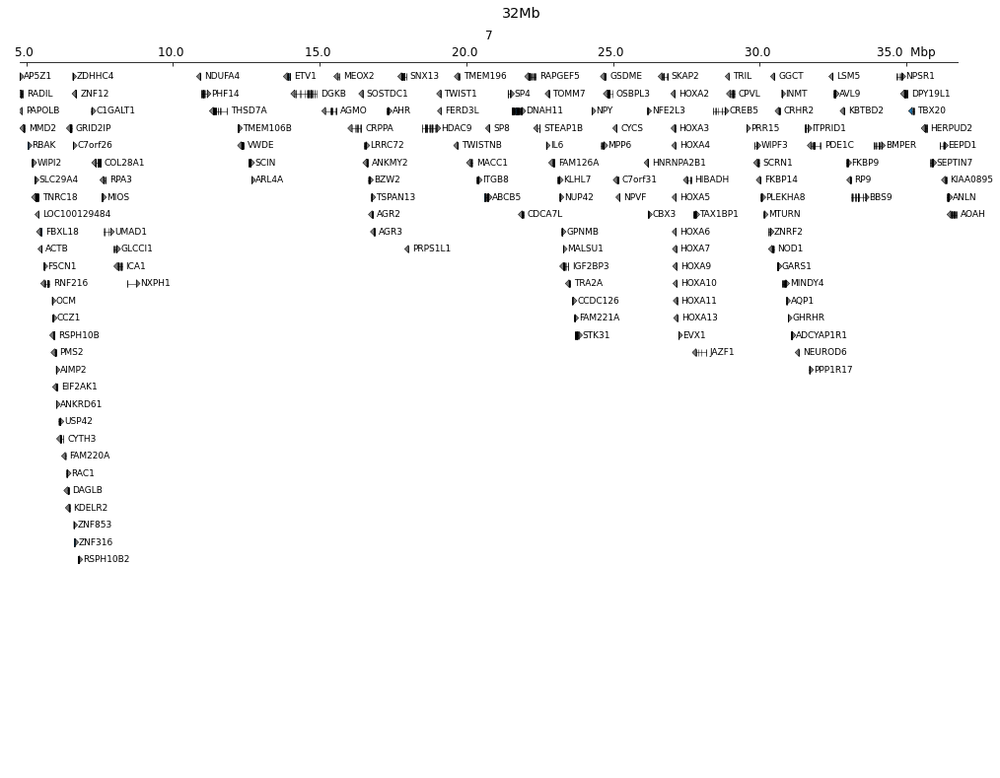

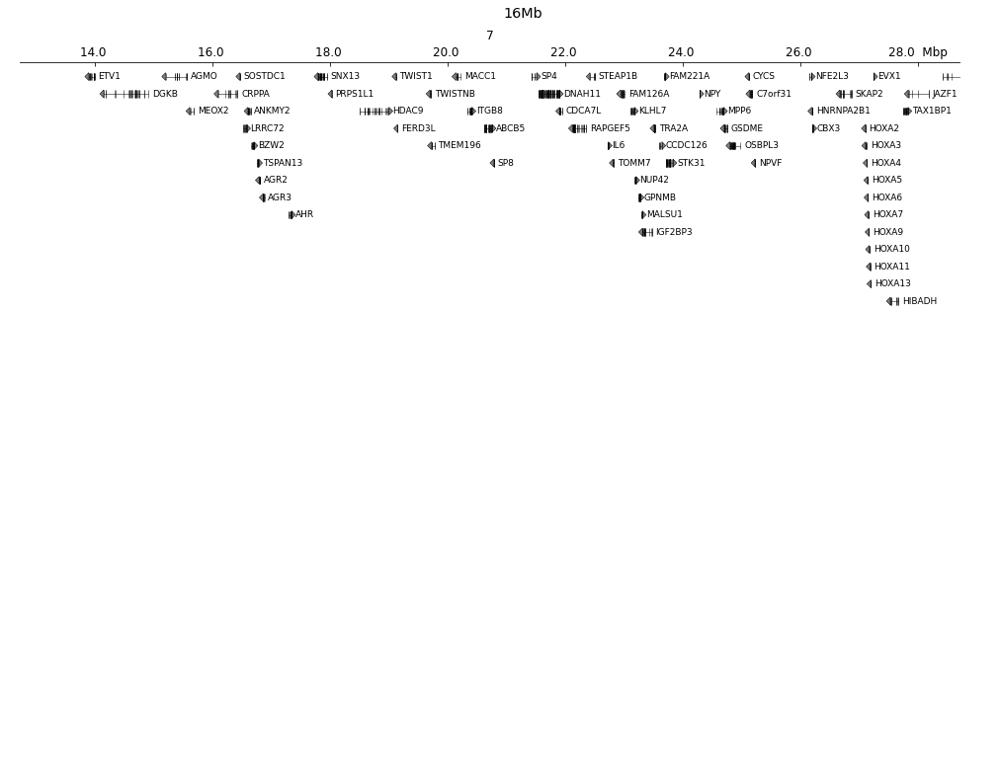

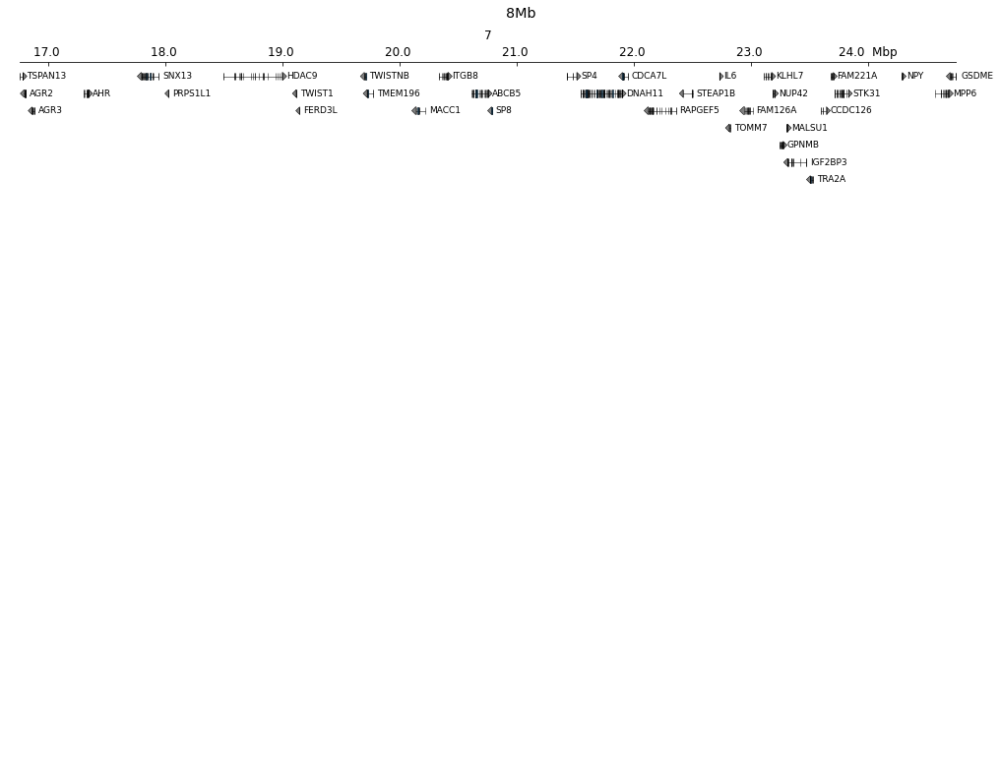

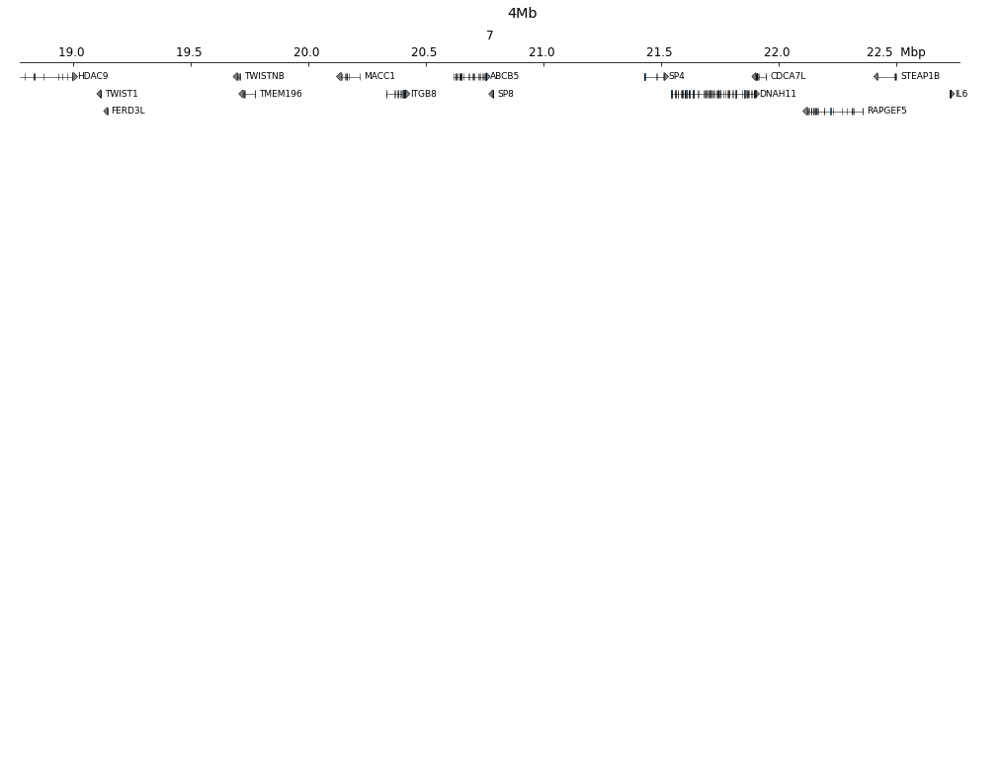

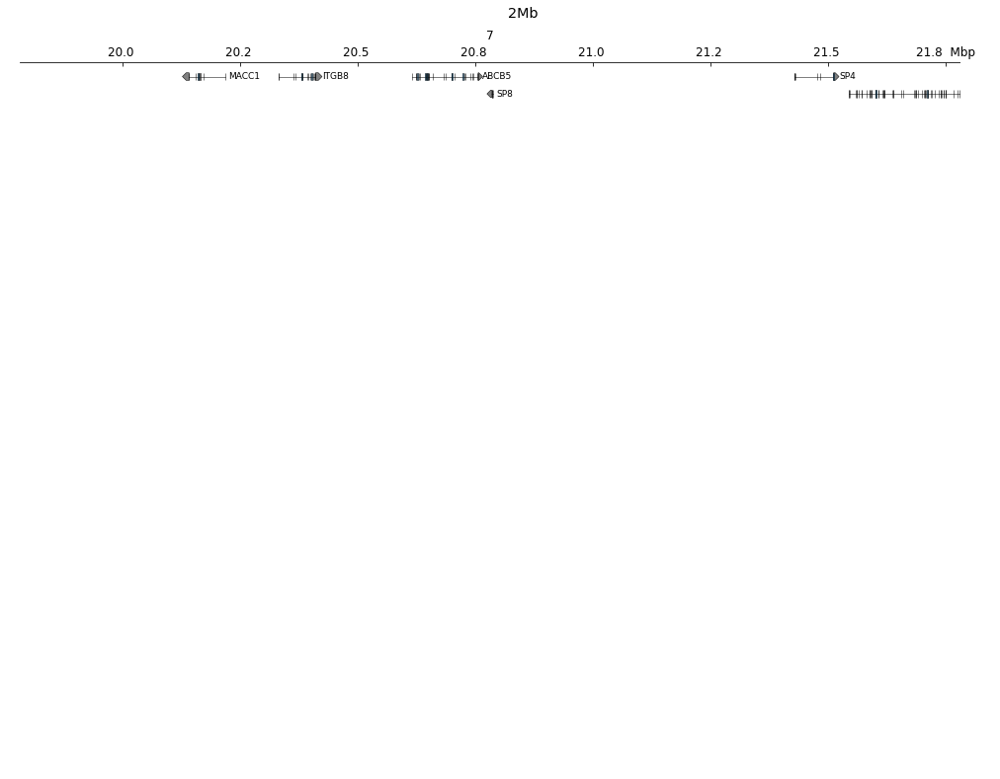

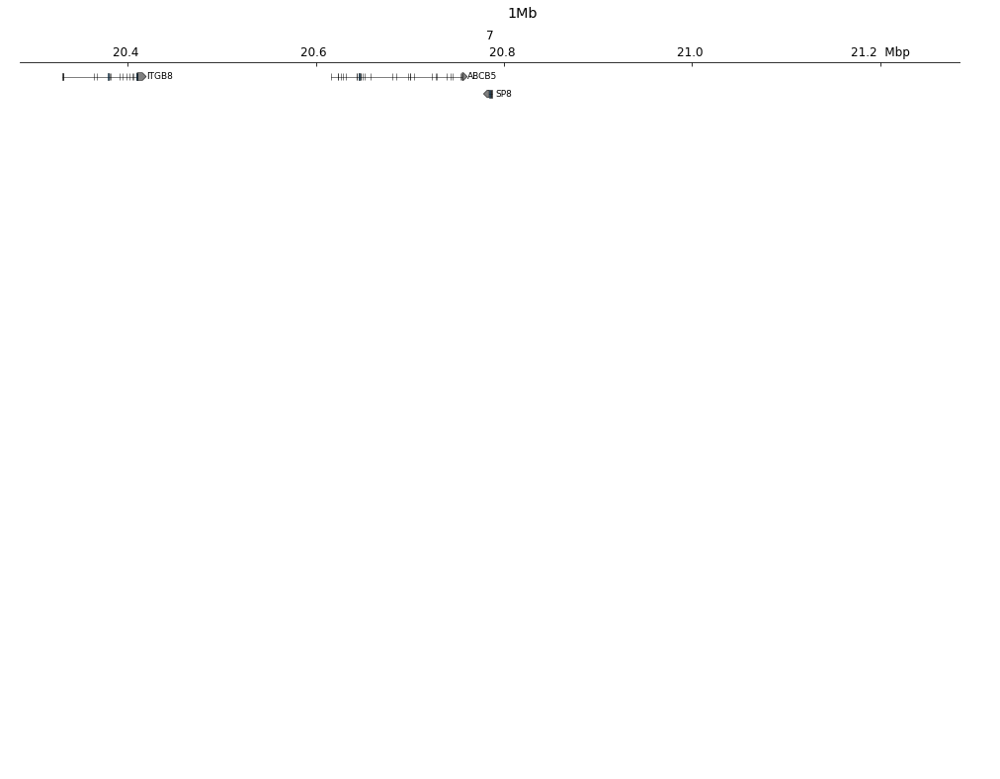


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.8594317436218262
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

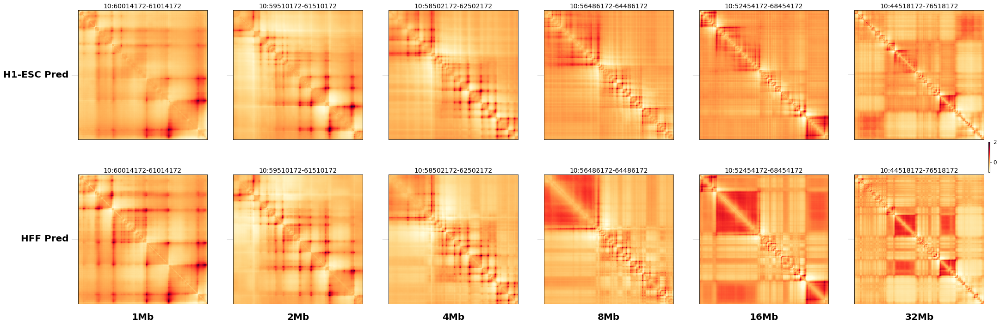

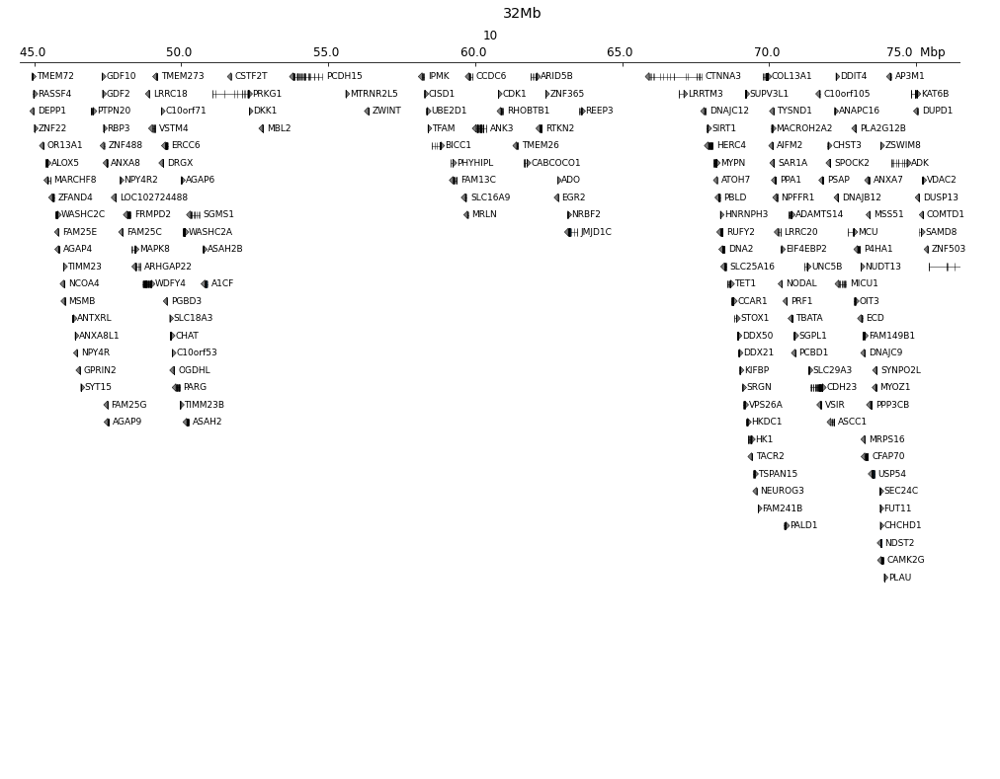

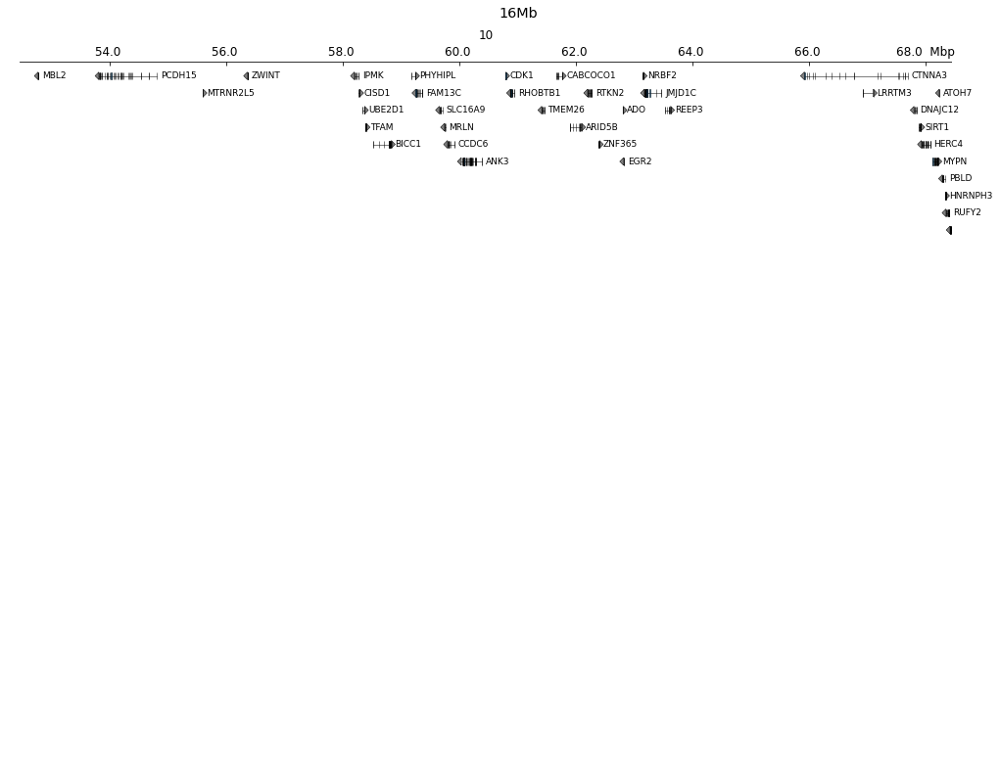

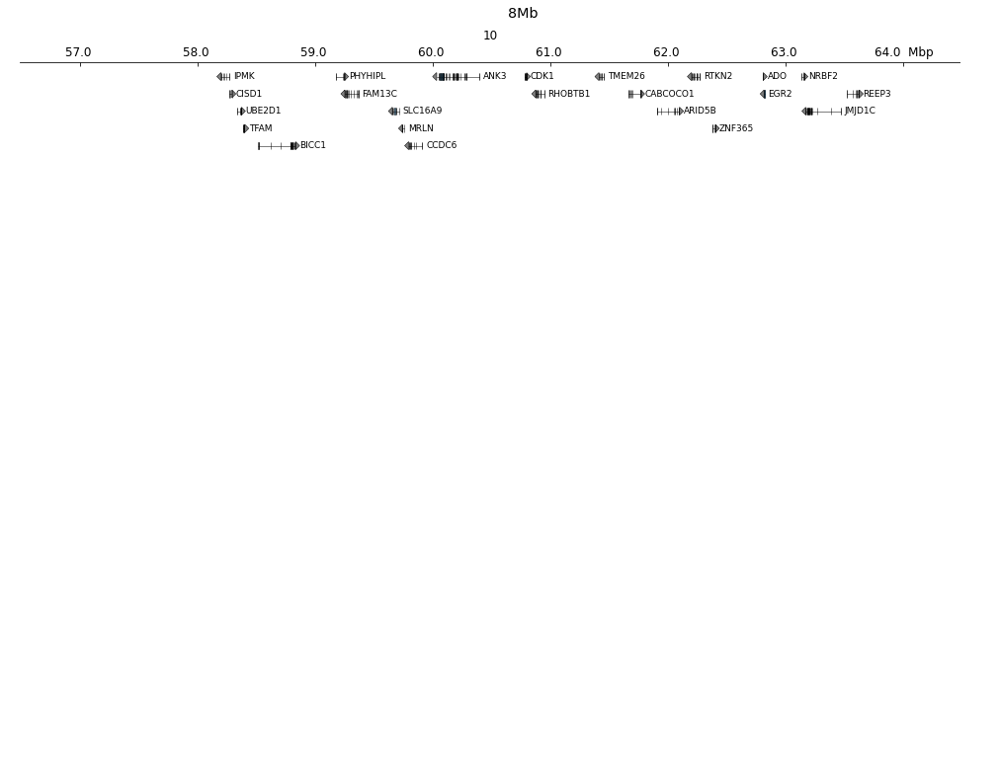

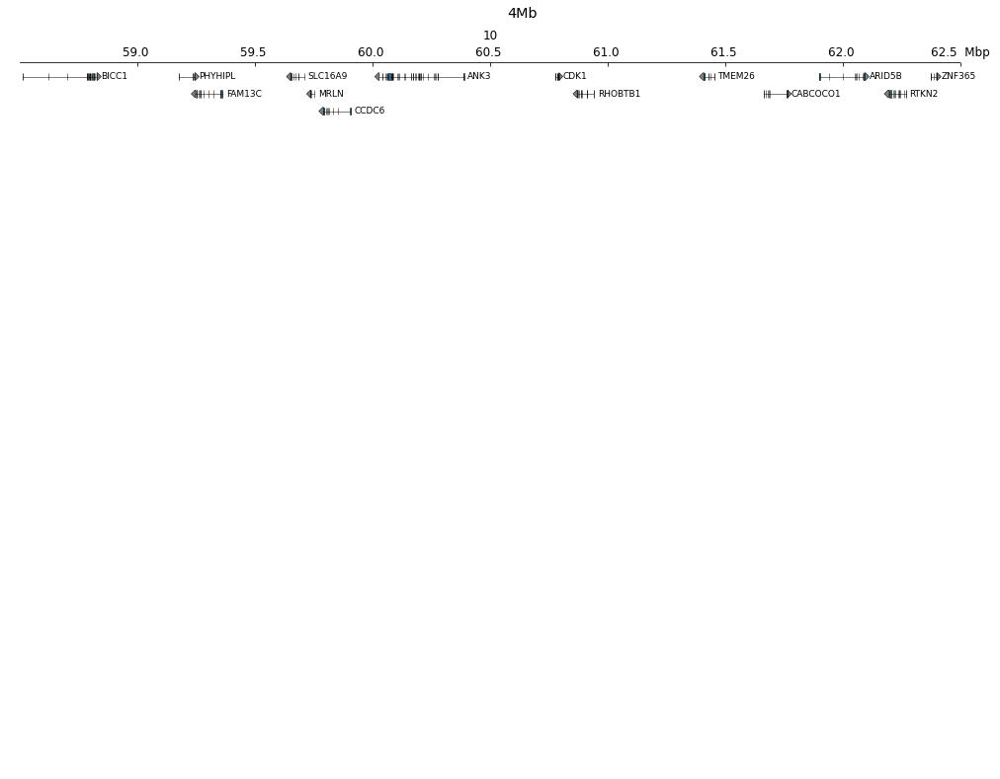

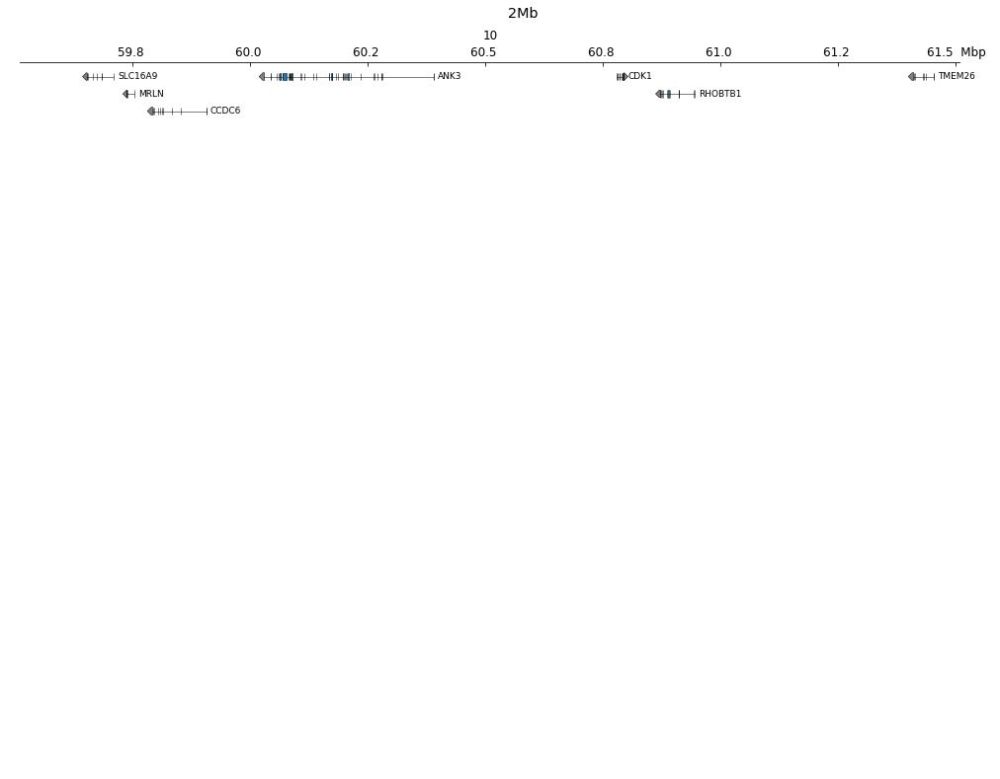

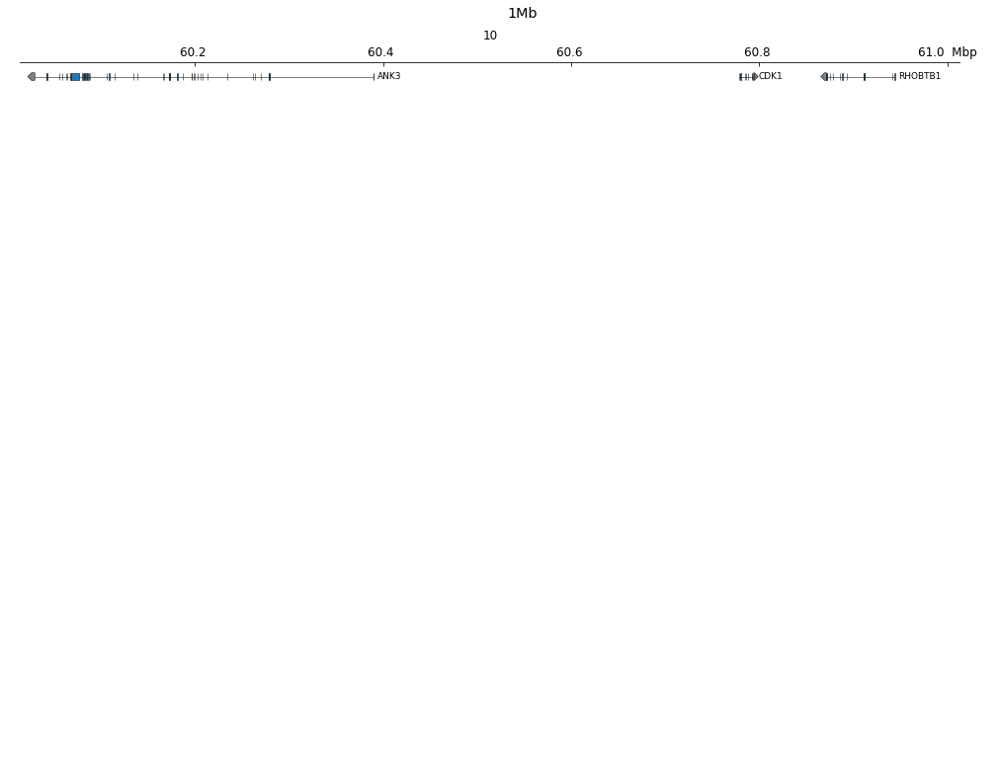


INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initializing track(s):
INFO:pygenometracks.tracksClass:1.8994269371032715
DEBUG:pygenometracks.tracksClass:Figure size in cm is 40.0 x 28.776595744680854. Dpi is set to 10

INFO:pygenometracks.tracksClass:plotting 1. [spacer]
INFO:pygenometracks.tracksClass:plotting 2. [x-axis]
INFO:pygenometracks.tracksClass:plotting 3. [spacer]
INFO:pygenometracks.tracksClass:plotting 4. [test gtf collapsed]
DEBUG:pygenometracks.tracks.GenomeTrack:ylim 93.08,-0.08

INFO:pygenometracks.tracksClass:initialize 1. [spacer]
INFO:pygenometracks.tracksClass:initialize 2. [x-axis]
INFO:pygenometracks.tracksClass:initialize 3. [spacer]
INFO:pygenometracks.tracksClass:initialize 4. [test gtf collapsed]
INFO:pygenometracks.tracksClass:time initia

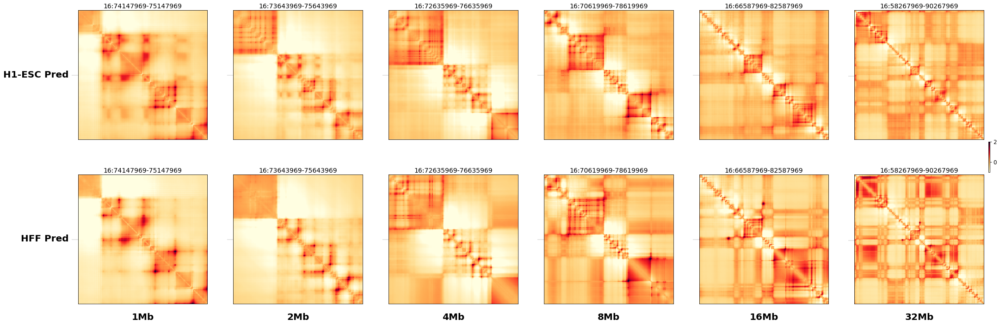

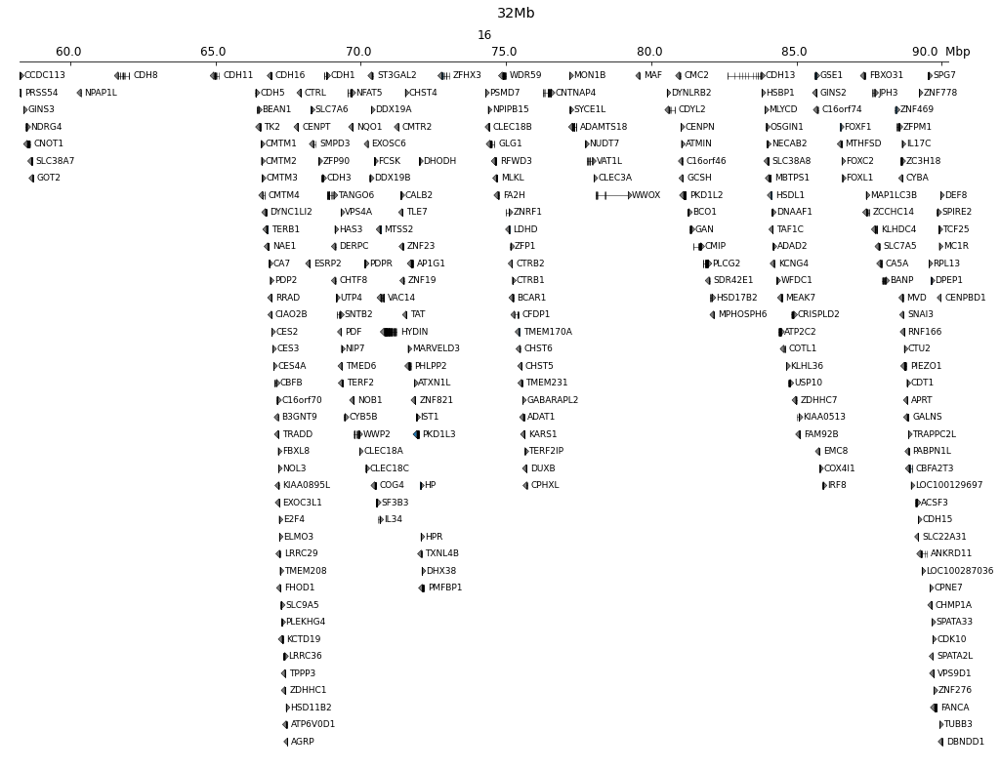

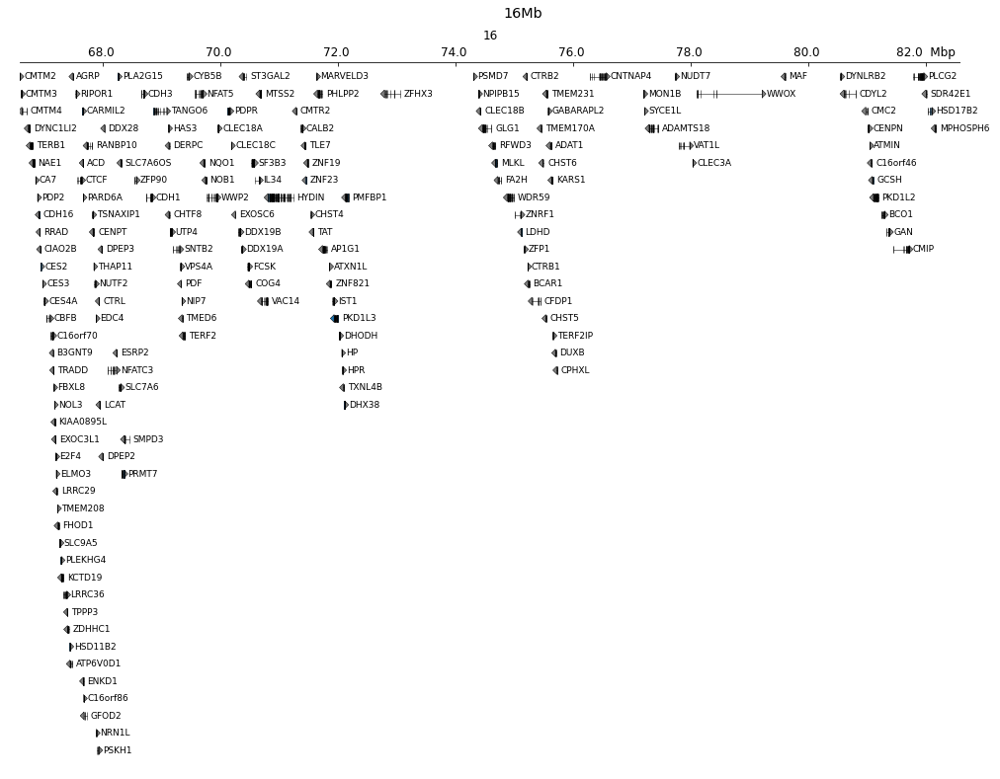

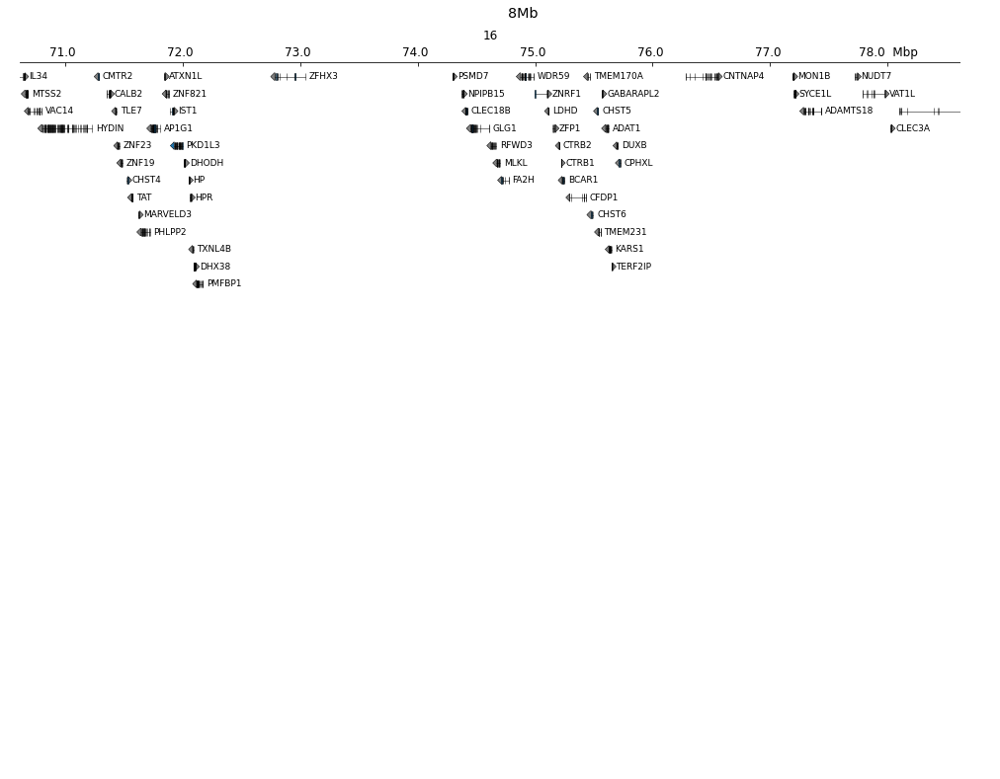

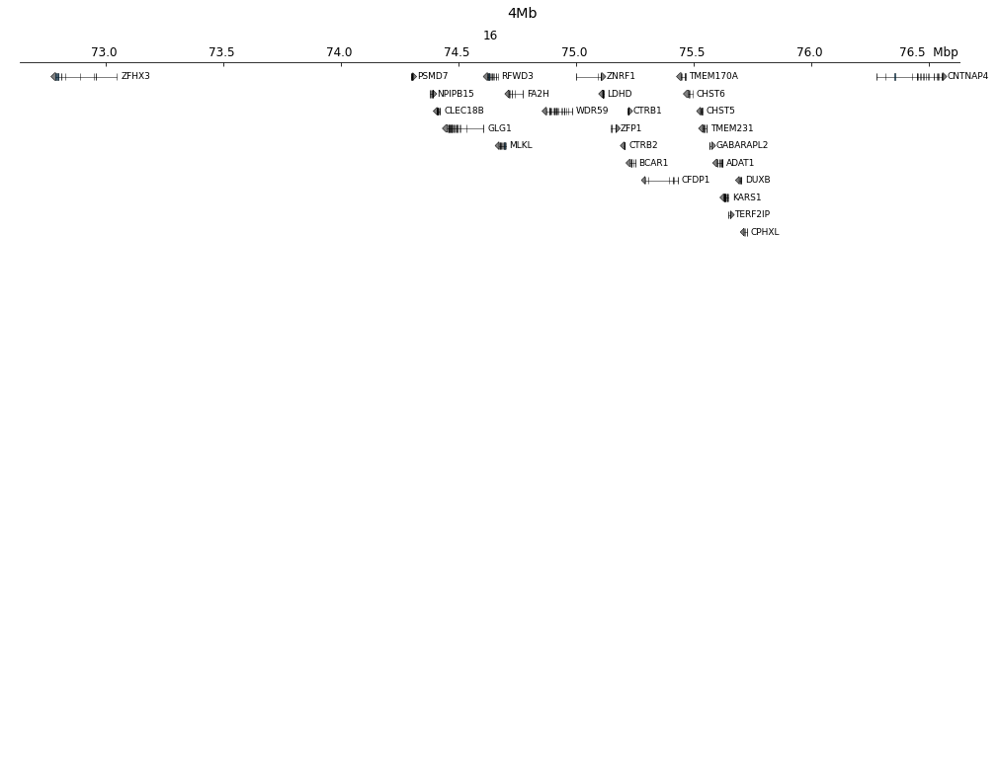

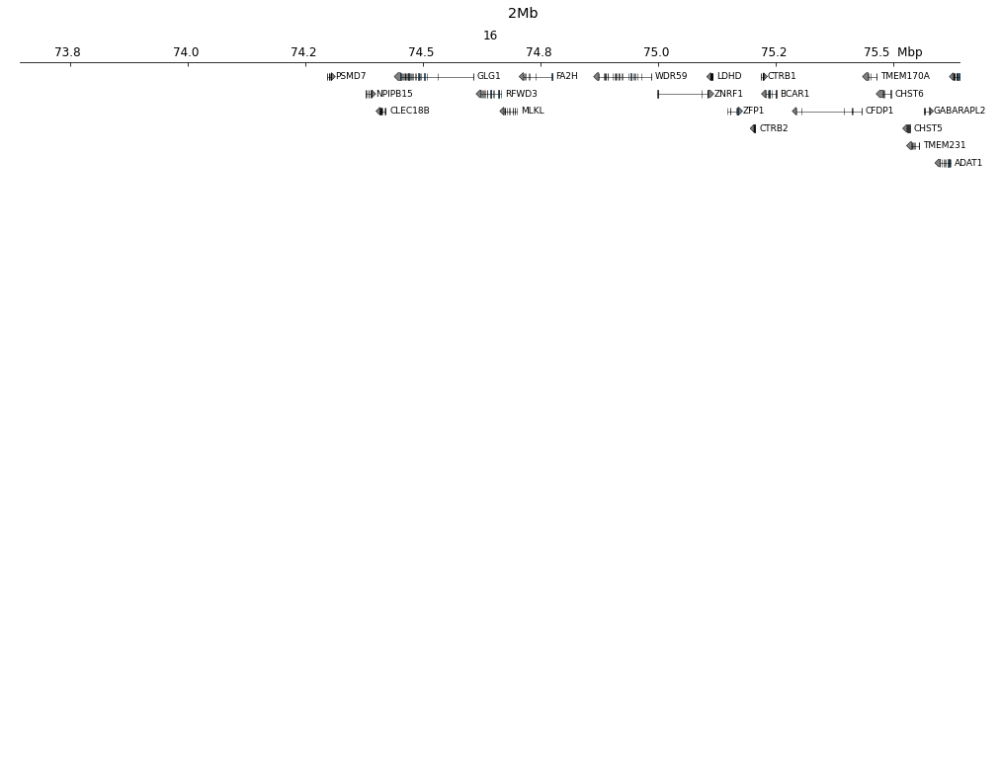

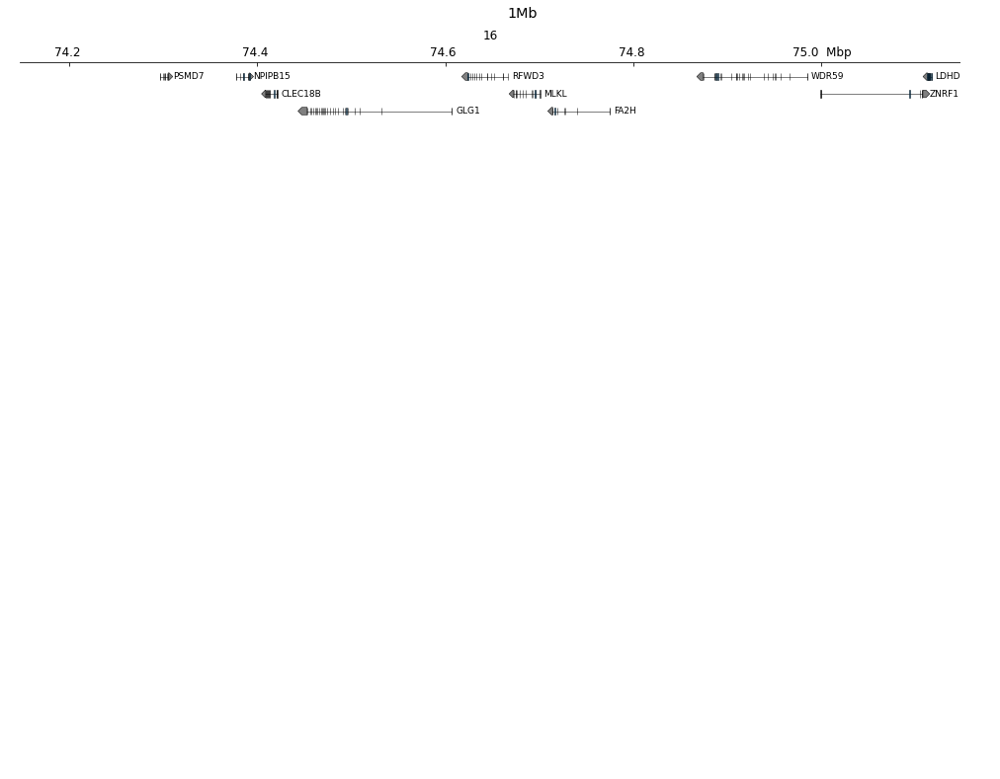




  method         from 
  [.quosures     rlang
  c.quosures     rlang
  print.quosures rlang





In [11]:
#generate predictions and prediction plots
all_outputs_ref = []
all_outputs_alt_l = []
all_outputs_alt_r = []
for i in range(sites.shape[0]):
    outputs_ref, outputs_alt_l, outputs_alt_r = \
        process_ins(sites[0][i].replace('chr',''), sites[1][i], str(seq), hg19, target=False,
                    strand=sites[2][i], file='./svs_ins/psa-mcs-2kb_gb_Supplementary.gb.sites.'+sites[3][i])
    all_outputs_ref.append(outputs_ref)
    all_outputs_alt_l.append(outputs_alt_l)
    all_outputs_alt_r.append(outputs_alt_r)

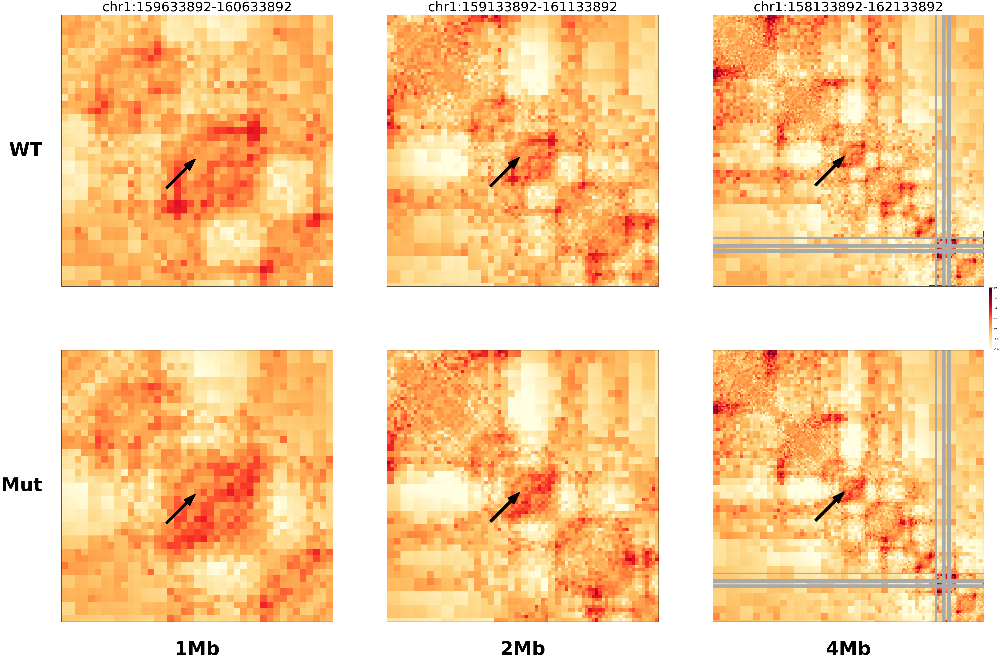

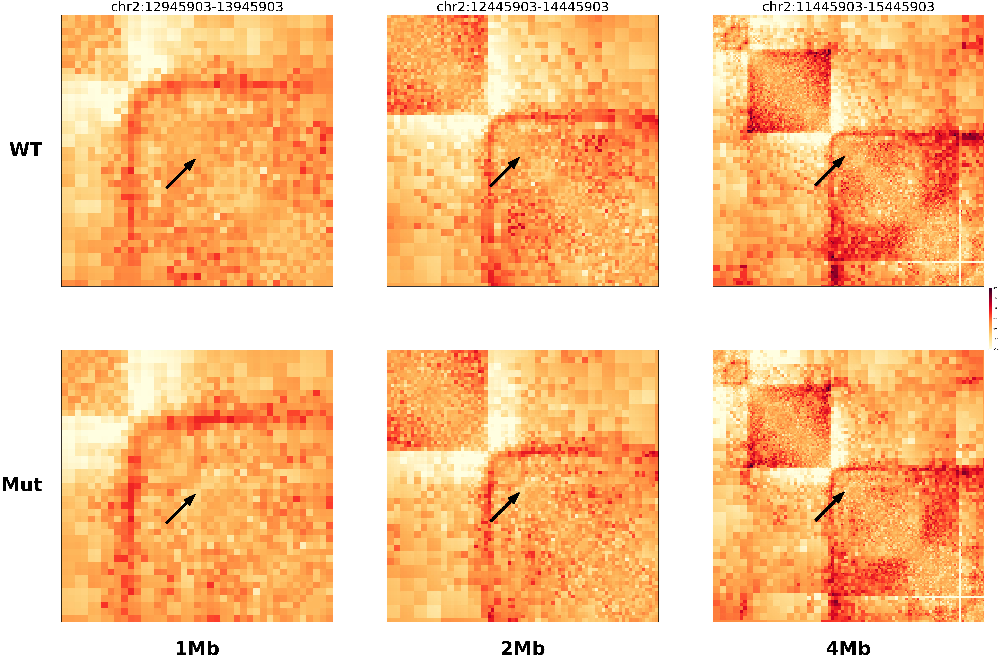

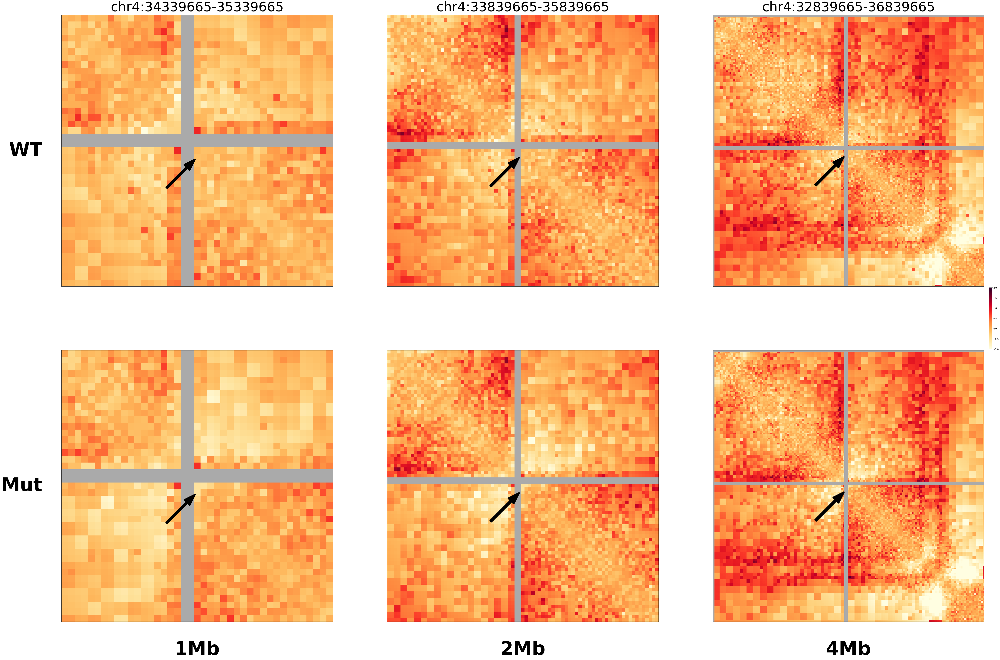

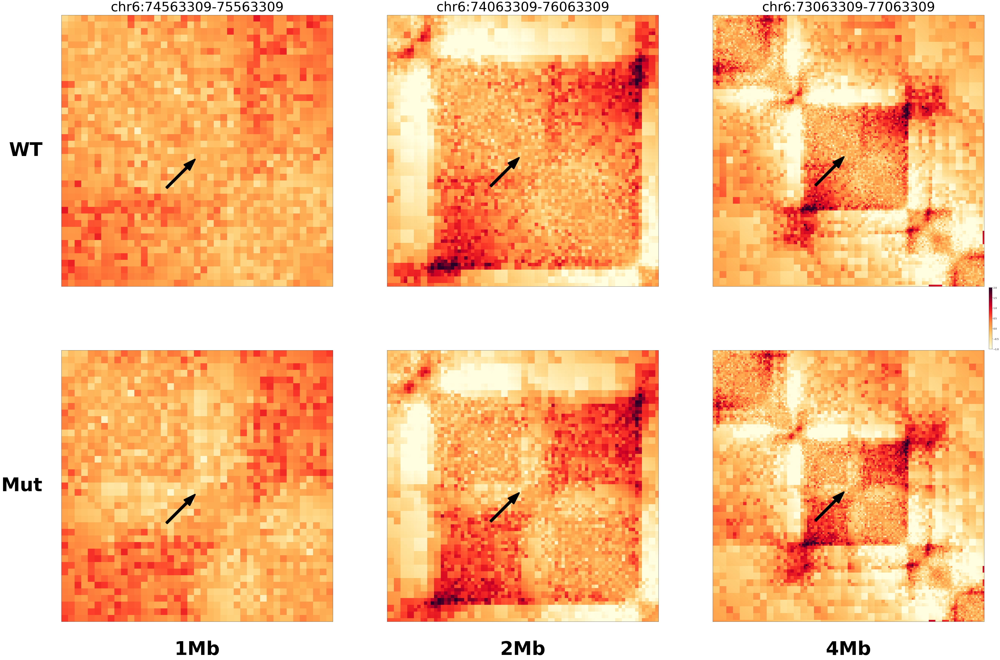

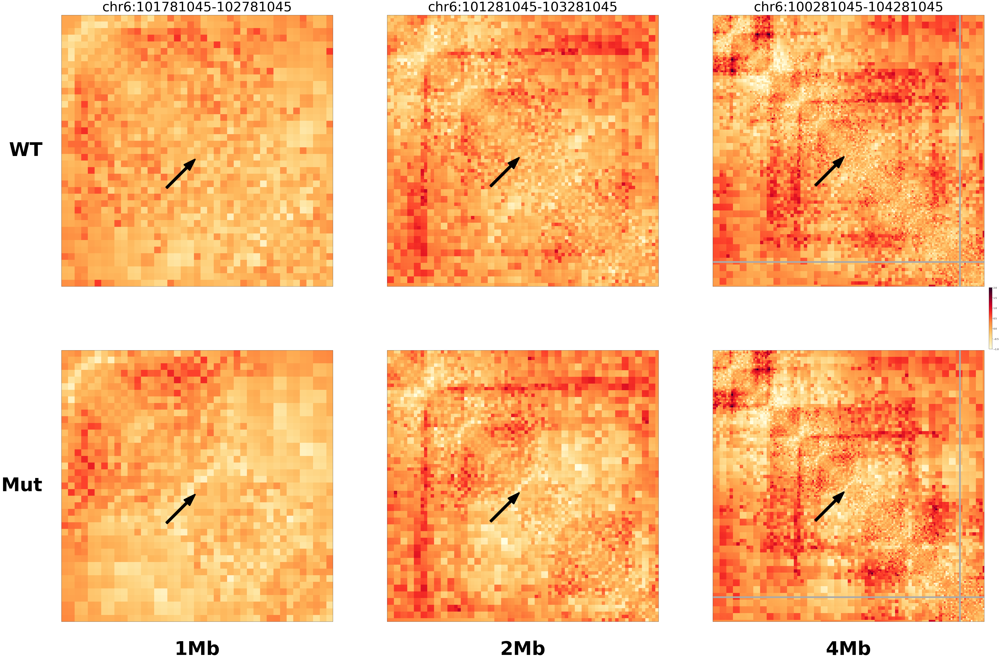

...

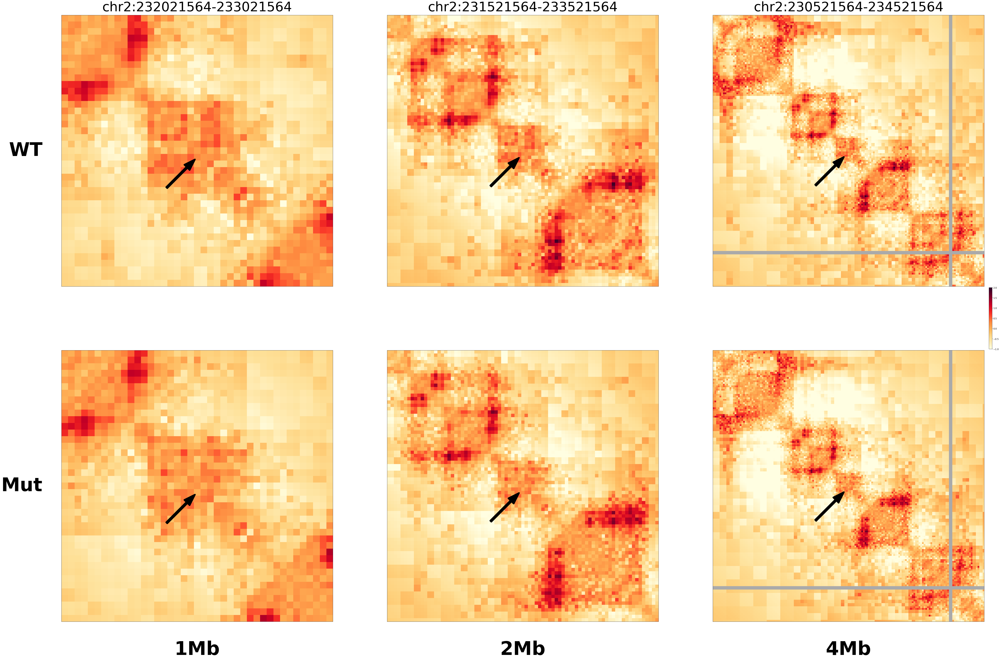

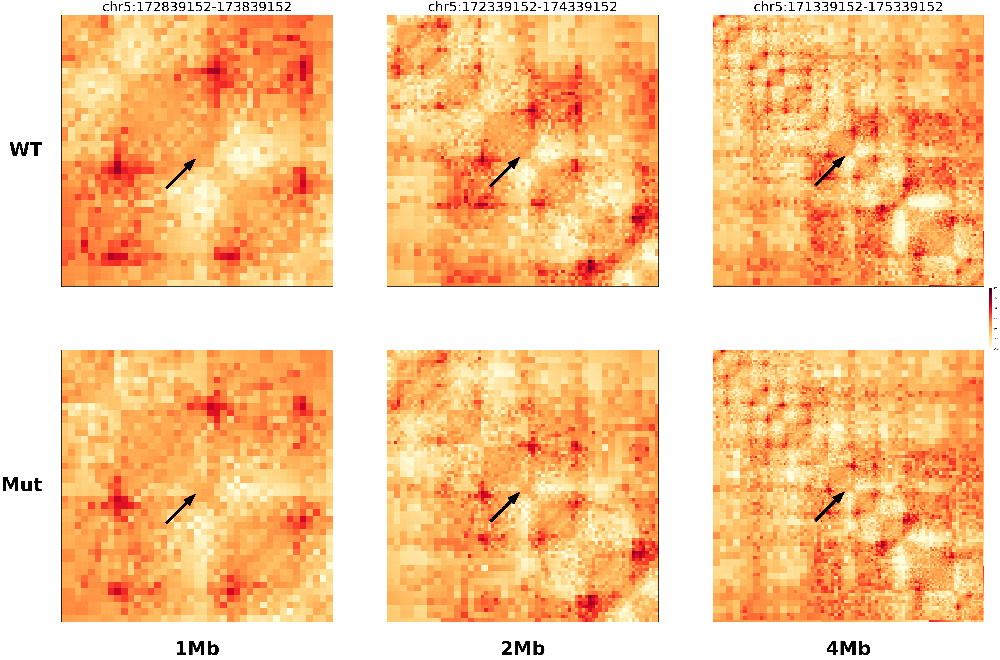

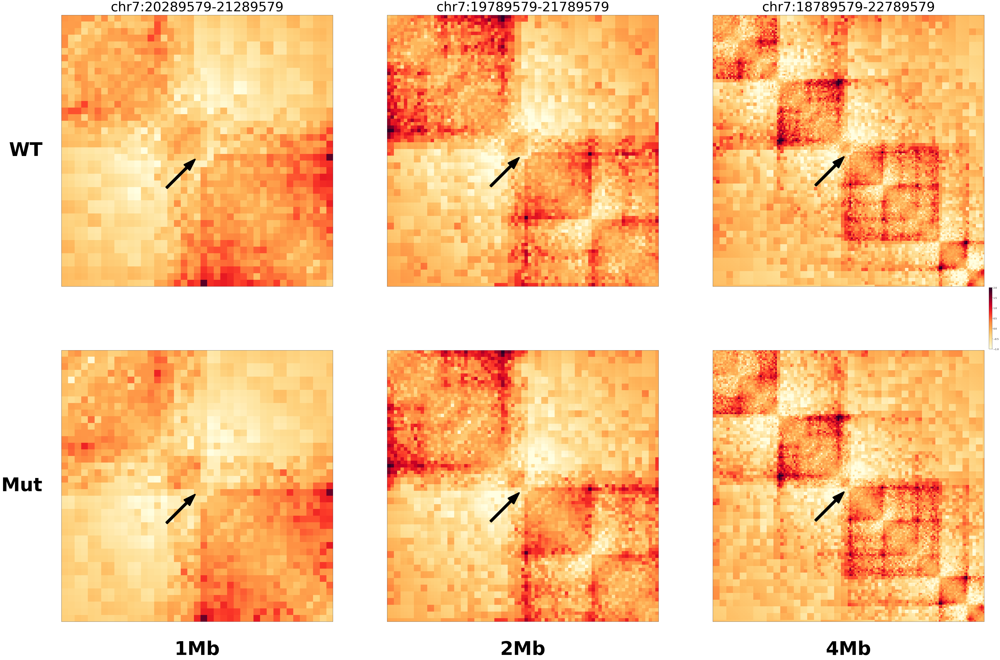

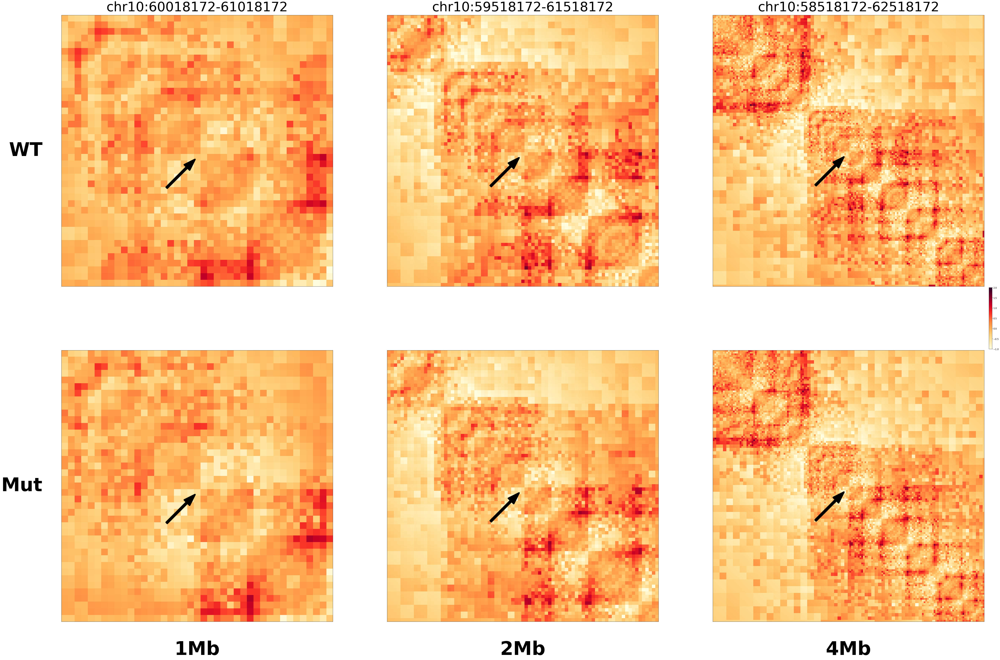

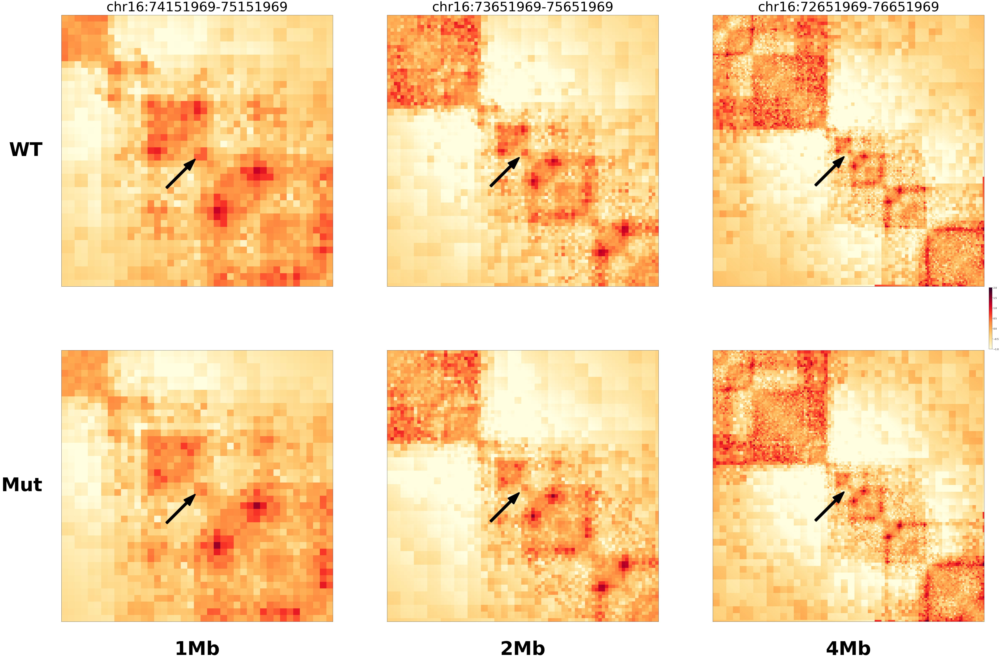

In [12]:
#plotting experimental measurement at 1Mb, 2Mb, 4Mb scales
from matplotlib import pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from colormaps import *

for i in range(10):
    fig, all_axes=plt.subplots(figsize=(90,30*2),nrows=2, ncols=3)

    for row_axes in all_axes:
        for ax in row_axes:
            ax.get_xaxis().set_ticks([])
            ax.get_yaxis().set_ticks([])


    for regionlen, ax in zip([ 1000000, 2000000, 4000000],all_axes[0]):
        start = sites[1][i]-int(regionlen/2)
        end = sites[1][i]+int(regionlen/2)
        if start <0:
            start = 0
            end = regionlen
        regionstr = sites[0][i] + ":" + str(start) + "-" + str(end)
        ax.set_title(regionstr, fontsize=70, pad=20)
        plotmat1 = target_wt.get_feature_data(sites[0][i].replace('chr',''),start, end+50000)[:-2,:-2]
        im = ax.imshow(np.log((plotmat1+1*np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))/
                  (normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]+np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))),
           cmap=hnh_cmap_ext5, vmin=-1,vmax=2)
        
        matlen = plotmat1.shape[0]
        ax.annotate('', fontsize=20, xy=(matlen/2-matlen/50, matlen/2+matlen/50),
                xycoords='data', xytext=(-150, -150),
                textcoords='offset points',
                arrowprops=dict(width=8, headwidth = 40.,headlength=60,
                                linewidth = 8,color = 'black'))


    for regionlen, ax in zip([ 1000000, 2000000, 4000000], all_axes[1]):
        start = sites[1][i]-int(regionlen/2)
        end = sites[1][i]+int(regionlen/2)
        if start <0:
            start = 0
            end = regionlen
        plotmat2 = target_c21.get_feature_data(sites[0][i].replace('chr',''), start, end+50000)[:-2,:-2]
        im = ax.imshow(np.log((plotmat2+1*np.min(normmat_c21[:plotmat2.shape[0],:plotmat2.shape[0]]))/
                          (normmat_c21[:plotmat2.shape[0],:plotmat2.shape[0]]+np.min(normmat_c21[:plotmat2.shape[0],:plotmat2.shape[0]]))),
                   cmap=hnh_cmap_ext5, vmin=-1,vmax=2)
        
        matlen = plotmat2.shape[0]
        ax.annotate('', fontsize=20, xy=(matlen/2-matlen/50, matlen/2+matlen/50),
                xycoords='data', xytext=(-150, -150),
                textcoords='offset points',
                arrowprops=dict(width=8, headwidth = 40.,headlength=60,
                                linewidth = 8,color = 'black'))
        
    for ii, xlabel in enumerate(["1Mb", "2Mb", "4Mb"]):
            all_axes[-1, ii].set_xlabel(xlabel, labelpad=100, fontsize=100, weight="black")
            
    for ii, label in enumerate(['WT','Mut']):
        all_axes[ii, 0].set_ylabel(
            label,
            labelpad=100,
            fontsize=100,
            weight="black",
            rotation="horizontal",
            ha="right",
            va="center",
        )
                
    fig.colorbar(im, ax=all_axes.ravel().tolist(),fraction=0.02, shrink = 0.1, pad=0.005)
    file = './svs_ins/psa-mcs-2kb_gb_Supplementary.gb.sites.'+sites[3][i]+'.exp.pdf'
    with PdfPages(file) as pdf:
        pdf.savefig(fig)
        
        

for i in range(10, 16):
    fig, all_axes=plt.subplots(figsize=(90,30*2),nrows=2, ncols=3)

    for row_axes in all_axes:
        for ax in row_axes:
            ax.get_xaxis().set_ticks([])
            ax.get_yaxis().set_ticks([])


    for regionlen, ax in zip([ 1000000, 2000000, 4000000],all_axes[0]):
        start = sites[1][i]-int(regionlen/2)
        end = sites[1][i]+int(regionlen/2)
        if start <0:
            start = 0
            end = regionlen
        
        regionstr = sites[0][i] + ":" + str(start) + "-" + str(end)
        ax.set_title(regionstr, fontsize=70, pad=20)
                
        plotmat1 = target_wt.get_feature_data(sites[0][i].replace('chr',''),start, end+50000)[:-2,:-2]
        im = ax.imshow(np.log((plotmat1+1*np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))/
                  (normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]+np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))),
           cmap=hnh_cmap_ext5, vmin=-1,vmax=2)
        
        matlen = plotmat1.shape[0]
        ax.annotate('', fontsize=20, xy=(matlen/2-matlen/50, matlen/2+matlen/50),
                xycoords='data', xytext=(-150, -150),
                textcoords='offset points',
                arrowprops=dict(width=8, headwidth = 40.,headlength=60,
                                linewidth = 8,color = 'black'))


    for regionlen, ax in zip([ 1000000, 2000000, 4000000], all_axes[1]):
        start = sites[1][i]-int(regionlen/2)
        end = sites[1][i]+int(regionlen/2)
        if start <0:
            start = 0
            end = regionlen
        plotmat2 = target_c25.get_feature_data(sites[0][i].replace('chr',''), start, end+50000)[:-2,:-2]
        im = ax.imshow(np.log((plotmat2+1*np.min(normmat_c25[:plotmat2.shape[0],:plotmat2.shape[0]]))/
                          (normmat_c25[:plotmat2.shape[0],:plotmat2.shape[0]]+np.min(normmat_c25[:plotmat2.shape[0],:plotmat2.shape[0]]))),
                   cmap=hnh_cmap_ext5, vmin=-1,vmax=2)
        
        matlen = plotmat2.shape[0]
        ax.annotate('', fontsize=20, xy=(matlen/2-matlen/50, matlen/2+matlen/50),
                xycoords='data', xytext=(-150, -150),
                textcoords='offset points',
                arrowprops=dict(width=8, headwidth = 40.,headlength=60,
                                linewidth = 8,color = 'black'))
    for ii, xlabel in enumerate(["1Mb", "2Mb", "4Mb"]):
            all_axes[-1, ii].set_xlabel(xlabel, labelpad=100, fontsize=100, weight="black")
            
    for ii, label in enumerate(['WT','Mut']):
        all_axes[ii, 0].set_ylabel(
            label,
            labelpad=100,
            fontsize=100,
            weight="black",
            rotation="horizontal",
            ha="right",
            va="center",
        )
                
    fig.colorbar(im, ax=all_axes.ravel().tolist(),fraction=0.02, shrink = 0.1, pad=0.005)
    file = './svs_ins/psa-mcs-2kb_gb_Supplementary.gb.sites.'+sites[3][i]+'.exp.pdf'
    with PdfPages(file) as pdf:
        pdf.savefig(fig)

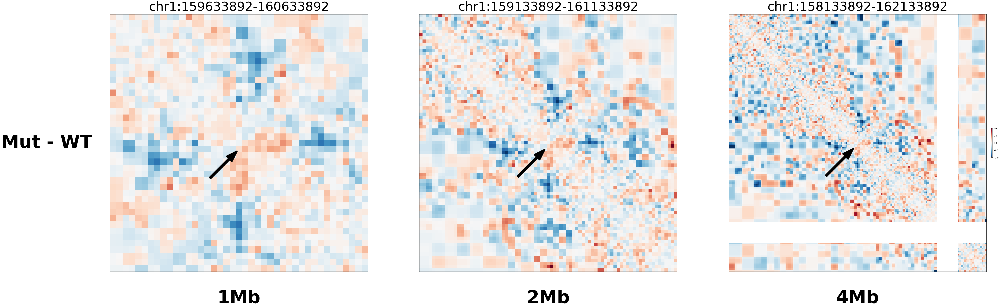

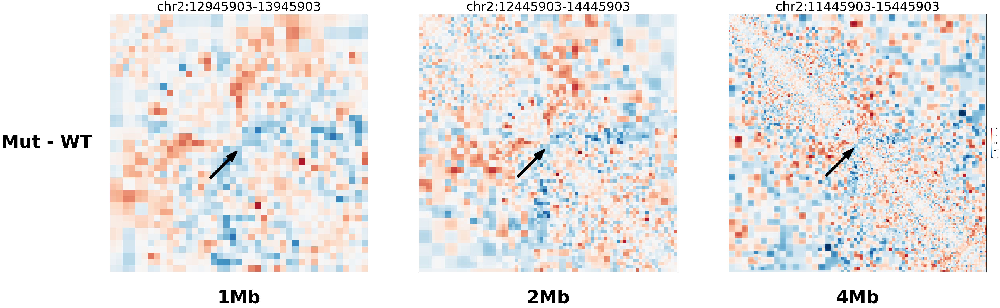

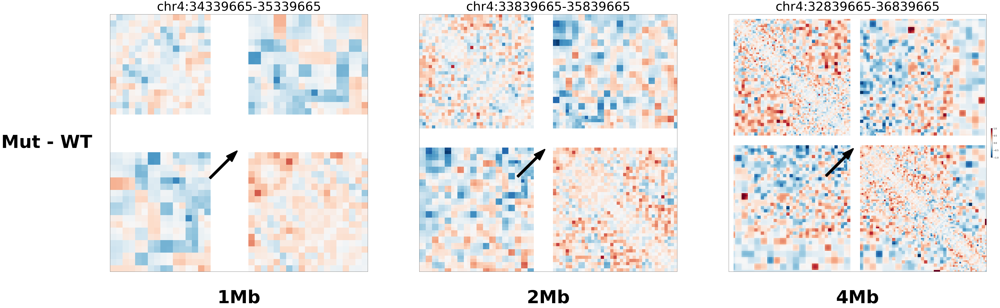

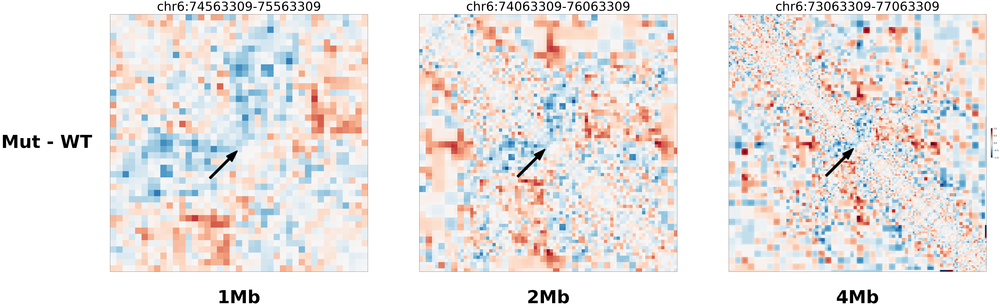

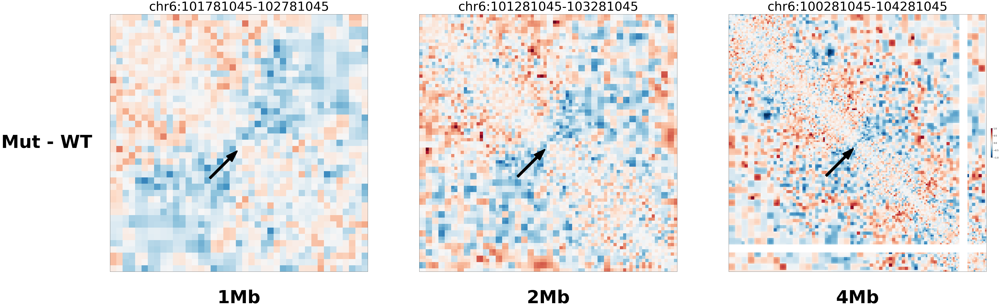

...

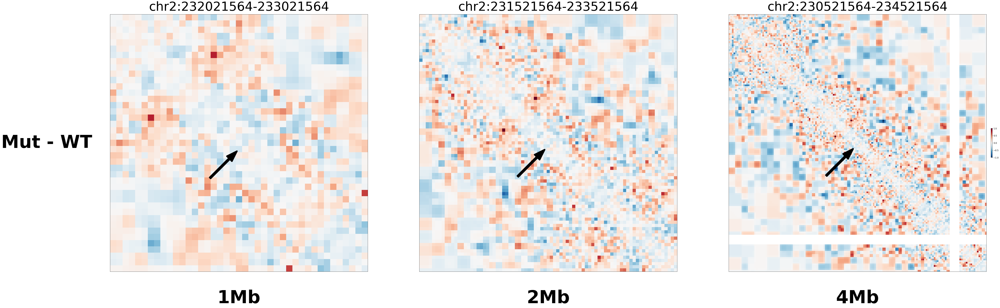

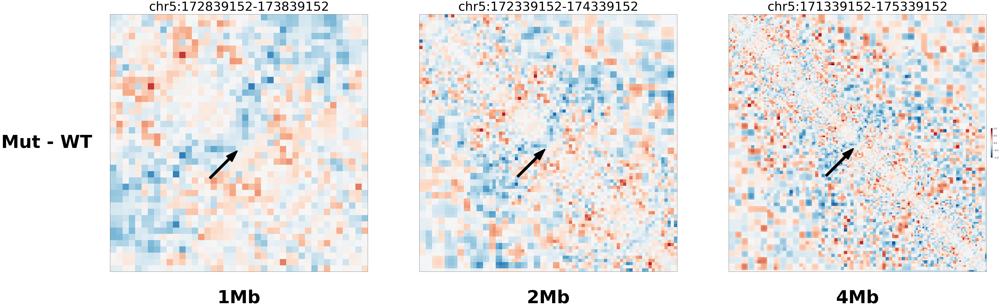

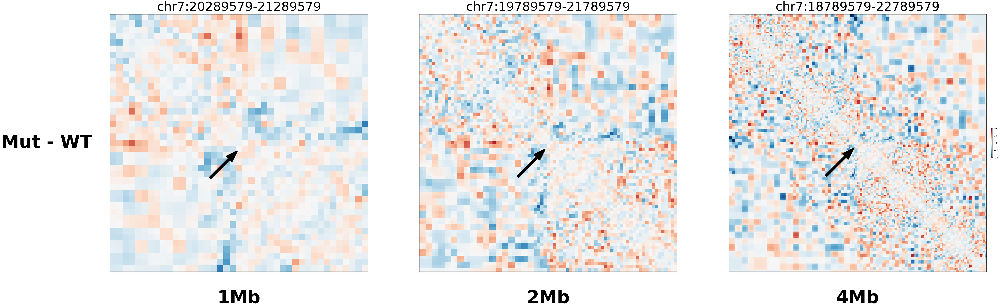

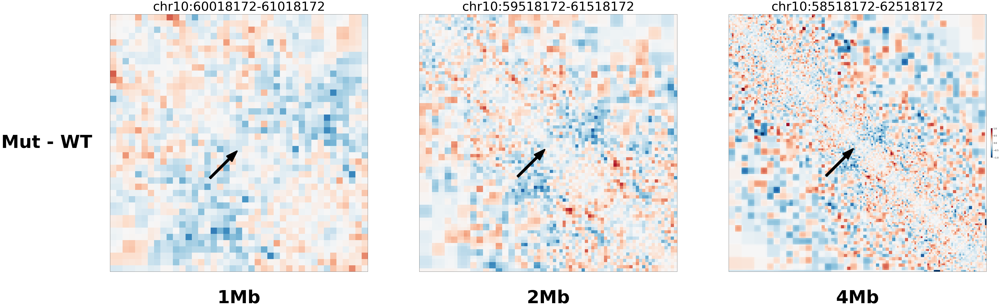

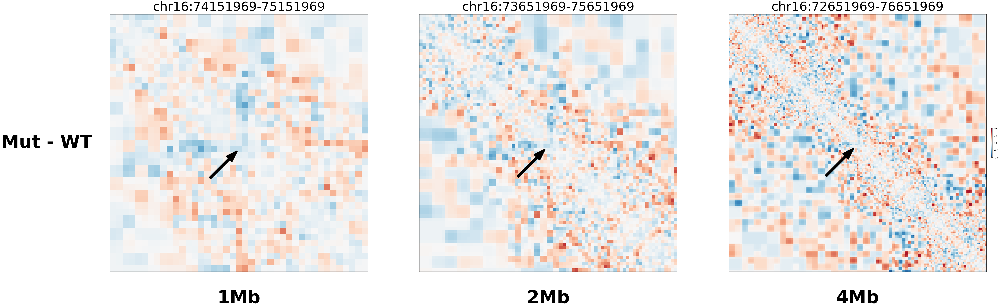

In [13]:
#plotting experimental measurement at 1Mb, 2Mb, 4Mb scales
from matplotlib import pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from colormaps import *

from scipy.ndimage import gaussian_filter
for i in range(10):
    fig, all_axes=plt.subplots(figsize=(90,30),nrows=1, ncols=3)

    for ax in all_axes:
            ax.get_xaxis().set_ticks([])
            ax.get_yaxis().set_ticks([])


    for regionlen, ax in zip([ 1000000, 2000000, 4000000],all_axes):
        start = sites[1][i]-int(regionlen/2)
        end = sites[1][i]+int(regionlen/2)
        if start <0:
            start = 0
            end = regionlen
        regionstr = sites[0][i] + ":" + str(start) + "-" + str(end)
        ax.set_title(regionstr, fontsize=70, pad=20)
        
        plotmat1 = target_wt.get_feature_data(sites[0][i].replace('chr',''),start, end+50000)[:-2,:-2]
        plotmat2 = target_c21.get_feature_data(sites[0][i].replace('chr',''), start, end+50000)[:-2,:-2]

        im = ax.imshow(gaussian_filter(-np.log((plotmat1+1*np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))/
                  (normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]+np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))) + \
                       np.log((plotmat2+1*np.min(normmat_c21[:plotmat2.shape[0],:plotmat2.shape[0]]))/
                          (normmat_c21[:plotmat2.shape[0],:plotmat2.shape[0]]+np.min(normmat_c21[:plotmat2.shape[0],:plotmat2.shape[0]]))), 0.5),
           cmap='RdBu_r', vmin=-1,vmax=1)
        
        matlen = plotmat1.shape[0]
        ax.annotate('', fontsize=20, xy=(matlen/2-matlen/50, matlen/2+matlen/50),
                xycoords='data', xytext=(-150, -150),
                textcoords='offset points',
                arrowprops=dict(width=8, headwidth = 40.,headlength=60,
                                linewidth = 8,color = 'black'))
        
    for ii, xlabel in enumerate(["1Mb", "2Mb", "4Mb"]):
            all_axes[ii].set_xlabel(xlabel, labelpad=100, fontsize=100, weight="black")
            
    all_axes[0].set_ylabel(
        'Mut - WT',
        labelpad=100,
        fontsize=100,
        weight="black",
        rotation="horizontal",
        ha="right",
        va="center",
    ) 

    fig.colorbar(im, ax=all_axes.ravel().tolist(),fraction=0.02, shrink = 0.1, pad=0.005)
    file = './svs_ins/psa-mcs-2kb_gb_Supplementary.gb.sites.'+sites[3][i]+'.exp.diff.pdf'
    with PdfPages(file) as pdf:
        pdf.savefig(fig)
        
        

for i in range(10, 16):
    fig, all_axes=plt.subplots(figsize=(90,30),nrows=1, ncols=3)

    for ax in all_axes:
            ax.get_xaxis().set_ticks([])
            ax.get_yaxis().set_ticks([])


    for regionlen, ax in zip([ 1000000, 2000000, 4000000],all_axes):
        start = sites[1][i]-int(regionlen/2)
        end = sites[1][i]+int(regionlen/2)
        if start <0:
            start = 0
            end = regionlen
        regionstr = sites[0][i] + ":" + str(start) + "-" + str(end)
        ax.set_title(regionstr, fontsize=70, pad=20)
        
        plotmat1 = target_wt.get_feature_data(sites[0][i].replace('chr',''),start, end+50000)[:-2,:-2]
        plotmat2 = target_c25.get_feature_data(sites[0][i].replace('chr',''), start, end+50000)[:-2,:-2]
        im = ax.imshow(gaussian_filter(- np.log((plotmat1+1*np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))/
                  (normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]+np.min(normmat_wt[:plotmat1.shape[0],:plotmat1.shape[0]]))) + \
                       np.log((plotmat2+1*np.min(normmat_c25[:plotmat2.shape[0],:plotmat2.shape[0]]))/
                          (normmat_c25[:plotmat2.shape[0],:plotmat2.shape[0]]+np.min(normmat_c25[:plotmat2.shape[0],:plotmat2.shape[0]]))), 0.5),
           cmap='RdBu_r', vmin=-1,vmax=1)
        
        matlen = plotmat1.shape[0]
        ax.annotate('', fontsize=20, xy=(matlen/2-matlen/50, matlen/2+matlen/50),
                xycoords='data', xytext=(-150, -150),
                textcoords='offset points',
                arrowprops=dict(width=8, headwidth = 40.,headlength=60,
                                linewidth = 8,color = 'black'))

    for ii, xlabel in enumerate(["1Mb", "2Mb", "4Mb"]):
            all_axes[ii].set_xlabel(xlabel, labelpad=100, fontsize=100, weight="black")
            
    all_axes[0].set_ylabel(
        'Mut - WT',
        labelpad=100,
        fontsize=100,
        weight="black",
        rotation="horizontal",
        ha="right",
        va="center",
    )
               
    fig.colorbar(im, ax=all_axes.ravel().tolist(),fraction=0.02, shrink = 0.1, pad=0.005)
    file = './svs_ins/psa-mcs-2kb_gb_Supplementary.gb.sites.'+sites[3][i]+'.exp.diff.pdf'
    with PdfPages(file) as pdf:
        pdf.savefig(fig)

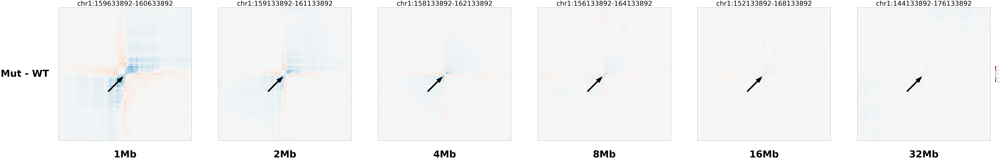

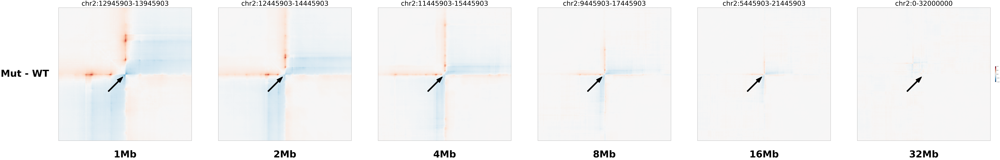

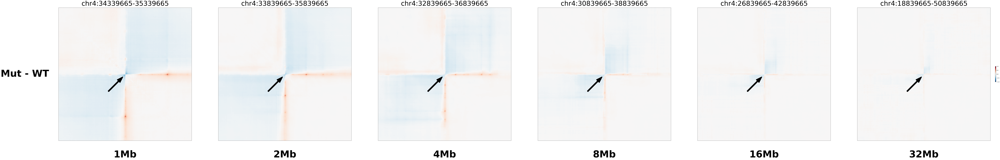

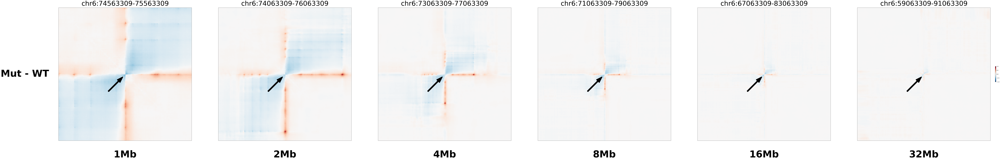

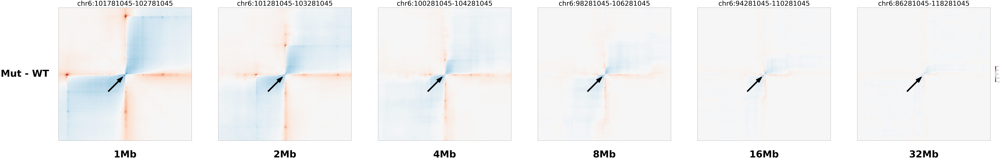

...

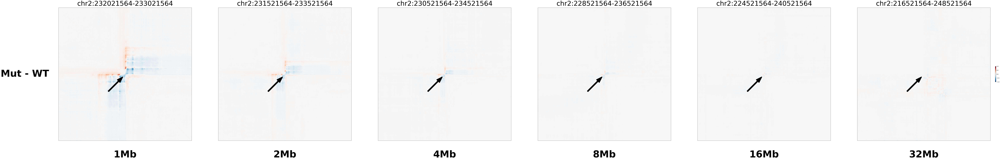

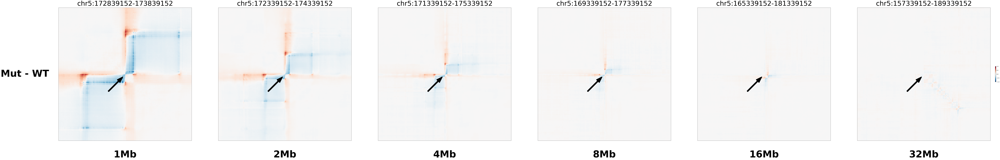

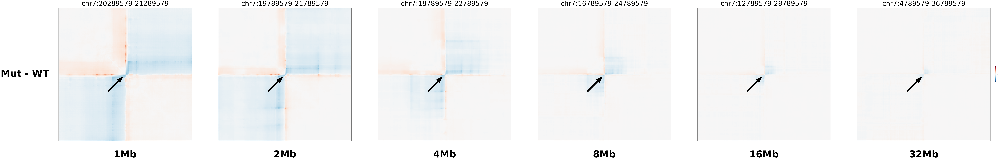

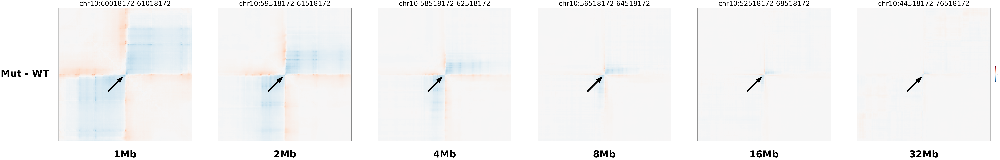

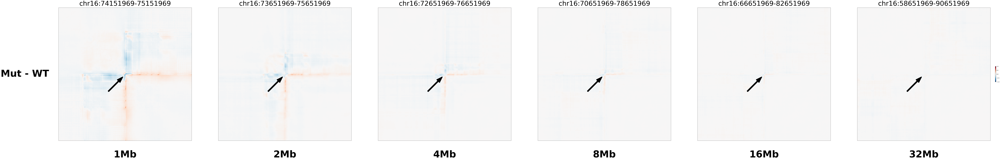

In [14]:
#plotting experimental measurement at 1Mb, 2Mb, 4Mb scales
from matplotlib import pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from colormaps import *

from scipy.ndimage import gaussian_filter
for i in range(10):
    fig, all_axes=plt.subplots(figsize=(30*6,30),nrows=1, ncols=6)
    for ax in all_axes:
            ax.get_xaxis().set_ticks([])
            ax.get_yaxis().set_ticks([])

    iii=5
    for regionlen, ax in zip([ 1000000, 2000000, 4000000, 8000000, 16000000, 32000000], all_axes):
        start = sites[1][i]-int(regionlen/2)
        end = sites[1][i]+int(regionlen/2)
        if start <0:
            start = 0
            end = regionlen
        regionstr = sites[0][i] + ":" + str(start) + "-" + str(end)
        ax.set_title(regionstr, fontsize=70, pad=20)
        
        diffmat_left = all_outputs_alt_l[i]['predictions'][0][iii] - all_outputs_ref[i]['predictions'][0][iii]
        diffmat_right = all_outputs_alt_r[i]['predictions'][0][iii] - all_outputs_ref[i]['predictions'][0][iii]
        iii=iii-1
        diffmat = np.zeros( (250,250))
        countmat = np.zeros( (250,250))
        diffmat[:125,:]+=diffmat_left[:125,:]
        countmat[:125,:]+=1
        diffmat[:,:125]+=diffmat_left[:,:125]
        countmat[:,:125]+=1
        diffmat[-125:,:]+=diffmat_right[-125:,:]
        countmat[-125:,:]+=1
        diffmat[:,-125:]+=diffmat_right[:,-125:]
        countmat[:,-125:]+=1
        diffmat /= countmat

        im = ax.imshow(diffmat,
           cmap='RdBu_r', vmin=-1,vmax=1)
        
        
        matlen =250
        ax.annotate('', fontsize=20, xy=(matlen/2-matlen/50, matlen/2+matlen/50),
                xycoords='data', xytext=(-150, -150),
                textcoords='offset points',
                arrowprops=dict(width=8, headwidth = 40.,headlength=60,
                                linewidth = 8,color = 'black'))
        
    for ii, xlabel in enumerate(["1Mb", "2Mb", "4Mb", "8Mb", "16Mb", "32Mb"]):
            all_axes[ii].set_xlabel(xlabel, labelpad=100, fontsize=100, weight="black")
            
    all_axes[0].set_ylabel(
        'Mut - WT',
        labelpad=100,
        fontsize=100,
        weight="black",
        rotation="horizontal",
        ha="right",
        va="center",
    )
    fig.colorbar(im, ax=all_axes.ravel().tolist(),fraction=0.02, shrink = 0.1, pad=0.005)
    file = './svs_ins/psa-mcs-2kb_gb_Supplementary.gb.sites.'+sites[3][i]+'.diff.pdf'
    with PdfPages(file) as pdf:
        pdf.savefig(fig)
        
        

for i in range(10, 16):
    fig, all_axes=plt.subplots(figsize=(30*6,30),nrows=1, ncols=6)
    for ax in all_axes:
            ax.get_xaxis().set_ticks([])
            ax.get_yaxis().set_ticks([])

    iii=5
    for regionlen, ax in zip([ 1000000, 2000000, 4000000, 8000000, 16000000, 32000000], all_axes):
        start = sites[1][i]-int(regionlen/2)
        end = sites[1][i]+int(regionlen/2)
        if start <0:
            start = 0
            end = regionlen
        regionstr = sites[0][i] + ":" + str(start) + "-" + str(end)
        ax.set_title(regionstr, fontsize=70, pad=20)
            
        diffmat_left = all_outputs_alt_l[i]['predictions'][0][iii] - all_outputs_ref[i]['predictions'][0][iii]
        diffmat_right = all_outputs_alt_r[i]['predictions'][0][iii] - all_outputs_ref[i]['predictions'][0][iii]
        iii = iii - 1
        diffmat = np.zeros( (250,250))
        countmat = np.zeros( (250,250))
        diffmat[:125,:]+=diffmat_left[:125,:]
        countmat[:125,:]+=1
        diffmat[:,:125]+=diffmat_left[:,:125]
        countmat[:,:125]+=1
        diffmat[-125:,:]+=diffmat_right[-125:,:]
        countmat[-125:,:]+=1
        diffmat[:,-125:]+=diffmat_right[:,-125:]
        countmat[:,-125:]+=1
        diffmat /= countmat
        
        im = ax.imshow(diffmat,
           cmap='RdBu_r', vmin=-1,vmax=1)
        
        matlen = 250
        ax.annotate('', fontsize=20, xy=(matlen/2-matlen/50, matlen/2+matlen/50),
                xycoords='data', xytext=(-150, -150),
                textcoords='offset points',
                arrowprops=dict(width=8, headwidth = 40.,headlength=60,
                                linewidth = 8,color = 'black'))
        
    for ii, xlabel in enumerate(["1Mb", "2Mb", "4Mb", "8Mb", "16Mb", "32Mb"]):
            all_axes[ii].set_xlabel(xlabel, labelpad=100, fontsize=100, weight="black")
            
    all_axes[0].set_ylabel(
        'Mut - WT',
        labelpad=100,
        fontsize=100,
        weight="black",
        rotation="horizontal",
        ha="right",
        va="center",
    )
    fig.colorbar(im, ax=all_axes.ravel().tolist(),fraction=0.02, shrink = 0.1, pad=0.005)
    file = './svs_ins/psa-mcs-2kb_gb_Supplementary.gb.sites.'+sites[3][i]+'.diff.pdf'
    with PdfPages(file) as pdf:
        pdf.savefig(fig)

In [15]:
score_refs_h1esc = []
score_alts_h1esc = []
window = 50

for i in range(16):
    score_ref = all_outputs_ref[i]['predictions'][0][5][125-window:125,125:125+window].mean() - (0.5*all_outputs_ref[i]['predictions'][0][5][125-window:125,125-window:125].mean()+0.5*all_outputs_ref[i]['predictions'][0][5][125:125+window,125:125+window].mean())
    score_alt_l = all_outputs_alt_l[i]['predictions'][0][5][125-window:125,125:125+window].mean() - (0.5*all_outputs_alt_l[i]['predictions'][0][5][125-window:125,125-window:125].mean()+0.5*all_outputs_alt_l[i]['predictions'][0][5][125:125+window,125:125+window].mean())
    score_alt_r = all_outputs_alt_r[i]['predictions'][0][5][125-window:125,125:125+window].mean() - (0.5*all_outputs_alt_r[i]['predictions'][0][5][125-window:125,125-window:125].mean()+0.5*all_outputs_alt_r[i]['predictions'][0][5][125:125+window,125:125+window].mean())
    score_refs_h1esc.append(score_ref)
    score_alts_h1esc.append(0.5*score_alt_l+0.5*score_alt_r)

score_refs_hff = []
score_alts_hff = []
window = 50

for i in range(16):
    score_ref = all_outputs_ref[i]['predictions'][1][5][125-window:125,125:125+window].mean() - (0.5*all_outputs_ref[i]['predictions'][1][5][125-window:125,125-window:125].mean()+0.5*all_outputs_ref[i]['predictions'][1][5][125:125+window,125:125+window].mean())
    score_alt_l = all_outputs_alt_l[i]['predictions'][1][5][125-window:125,125:125+window].mean() - (0.5*all_outputs_alt_l[i]['predictions'][1][5][125-window:125,125-window:125].mean()+0.5*all_outputs_alt_l[i]['predictions'][1][5][125:125+window,125:125+window].mean())
    score_alt_r = all_outputs_alt_r[i]['predictions'][1][5][125-window:125,125:125+window].mean() - (0.5*all_outputs_alt_r[i]['predictions'][1][5][125-window:125,125-window:125].mean()+0.5*all_outputs_alt_r[i]['predictions'][1][5][125:125+window,125:125+window].mean())
    score_refs_hff.append(score_ref)
    score_alts_hff.append(0.5*score_alt_l+0.5*score_alt_r)

In [16]:
score_ref_targets = []
score_alt_targets = []
window2 = 8
for i in range(16):
    score_ref = np.nanmean(all_ref_targets[i][20-window2:20,20:20+window2]) - (0.5*np.nanmean(all_ref_targets[i][20-window2:20,20-window2:20]) + 0.5 * np.nanmean(all_ref_targets[i][20:20+window2,20:20+window2]))
    score_alt = np.nanmean(all_alt_targets[i][20-window2:20,20:20+window2])- (0.5*np.nanmean(all_alt_targets[i][20-window2:20,20-window2:20]) + 0.5 * np.nanmean(all_alt_targets[i][20:20+window2,20:20+window2]))
    score_ref_targets.append(score_ref)
    score_alt_targets.append(score_alt)

In [17]:
#excluding C21S8 and C21S9 because of missing values
diffs_h1esc = [] 
for i in list(range(7))+list(range(9,16)):
    diffs_h1esc.append(score_refs_h1esc[i] - score_alts_h1esc[i])

diffs_hff = [] 
for i in list(range(7))+list(range(9,16)):
    diffs_hff.append(score_refs_hff[i] - score_alts_hff[i])
    
diffs_target = []
for i in list(range(7))+list(range(9,16)):
    diffs_target.append(score_ref_targets[i] - score_alt_targets[i])

In [18]:
cos_similarity_h1esc = np.sum(np.array(diffs_h1esc) * np.array(diffs_target))/(np.linalg.norm(np.array(diffs_h1esc)) * np.linalg.norm(np.array(diffs_target)))
cos_similarity_hff = np.sum(np.array(diffs_hff) * np.array(diffs_target))/(np.linalg.norm(np.array(diffs_hff)) * np.linalg.norm(np.array(diffs_target)))

In [19]:
%load_ext rpy2.ipython

In [20]:
labels = sites.iloc[list(range(7))+list(range(9,16)),3]

In [21]:
%%R -i diffs_h1esc,diffs_hff,diffs_target,labels -w 12 -h 6 --units in -r 300
require(data.table)
require(ggplot2)
require(patchwork)
theme_Publication <- function(base_size=14) {
      library(grid)
      library(ggthemes)
      (theme_foundation(base_size=base_size)
       + theme(plot.title = element_text(face = "bold",
                                         size = rel(1.2), hjust = 0.5),
               text = element_text(),
               panel.background = element_rect(colour = NA),
               plot.background = element_rect(colour = NA),
               panel.border = element_rect(colour = NA),
               axis.title = element_text(face = "bold",size = rel(1)),
               axis.title.y = element_text(angle=90,vjust =2),
               axis.title.x = element_text(vjust = -0.2),
               axis.text = element_text(), 
               axis.line = element_line(colour="black"),
               axis.ticks = element_line(),
               panel.grid.major = element_blank(),
               panel.grid.minor = element_blank(),
               legend.key = element_rect(colour = NA),
               legend.position = "bottom",
               legend.direction = "horizontal",
               legend.key.size= unit(0.2, "cm"),
               legend.margin = unit(0, "cm"),
               legend.title = element_text(face="italic"),
               plot.margin=unit(c(10,5,5,5),"mm"),
               strip.background=element_rect(colour="#f0f0f0",fill="#f0f0f0"),
               strip.text = element_text(face="bold")
          ))
      
}

plotdata = rbind(data.table(pred=as.numeric(diffs_h1esc),data=as.numeric(diffs_target), label=labels, model='H1-ESC'),
                 data.table(pred=as.numeric(diffs_hff),data=as.numeric(diffs_target), label=labels, model='HFF'))
p1=ggplot(plotdata[model=='H1-ESC'])+geom_point(aes(x=pred, y=data, color=model))+coord_cartesian(xlim=c(-0.3, 0.3), ylim=c(-0.3, 0.3))+
    geom_vline(xintercept=0, linetype=2)+geom_hline(yintercept=0, linetype=2)+theme_Publication()+
    geom_text(aes(x=pred+0.03, y=data+0.01,label=label))+
    xlab('Predicted insulation score')+ylab('Experimental insulation score')
p2=ggplot(plotdata[model=='HFF'])+geom_point(aes(x=pred, y=data, color=model))+coord_cartesian(xlim=c(-0.3, 0.3), ylim=c(-0.3, 0.3))+
    geom_vline(xintercept=0, linetype=2)+geom_hline(yintercept=0, linetype=2)+theme_Publication()+
    geom_text(aes(x=pred+0.03, y=data+0.01,label=label))+
    xlab('Predicted insulation score')+ylab('Experimental insulation score')
p1+p2
ggsave('./figures/sv_insertions_insulation_scores.pdf',device=cairo_pdf)

In [22]:
print('Cosine similarity H1-ESC model: ', cos_similarity_h1esc)
print('Cosine similarity HFF model: ', cos_similarity_hff)

Cosine similarity H1-ESC model:  0.8854873739300064
Cosine similarity HFF model:  0.7612527358230167


In [23]:
nulls_h1esc = []
nulls_hff = []
for i in range(100000):
    randsign = 2*(np.random.randn(len(diffs_target))>0)-1
    randsign2 = 2*(np.random.randn(len(diffs_target))>0)-1
    nulls_h1esc.append(np.sum(np.array(diffs_h1esc)*randsign2 * np.array(diffs_target)*randsign)/(np.linalg.norm(np.array(diffs_h1esc)*randsign2) * np.linalg.norm(np.array(diffs_target)*randsign)))
    nulls_hff.append(np.sum(np.array(diffs_hff)*randsign2 * np.array(diffs_target)*randsign)/(np.linalg.norm(np.array(diffs_hff)*randsign2) * np.linalg.norm(np.array(diffs_target)*randsign)))

In [24]:
print('p-value H1-ESC model: ', np.mean(np.array(nulls_h1esc) > cos_similarity_h1esc))
print('p-value HFF model: ', np.mean(np.array(nulls_hff) > cos_similarity_hff))

p-value H1-ESC model:  0.0
p-value HFF model:  0.0
